<a href="https://colab.research.google.com/github/Ignas12345/DIPs/blob/master/ground_zero.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!git clone https://github.com/Nikronic/EdgeNet.git
!git clone https://github.com/Ignas12345/Project_in_Computational_Biology_take_2.git

Cloning into 'EdgeNet'...
remote: Enumerating objects: 127, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 127 (delta 2), reused 4 (delta 1), pack-reused 121
Receiving objects: 100% (127/127), 808.96 KiB | 6.04 MiB/s, done.
Resolving deltas: 100% (72/72), done.
Cloning into 'Project_in_Computational_Biology_take_2'...
remote: Enumerating objects: 147, done.
remote: Counting objects: 100% (147/147), done.
remote: Compressing objects: 100% (144/144), done.
remote: Total 147 (delta 46), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (147/147), 17.54 MiB | 19.57 MiB/s, done.
Resolving deltas: 100% (46/46), done.


Import libraries and choose your processor

In [2]:
from Project_in_Computational_Biology_take_2.code.skip import skip
from Project_in_Computational_Biology_take_2.code.downsampler import Downsampler
from Project_in_Computational_Biology_take_2.code.helpers import *
from Project_in_Computational_Biology_take_2.code.CV_methods import *
from EdgeNet.EdgeNet import EdgeNet

import os

In [3]:
os.makedirs('DIP_images')
os.makedirs('Files_to_download') #This folder will store images of the edge map(/-s)
os.makedirs('Images_with_edge_regularization')

In [4]:
#choose CPU or GPU

processor = 'GPU'

if processor == 'GPU':
  torch.backends.cudnn.enabled = True
  torch.backends.cudnn.benchmark =True
  dtype = torch.cuda.FloatTensor

if processor == 'CPU':
  dtype = torch.FloatTensor

set up the parameters

In [5]:
orig_img = Image.open('/content/Project_in_Computational_Biology_take_2/pictures/Vilnius/Vilnius.jpg')

In [6]:
num_input_channels = 1
num_output_channels = 1
upscaling_factor = 4
n_iterations = 4000

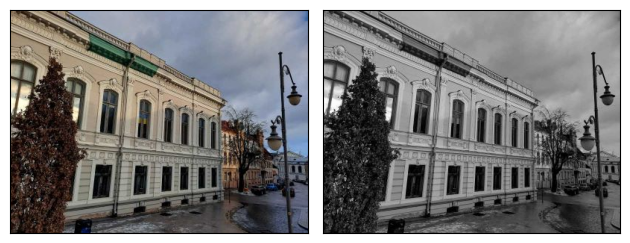

In [7]:
grayscale_img = turn_to_grayscale(orig_img)
plot([orig_img, grayscale_img], cmap = 'gray')

set up model and input

In [10]:
dip_model = skip(num_input_channels = num_input_channels, num_output_channels = num_output_channels, need_bias = True, upsample_mode = 'bilinear').type(dtype)

In [11]:
noise_img = generate_noise(grayscale_img, upscaling_factor = upscaling_factor)

#input_img = crop(turn_to_grayscale(input_img), LR_img.size)
target_img = grayscale_img

In [ ]:
# delete this if you want to start from random initialization
dip_model.load_state_dict(torch.load('/content/Project_in_Computational_Biology_take_2/model_parameters/DIP_model_parameters/DIP_model_parameters_spaghetti'))

define optimization loop and train

In [13]:
downsampler = Downsampler(n_planes = 1, factor = upscaling_factor, kernel_type= 'lanczos3', preserve_size=True).type(dtype)

iteration [0/4000], Loss: 0.10201354324817657


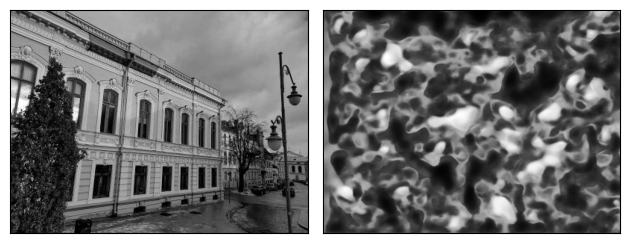

iteration [1/4000], Loss: 0.05324235185980797
iteration [2/4000], Loss: 0.0347946472465992
iteration [3/4000], Loss: 0.029263505712151527
iteration [4/4000], Loss: 0.02661103568971157
iteration [5/4000], Loss: 0.02417927235364914
iteration [6/4000], Loss: 0.022188425064086914
iteration [7/4000], Loss: 0.0206180140376091
iteration [8/4000], Loss: 0.01936160959303379
iteration [9/4000], Loss: 0.01844746805727482
iteration [10/4000], Loss: 0.0177043117582798
iteration [11/4000], Loss: 0.016952235251665115
iteration [12/4000], Loss: 0.016148677095770836
iteration [13/4000], Loss: 0.015341994352638721
iteration [14/4000], Loss: 0.014570596627891064
iteration [15/4000], Loss: 0.013959962874650955
iteration [16/4000], Loss: 0.013491093181073666
iteration [17/4000], Loss: 0.013042480684816837
iteration [18/4000], Loss: 0.01258204597979784
iteration [19/4000], Loss: 0.012153295800089836
iteration [20/4000], Loss: 0.011802229098975658
iteration [21/4000], Loss: 0.011492175050079823
iteration [22

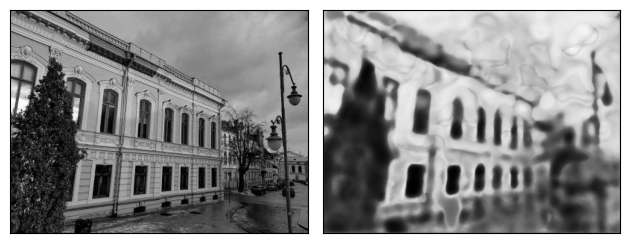

iteration [26/4000], Loss: 0.010112696327269077
iteration [27/4000], Loss: 0.009875763207674026
iteration [28/4000], Loss: 0.009658699855208397
iteration [29/4000], Loss: 0.00947792548686266
iteration [30/4000], Loss: 0.00930878147482872
iteration [31/4000], Loss: 0.009136690758168697
iteration [32/4000], Loss: 0.008982951752841473
iteration [33/4000], Loss: 0.00884176790714264
iteration [34/4000], Loss: 0.008708703331649303
iteration [35/4000], Loss: 0.008580806665122509
iteration [36/4000], Loss: 0.008454014547169209
iteration [37/4000], Loss: 0.008332558907568455
iteration [38/4000], Loss: 0.008219163864850998
iteration [39/4000], Loss: 0.00810135155916214
iteration [40/4000], Loss: 0.008022029884159565
iteration [41/4000], Loss: 0.008022738620638847
iteration [42/4000], Loss: 0.008087275549769402
iteration [43/4000], Loss: 0.00812832172960043
iteration [44/4000], Loss: 0.00795083586126566
iteration [45/4000], Loss: 0.007660396862775087
iteration [46/4000], Loss: 0.00770494388416409

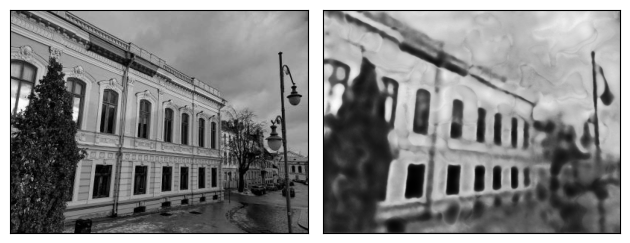

iteration [51/4000], Loss: 0.007195848505944014
iteration [52/4000], Loss: 0.007070379797369242
iteration [53/4000], Loss: 0.007051240652799606
iteration [54/4000], Loss: 0.00692314887419343
iteration [55/4000], Loss: 0.006837369874119759
iteration [56/4000], Loss: 0.006775790359824896
iteration [57/4000], Loss: 0.0067010740749537945
iteration [58/4000], Loss: 0.006614820100367069
iteration [59/4000], Loss: 0.006556099746376276
iteration [60/4000], Loss: 0.006470790598541498
iteration [61/4000], Loss: 0.006421747617423534
iteration [62/4000], Loss: 0.006398158147931099
iteration [63/4000], Loss: 0.006368211004883051
iteration [64/4000], Loss: 0.006336298305541277
iteration [65/4000], Loss: 0.006272689439356327
iteration [66/4000], Loss: 0.0061732991598546505
iteration [67/4000], Loss: 0.0060957325622439384
iteration [68/4000], Loss: 0.006025454495102167
iteration [69/4000], Loss: 0.005962343420833349
iteration [70/4000], Loss: 0.005965292453765869
iteration [71/4000], Loss: 0.005975267

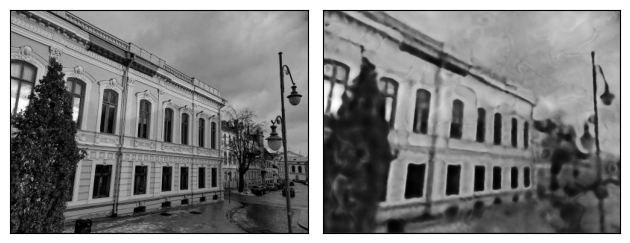

iteration [76/4000], Loss: 0.0069836340844631195
iteration [77/4000], Loss: 0.006466110236942768
iteration [78/4000], Loss: 0.006245230324566364
iteration [79/4000], Loss: 0.006354991812258959
iteration [80/4000], Loss: 0.005942899733781815
iteration [81/4000], Loss: 0.006202415097504854
iteration [82/4000], Loss: 0.005842846818268299
iteration [83/4000], Loss: 0.005941050127148628
iteration [84/4000], Loss: 0.005751926451921463
iteration [85/4000], Loss: 0.0057676732540130615
iteration [86/4000], Loss: 0.005620174575597048
iteration [87/4000], Loss: 0.005638867150992155
iteration [88/4000], Loss: 0.00550908874720335
iteration [89/4000], Loss: 0.0054995170794427395
iteration [90/4000], Loss: 0.005440501030534506
iteration [91/4000], Loss: 0.005379030480980873
iteration [92/4000], Loss: 0.005343171302229166
iteration [93/4000], Loss: 0.005283909849822521
iteration [94/4000], Loss: 0.0052520642057061195
iteration [95/4000], Loss: 0.005197524558752775
iteration [96/4000], Loss: 0.00516037

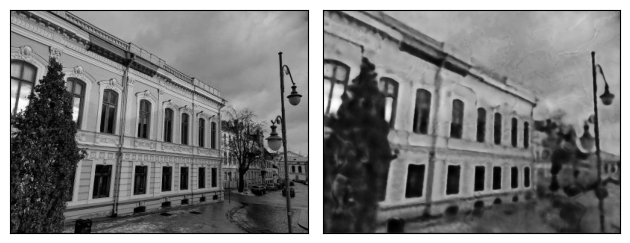

iteration [101/4000], Loss: 0.004970364738255739
iteration [102/4000], Loss: 0.0049321698024868965
iteration [103/4000], Loss: 0.004896854516118765
iteration [104/4000], Loss: 0.0048518432304263115
iteration [105/4000], Loss: 0.004828495904803276
iteration [106/4000], Loss: 0.004787852987647057
iteration [107/4000], Loss: 0.004760062787681818
iteration [108/4000], Loss: 0.004745957441627979
iteration [109/4000], Loss: 0.004728641360998154
iteration [110/4000], Loss: 0.0047815460711717606
iteration [111/4000], Loss: 0.005038350820541382
iteration [112/4000], Loss: 0.0055864183232188225
iteration [113/4000], Loss: 0.0058382293209433556
iteration [114/4000], Loss: 0.004979731515049934
iteration [115/4000], Loss: 0.005474404897540808
iteration [116/4000], Loss: 0.004939150996506214
iteration [117/4000], Loss: 0.005082464311271906
iteration [118/4000], Loss: 0.004851632285863161
iteration [119/4000], Loss: 0.004939425736665726
iteration [120/4000], Loss: 0.004746025428175926
iteration [121/

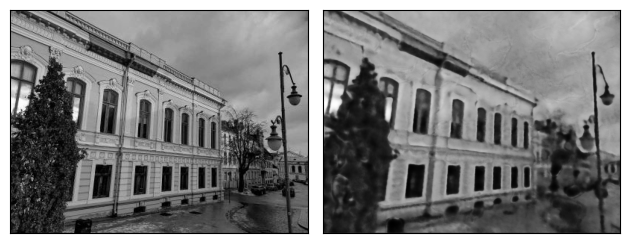

iteration [126/4000], Loss: 0.004506411496549845
iteration [127/4000], Loss: 0.004467292223125696
iteration [128/4000], Loss: 0.004423459060490131
iteration [129/4000], Loss: 0.004384347703307867
iteration [130/4000], Loss: 0.004368219058960676
iteration [131/4000], Loss: 0.0043249125592410564
iteration [132/4000], Loss: 0.004304907750338316
iteration [133/4000], Loss: 0.004239338915795088
iteration [134/4000], Loss: 0.004236164037138224
iteration [135/4000], Loss: 0.004187299869954586
iteration [136/4000], Loss: 0.00418593967333436
iteration [137/4000], Loss: 0.0041549173183739185
iteration [138/4000], Loss: 0.004151269793510437
iteration [139/4000], Loss: 0.004148063249886036
iteration [140/4000], Loss: 0.004183273762464523
iteration [141/4000], Loss: 0.004370793700218201
iteration [142/4000], Loss: 0.0046688262373209
iteration [143/4000], Loss: 0.004892007447779179
iteration [144/4000], Loss: 0.004318782594054937
iteration [145/4000], Loss: 0.004432491026818752
iteration [146/4000],

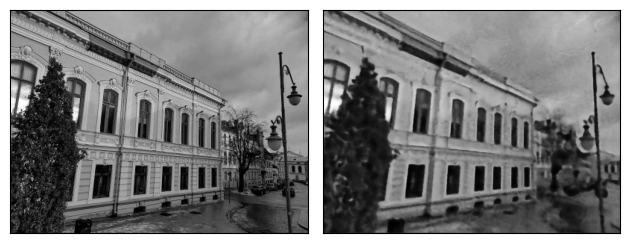

iteration [151/4000], Loss: 0.004223024006932974
iteration [152/4000], Loss: 0.003989941906183958
iteration [153/4000], Loss: 0.004043686669319868
iteration [154/4000], Loss: 0.00399083411321044
iteration [155/4000], Loss: 0.0039043081924319267
iteration [156/4000], Loss: 0.003958176355808973
iteration [157/4000], Loss: 0.003857232630252838
iteration [158/4000], Loss: 0.003846236504614353
iteration [159/4000], Loss: 0.0038492551539093256
iteration [160/4000], Loss: 0.0037485819775611162
iteration [161/4000], Loss: 0.0037922475021332502
iteration [162/4000], Loss: 0.0037270858883857727
iteration [163/4000], Loss: 0.0036883121356368065
iteration [164/4000], Loss: 0.003709569573402405
iteration [165/4000], Loss: 0.0036350535228848457
iteration [166/4000], Loss: 0.003632002742961049
iteration [167/4000], Loss: 0.0036127716302871704
iteration [168/4000], Loss: 0.0035876124165952206
iteration [169/4000], Loss: 0.0035582953132689
iteration [170/4000], Loss: 0.0035556619986891747
iteration [17

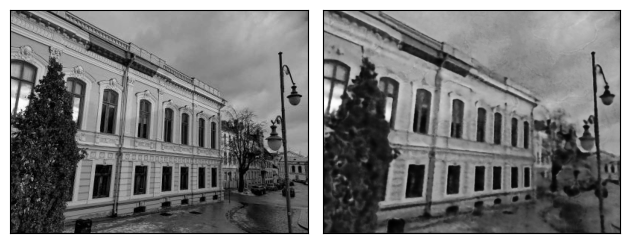

iteration [176/4000], Loss: 0.0037959220353513956
iteration [177/4000], Loss: 0.00395303126424551
iteration [178/4000], Loss: 0.0038883304223418236
iteration [179/4000], Loss: 0.0036068130284547806
iteration [180/4000], Loss: 0.003720872336998582
iteration [181/4000], Loss: 0.0035892322193831205
iteration [182/4000], Loss: 0.003579768817871809
iteration [183/4000], Loss: 0.0035667591728270054
iteration [184/4000], Loss: 0.0034627674613147974
iteration [185/4000], Loss: 0.003500084625557065
iteration [186/4000], Loss: 0.003423469141125679
iteration [187/4000], Loss: 0.003467380767688155
iteration [188/4000], Loss: 0.0033652980346232653
iteration [189/4000], Loss: 0.003370756981894374
iteration [190/4000], Loss: 0.003333409084007144
iteration [191/4000], Loss: 0.003300376469269395
iteration [192/4000], Loss: 0.0033324214164167643
iteration [193/4000], Loss: 0.003311089938506484
iteration [194/4000], Loss: 0.00337450229562819
iteration [195/4000], Loss: 0.0034411174710839987
iteration [19

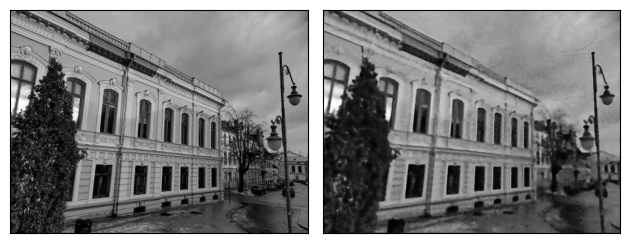

iteration [201/4000], Loss: 0.003467730712145567
iteration [202/4000], Loss: 0.0032593468204140663
iteration [203/4000], Loss: 0.003222385188564658
iteration [204/4000], Loss: 0.003374217776581645
iteration [205/4000], Loss: 0.00327811180613935
iteration [206/4000], Loss: 0.0031915789004415274
iteration [207/4000], Loss: 0.003205370157957077
iteration [208/4000], Loss: 0.0031837215647101402
iteration [209/4000], Loss: 0.0031127447728067636
iteration [210/4000], Loss: 0.0030976918060332537
iteration [211/4000], Loss: 0.003115918254479766
iteration [212/4000], Loss: 0.003062022151425481
iteration [213/4000], Loss: 0.003019885392859578
iteration [214/4000], Loss: 0.0030328831635415554
iteration [215/4000], Loss: 0.0030198474414646626
iteration [216/4000], Loss: 0.0030060934368520975
iteration [217/4000], Loss: 0.002980154473334551
iteration [218/4000], Loss: 0.002989324973896146
iteration [219/4000], Loss: 0.0030354077462106943
iteration [220/4000], Loss: 0.0031651861499994993
iteration [

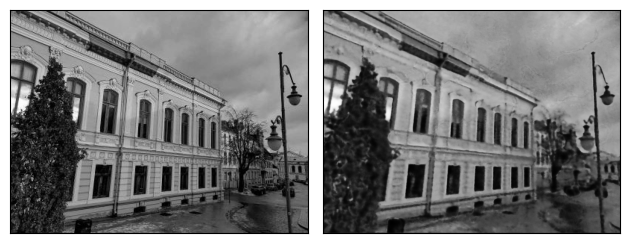

iteration [226/4000], Loss: 0.0031200337689369917
iteration [227/4000], Loss: 0.003130902536213398
iteration [228/4000], Loss: 0.0030785859562456608
iteration [229/4000], Loss: 0.0030421095434576273
iteration [230/4000], Loss: 0.0030127945356070995
iteration [231/4000], Loss: 0.0029308698140084743
iteration [232/4000], Loss: 0.0029662312008440495
iteration [233/4000], Loss: 0.0029038137290626764
iteration [234/4000], Loss: 0.0028985540848225355
iteration [235/4000], Loss: 0.0028642527759075165
iteration [236/4000], Loss: 0.0028955433517694473
iteration [237/4000], Loss: 0.002892576390877366
iteration [238/4000], Loss: 0.003043492091819644
iteration [239/4000], Loss: 0.003243271494284272
iteration [240/4000], Loss: 0.003311756532639265
iteration [241/4000], Loss: 0.0030585576314479113
iteration [242/4000], Loss: 0.0029272236861288548
iteration [243/4000], Loss: 0.0030421665869653225
iteration [244/4000], Loss: 0.0029007946141064167
iteration [245/4000], Loss: 0.0028406952042132616
itera

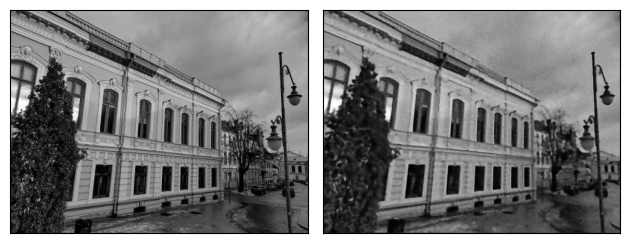

iteration [251/4000], Loss: 0.002728568622842431
iteration [252/4000], Loss: 0.002732513938099146
iteration [253/4000], Loss: 0.0027165445499122143
iteration [254/4000], Loss: 0.002733789850026369
iteration [255/4000], Loss: 0.0028279602993279696
iteration [256/4000], Loss: 0.0027945542242377996
iteration [257/4000], Loss: 0.0028632034081965685
iteration [258/4000], Loss: 0.0028401880990713835
iteration [259/4000], Loss: 0.0026889005675911903
iteration [260/4000], Loss: 0.0027102981694042683
iteration [261/4000], Loss: 0.0027388441376388073
iteration [262/4000], Loss: 0.0026709300000220537
iteration [263/4000], Loss: 0.0026679730508476496
iteration [264/4000], Loss: 0.002698922762647271
iteration [265/4000], Loss: 0.002599297557026148
iteration [266/4000], Loss: 0.0026702992618083954
iteration [267/4000], Loss: 0.0026479593943804502
iteration [268/4000], Loss: 0.002569343661889434
iteration [269/4000], Loss: 0.002581370994448662
iteration [270/4000], Loss: 0.0025428032968193293
iterati

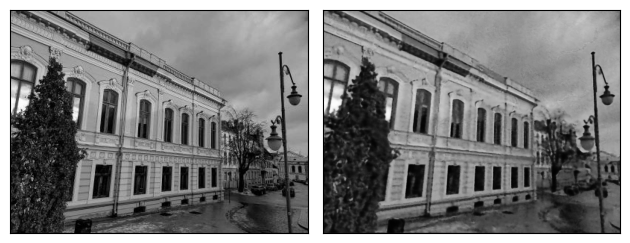

iteration [276/4000], Loss: 0.0026264709886163473
iteration [277/4000], Loss: 0.002717459574341774
iteration [278/4000], Loss: 0.002672123722732067
iteration [279/4000], Loss: 0.002627008128911257
iteration [280/4000], Loss: 0.0024664727970957756
iteration [281/4000], Loss: 0.0025676146615296602
iteration [282/4000], Loss: 0.002603602595627308
iteration [283/4000], Loss: 0.0025009303353726864
iteration [284/4000], Loss: 0.002520604059100151
iteration [285/4000], Loss: 0.0025744603481143713
iteration [286/4000], Loss: 0.0027155743446201086
iteration [287/4000], Loss: 0.00292008719407022
iteration [288/4000], Loss: 0.002931992057710886
iteration [289/4000], Loss: 0.0028553507290780544
iteration [290/4000], Loss: 0.0026424850802868605
iteration [291/4000], Loss: 0.002676536561921239
iteration [292/4000], Loss: 0.0026865683030337095
iteration [293/4000], Loss: 0.002513863379135728
iteration [294/4000], Loss: 0.002554520033299923
iteration [295/4000], Loss: 0.0025830266531556845
iteration [

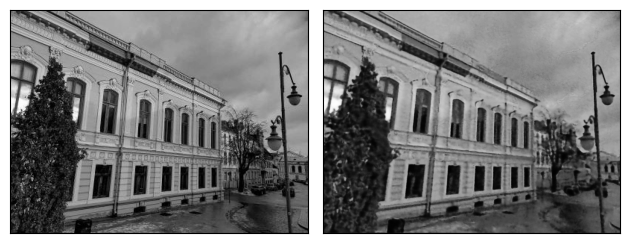

iteration [301/4000], Loss: 0.0023849441204220057
iteration [302/4000], Loss: 0.0023491389583796263
iteration [303/4000], Loss: 0.002335779368877411
iteration [304/4000], Loss: 0.002355419797822833
iteration [305/4000], Loss: 0.00228477013297379
iteration [306/4000], Loss: 0.0023049977608025074
iteration [307/4000], Loss: 0.002287990879267454
iteration [308/4000], Loss: 0.0022728906478732824
iteration [309/4000], Loss: 0.0023094385396689177
iteration [310/4000], Loss: 0.002341798972338438
iteration [311/4000], Loss: 0.002513042651116848
iteration [312/4000], Loss: 0.002580259693786502
iteration [313/4000], Loss: 0.002736500231549144
iteration [314/4000], Loss: 0.0024034183006733656
iteration [315/4000], Loss: 0.002383673330768943
iteration [316/4000], Loss: 0.0026138692628592253
iteration [317/4000], Loss: 0.002547306939959526
iteration [318/4000], Loss: 0.002401597099378705
iteration [319/4000], Loss: 0.002455764217302203
iteration [320/4000], Loss: 0.0023669095244258642
iteration [32

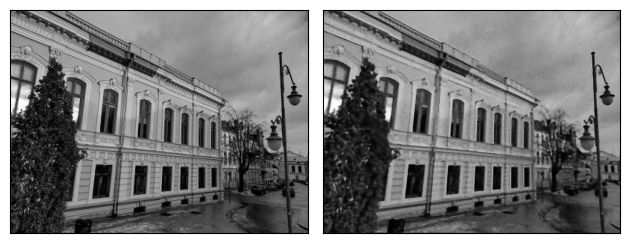

iteration [326/4000], Loss: 0.00222451682202518
iteration [327/4000], Loss: 0.002189984079450369
iteration [328/4000], Loss: 0.002164514036849141
iteration [329/4000], Loss: 0.002168444450944662
iteration [330/4000], Loss: 0.0021660050842911005
iteration [331/4000], Loss: 0.0021631959825754166
iteration [332/4000], Loss: 0.002154936781153083
iteration [333/4000], Loss: 0.002225132193416357
iteration [334/4000], Loss: 0.0023310936521738768
iteration [335/4000], Loss: 0.0025039752945303917
iteration [336/4000], Loss: 0.0026400014758110046
iteration [337/4000], Loss: 0.002461007097736001
iteration [338/4000], Loss: 0.0022171977907419205
iteration [339/4000], Loss: 0.002240159548819065
iteration [340/4000], Loss: 0.0023462495300918818
iteration [341/4000], Loss: 0.0023020757362246513
iteration [342/4000], Loss: 0.002196219516918063
iteration [343/4000], Loss: 0.002188111422583461
iteration [344/4000], Loss: 0.00219344743527472
iteration [345/4000], Loss: 0.002156944712623954
iteration [346

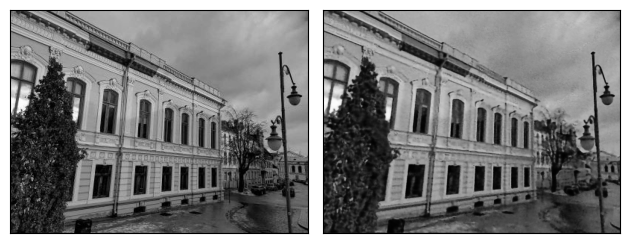

iteration [351/4000], Loss: 0.002067997818812728
iteration [352/4000], Loss: 0.0020534005016088486
iteration [353/4000], Loss: 0.0020128069445490837
iteration [354/4000], Loss: 0.0020431794691830873
iteration [355/4000], Loss: 0.0020976888481527567
iteration [356/4000], Loss: 0.002172254491597414
iteration [357/4000], Loss: 0.0022306155879050493
iteration [358/4000], Loss: 0.002348498674109578
iteration [359/4000], Loss: 0.002183604286983609
iteration [360/4000], Loss: 0.00208152923732996
iteration [361/4000], Loss: 0.0021871088538318872
iteration [362/4000], Loss: 0.002206801436841488
iteration [363/4000], Loss: 0.002248933771625161
iteration [364/4000], Loss: 0.0022134981118142605
iteration [365/4000], Loss: 0.0021640616469085217
iteration [366/4000], Loss: 0.0021567889489233494
iteration [367/4000], Loss: 0.002087267581373453
iteration [368/4000], Loss: 0.00202954257838428
iteration [369/4000], Loss: 0.0021183667704463005
iteration [370/4000], Loss: 0.0020741417538374662
iteration [

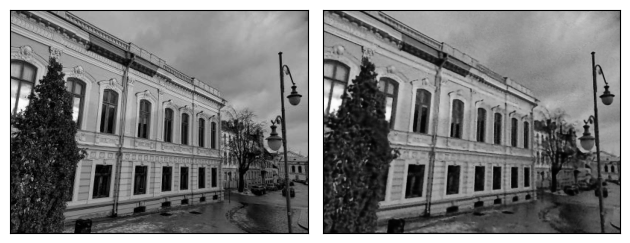

iteration [376/4000], Loss: 0.0019370124209672213
iteration [377/4000], Loss: 0.0019175870111212134
iteration [378/4000], Loss: 0.001952995778992772
iteration [379/4000], Loss: 0.0019370627123862505
iteration [380/4000], Loss: 0.0019440562464296818
iteration [381/4000], Loss: 0.0020150933414697647
iteration [382/4000], Loss: 0.002086331369355321
iteration [383/4000], Loss: 0.0022384526673704386
iteration [384/4000], Loss: 0.0023982394486665726
iteration [385/4000], Loss: 0.0023680729791522026
iteration [386/4000], Loss: 0.0023234528489410877
iteration [387/4000], Loss: 0.002222545677796006
iteration [388/4000], Loss: 0.0022090082056820393
iteration [389/4000], Loss: 0.00216950592584908
iteration [390/4000], Loss: 0.002123433630913496
iteration [391/4000], Loss: 0.0021122577600181103
iteration [392/4000], Loss: 0.0020382723305374384
iteration [393/4000], Loss: 0.0020083338022232056
iteration [394/4000], Loss: 0.002029900439083576
iteration [395/4000], Loss: 0.0019694287329912186
iterati

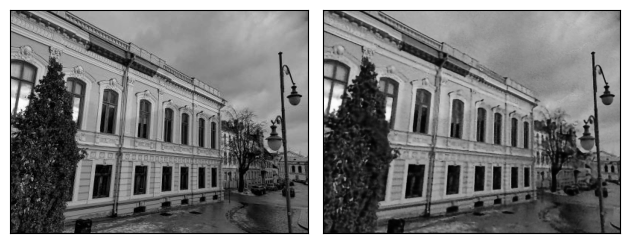

iteration [401/4000], Loss: 0.0018399272812530398
iteration [402/4000], Loss: 0.0018706085393205285
iteration [403/4000], Loss: 0.0018152337288483977
iteration [404/4000], Loss: 0.0018214383162558079
iteration [405/4000], Loss: 0.0018190465634688735
iteration [406/4000], Loss: 0.001797483186237514
iteration [407/4000], Loss: 0.0018050754442811012
iteration [408/4000], Loss: 0.0017890998860821128
iteration [409/4000], Loss: 0.001803035382181406
iteration [410/4000], Loss: 0.0018834109650924802
iteration [411/4000], Loss: 0.0019200671231374145
iteration [412/4000], Loss: 0.002089146990329027
iteration [413/4000], Loss: 0.002025352790951729
iteration [414/4000], Loss: 0.0018875465029850602
iteration [415/4000], Loss: 0.00189392757602036
iteration [416/4000], Loss: 0.002050461247563362
iteration [417/4000], Loss: 0.002369799418374896
iteration [418/4000], Loss: 0.002024912741035223
iteration [419/4000], Loss: 0.0021332395263016224
iteration [420/4000], Loss: 0.0022449910175055265
iteration

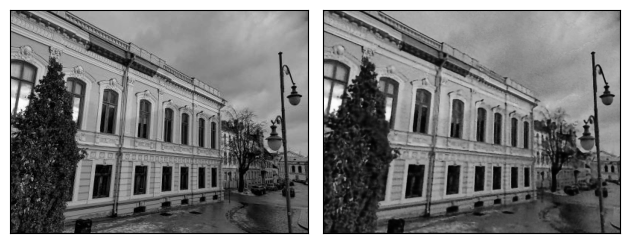

iteration [426/4000], Loss: 0.0018903784221038222
iteration [427/4000], Loss: 0.0018837152747437358
iteration [428/4000], Loss: 0.0018644776428118348
iteration [429/4000], Loss: 0.0018303906545042992
iteration [430/4000], Loss: 0.0018249351996928453
iteration [431/4000], Loss: 0.0017883388791233301
iteration [432/4000], Loss: 0.001788910012692213
iteration [433/4000], Loss: 0.0017539410619065166
iteration [434/4000], Loss: 0.001743573579005897
iteration [435/4000], Loss: 0.0017300931503996253
iteration [436/4000], Loss: 0.0017169986385852098
iteration [437/4000], Loss: 0.0017076407093554735
iteration [438/4000], Loss: 0.0017023623222485185
iteration [439/4000], Loss: 0.0016903623472899199
iteration [440/4000], Loss: 0.0017025506822392344
iteration [441/4000], Loss: 0.0017257966101169586
iteration [442/4000], Loss: 0.0018216572934761643
iteration [443/4000], Loss: 0.001997295068576932
iteration [444/4000], Loss: 0.0023309311363846064
iteration [445/4000], Loss: 0.0022911757696419954
ite

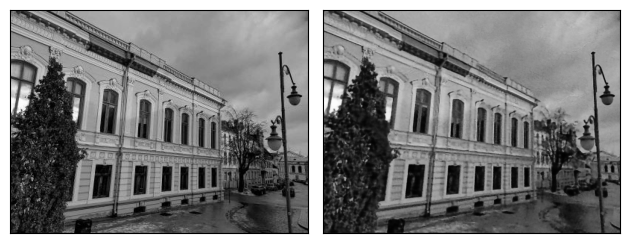

iteration [451/4000], Loss: 0.0020010073203593493
iteration [452/4000], Loss: 0.0018579636234790087
iteration [453/4000], Loss: 0.0018958518048748374
iteration [454/4000], Loss: 0.0018939911387860775
iteration [455/4000], Loss: 0.0017983420984819531
iteration [456/4000], Loss: 0.0018452483927831054
iteration [457/4000], Loss: 0.001768571208231151
iteration [458/4000], Loss: 0.0017548749456182122
iteration [459/4000], Loss: 0.0017660042503848672
iteration [460/4000], Loss: 0.0016873261192813516
iteration [461/4000], Loss: 0.0017416237387806177
iteration [462/4000], Loss: 0.0017229910008609295
iteration [463/4000], Loss: 0.001707306131720543
iteration [464/4000], Loss: 0.0016877262387424707
iteration [465/4000], Loss: 0.0016380954766646028
iteration [466/4000], Loss: 0.00166797055862844
iteration [467/4000], Loss: 0.0016495261806994677
iteration [468/4000], Loss: 0.00163826544303447
iteration [469/4000], Loss: 0.001644912059418857
iteration [470/4000], Loss: 0.0016299873823300004
iterati

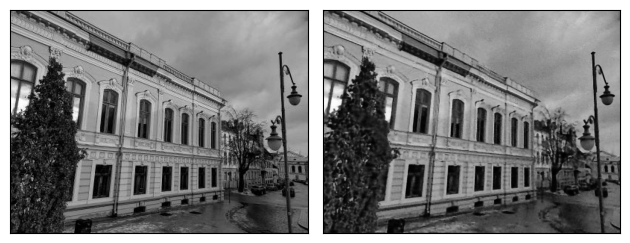

iteration [476/4000], Loss: 0.001992416102439165
iteration [477/4000], Loss: 0.0018221455393359065
iteration [478/4000], Loss: 0.001744933077134192
iteration [479/4000], Loss: 0.0018087957287207246
iteration [480/4000], Loss: 0.0018208440160378814
iteration [481/4000], Loss: 0.0017097386298701167
iteration [482/4000], Loss: 0.0017107800813391805
iteration [483/4000], Loss: 0.001713829580694437
iteration [484/4000], Loss: 0.001674297614954412
iteration [485/4000], Loss: 0.0017029205337166786
iteration [486/4000], Loss: 0.0016543962992727757
iteration [487/4000], Loss: 0.0016154980985447764
iteration [488/4000], Loss: 0.001657587243244052
iteration [489/4000], Loss: 0.0016072143334895372
iteration [490/4000], Loss: 0.001581760705448687
iteration [491/4000], Loss: 0.0015787107404321432
iteration [492/4000], Loss: 0.0015678447671234608
iteration [493/4000], Loss: 0.0015623252838850021
iteration [494/4000], Loss: 0.0015479967696592212
iteration [495/4000], Loss: 0.0015299926744773984
iterat

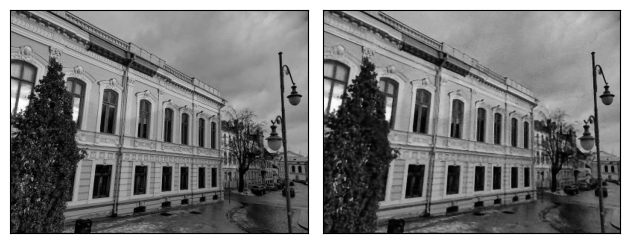

iteration [501/4000], Loss: 0.0018388921162113547
iteration [502/4000], Loss: 0.0017591058276593685
iteration [503/4000], Loss: 0.0015714382752776146
iteration [504/4000], Loss: 0.0015776357613503933
iteration [505/4000], Loss: 0.0017081695841625333
iteration [506/4000], Loss: 0.0016526255058124661
iteration [507/4000], Loss: 0.0015957638388499618
iteration [508/4000], Loss: 0.0015699631767347455
iteration [509/4000], Loss: 0.0015936361160129309
iteration [510/4000], Loss: 0.0015642603393644094
iteration [511/4000], Loss: 0.0015350735047832131
iteration [512/4000], Loss: 0.0015563120832666755
iteration [513/4000], Loss: 0.0015337314689531922
iteration [514/4000], Loss: 0.0014871085295453668
iteration [515/4000], Loss: 0.0015350444009527564
iteration [516/4000], Loss: 0.0015373599017038941
iteration [517/4000], Loss: 0.0015101413009688258
iteration [518/4000], Loss: 0.001542579149827361
iteration [519/4000], Loss: 0.001646480755880475
iteration [520/4000], Loss: 0.0016405443893745542
it

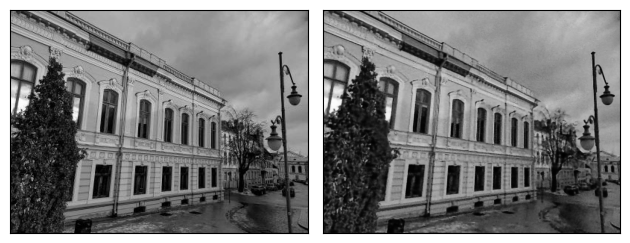

iteration [526/4000], Loss: 0.0015549230156466365
iteration [527/4000], Loss: 0.0015996340662240982
iteration [528/4000], Loss: 0.0016816429561004043
iteration [529/4000], Loss: 0.001747551024891436
iteration [530/4000], Loss: 0.0018684760434553027
iteration [531/4000], Loss: 0.0018455195240676403
iteration [532/4000], Loss: 0.0015484626637771726
iteration [533/4000], Loss: 0.001596067100763321
iteration [534/4000], Loss: 0.001662757364101708
iteration [535/4000], Loss: 0.001556862611323595
iteration [536/4000], Loss: 0.001585428835824132
iteration [537/4000], Loss: 0.0015261685475707054
iteration [538/4000], Loss: 0.0015493823448196054
iteration [539/4000], Loss: 0.001531328889541328
iteration [540/4000], Loss: 0.0014609553618356586
iteration [541/4000], Loss: 0.001506571308709681
iteration [542/4000], Loss: 0.001474654534831643
iteration [543/4000], Loss: 0.0014443565160036087
iteration [544/4000], Loss: 0.001447597285732627
iteration [545/4000], Loss: 0.0014188021887093782
iteration

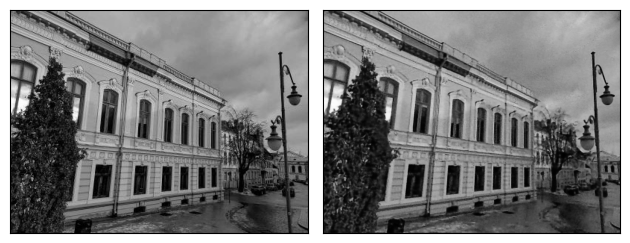

iteration [551/4000], Loss: 0.0014779564226046205
iteration [552/4000], Loss: 0.0015389645704999566
iteration [553/4000], Loss: 0.001567021943628788
iteration [554/4000], Loss: 0.0015882013831287622
iteration [555/4000], Loss: 0.0014401184162124991
iteration [556/4000], Loss: 0.001427349867299199
iteration [557/4000], Loss: 0.0014852330787107348
iteration [558/4000], Loss: 0.0014817528426647186
iteration [559/4000], Loss: 0.0014167623594403267
iteration [560/4000], Loss: 0.0013867263915017247
iteration [561/4000], Loss: 0.0014230143278837204
iteration [562/4000], Loss: 0.0014288581442087889
iteration [563/4000], Loss: 0.0014392684679478407
iteration [564/4000], Loss: 0.0014564216835424304
iteration [565/4000], Loss: 0.00156529457308352
iteration [566/4000], Loss: 0.0015666467370465398
iteration [567/4000], Loss: 0.0016011808766052127
iteration [568/4000], Loss: 0.001458571176044643
iteration [569/4000], Loss: 0.001457635429687798
iteration [570/4000], Loss: 0.0014867919962853193
iterat

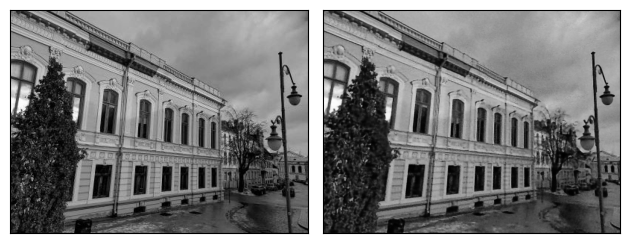

iteration [576/4000], Loss: 0.0013882431667298079
iteration [577/4000], Loss: 0.0014004335971549153
iteration [578/4000], Loss: 0.0014587605837732553
iteration [579/4000], Loss: 0.0015268097631633282
iteration [580/4000], Loss: 0.0017216367414221168
iteration [581/4000], Loss: 0.001855984446592629
iteration [582/4000], Loss: 0.0018653776496648788
iteration [583/4000], Loss: 0.0015872629592195153
iteration [584/4000], Loss: 0.00150860205758363
iteration [585/4000], Loss: 0.001637282082810998
iteration [586/4000], Loss: 0.001536847441457212
iteration [587/4000], Loss: 0.0015329312300309539
iteration [588/4000], Loss: 0.0015337796648964286
iteration [589/4000], Loss: 0.0014379072235897183
iteration [590/4000], Loss: 0.0015145617071539164
iteration [591/4000], Loss: 0.0014423721004277468
iteration [592/4000], Loss: 0.0014475121861323714
iteration [593/4000], Loss: 0.0014214685652405024
iteration [594/4000], Loss: 0.0013728729682043195
iteration [595/4000], Loss: 0.0013948018895462155
itera

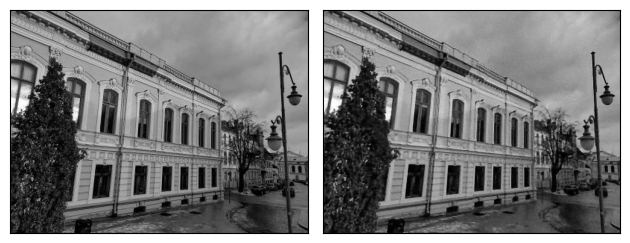

iteration [601/4000], Loss: 0.0012795432703569531
iteration [602/4000], Loss: 0.0012697591446340084
iteration [603/4000], Loss: 0.001274546841159463
iteration [604/4000], Loss: 0.0012385125737637281
iteration [605/4000], Loss: 0.0012554822023957968
iteration [606/4000], Loss: 0.0012432727962732315
iteration [607/4000], Loss: 0.0012433308875188231
iteration [608/4000], Loss: 0.0012776331277564168
iteration [609/4000], Loss: 0.0013721832074224949
iteration [610/4000], Loss: 0.0015765699790790677
iteration [611/4000], Loss: 0.002005415502935648
iteration [612/4000], Loss: 0.0016507881227880716
iteration [613/4000], Loss: 0.001431944314390421
iteration [614/4000], Loss: 0.00164277502335608
iteration [615/4000], Loss: 0.0015384352300316095
iteration [616/4000], Loss: 0.0015215066960081458
iteration [617/4000], Loss: 0.0015251773875206709
iteration [618/4000], Loss: 0.0015024793101474643
iteration [619/4000], Loss: 0.0014509226894006133
iteration [620/4000], Loss: 0.0014620644506067038
itera

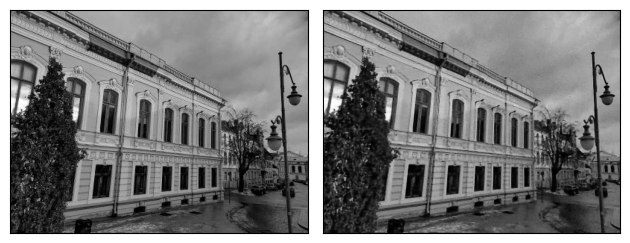

iteration [626/4000], Loss: 0.001270001521334052
iteration [627/4000], Loss: 0.0012995826546102762
iteration [628/4000], Loss: 0.0012774805072695017
iteration [629/4000], Loss: 0.0012755030766129494
iteration [630/4000], Loss: 0.0012711876770481467
iteration [631/4000], Loss: 0.0012664179084822536
iteration [632/4000], Loss: 0.001268490101210773
iteration [633/4000], Loss: 0.001250838628038764
iteration [634/4000], Loss: 0.0012682770611718297
iteration [635/4000], Loss: 0.0012771922629326582
iteration [636/4000], Loss: 0.0013064438244327903
iteration [637/4000], Loss: 0.0013527135597541928
iteration [638/4000], Loss: 0.0014140111161395907
iteration [639/4000], Loss: 0.0014249129453673959
iteration [640/4000], Loss: 0.0013547935523092747
iteration [641/4000], Loss: 0.001241599558852613
iteration [642/4000], Loss: 0.0012266054982319474
iteration [643/4000], Loss: 0.0012722943210974336
iteration [644/4000], Loss: 0.0013075170572847128
iteration [645/4000], Loss: 0.001252821646630764
itera

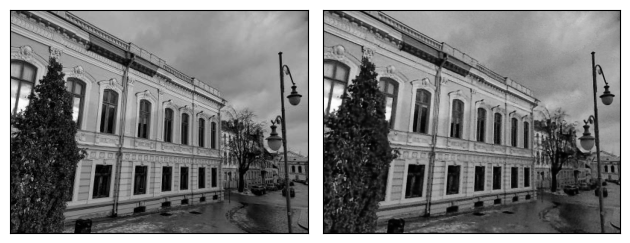

iteration [651/4000], Loss: 0.0013223295100033283
iteration [652/4000], Loss: 0.0013573082396760583
iteration [653/4000], Loss: 0.0014197176788002253
iteration [654/4000], Loss: 0.001360386493615806
iteration [655/4000], Loss: 0.0013296710094437003
iteration [656/4000], Loss: 0.001329647027887404
iteration [657/4000], Loss: 0.0012655843747779727
iteration [658/4000], Loss: 0.0012650423450395465
iteration [659/4000], Loss: 0.0012444363674148917
iteration [660/4000], Loss: 0.001210417365655303
iteration [661/4000], Loss: 0.0012229926651343703
iteration [662/4000], Loss: 0.0012098017614334822
iteration [663/4000], Loss: 0.0012006111210212111
iteration [664/4000], Loss: 0.0011900975368916988
iteration [665/4000], Loss: 0.0011849825968965888
iteration [666/4000], Loss: 0.0011627990752458572
iteration [667/4000], Loss: 0.0011917843949049711
iteration [668/4000], Loss: 0.0012389963958412409
iteration [669/4000], Loss: 0.001313480082899332
iteration [670/4000], Loss: 0.0013479870976880193
iter

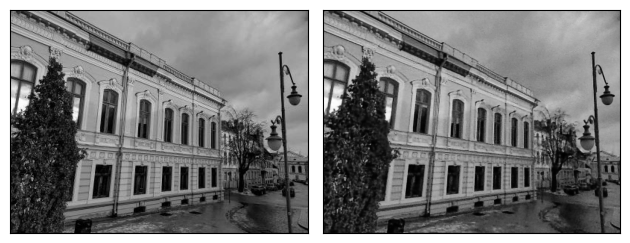

iteration [676/4000], Loss: 0.0012291490565985441
iteration [677/4000], Loss: 0.0012522721663117409
iteration [678/4000], Loss: 0.001224067178554833
iteration [679/4000], Loss: 0.0011252128751948476
iteration [680/4000], Loss: 0.0011503493878990412
iteration [681/4000], Loss: 0.0011926223523914814
iteration [682/4000], Loss: 0.0011590997455641627
iteration [683/4000], Loss: 0.0011408769059926271
iteration [684/4000], Loss: 0.0011207209900021553
iteration [685/4000], Loss: 0.001109620905481279
iteration [686/4000], Loss: 0.001130833406932652
iteration [687/4000], Loss: 0.001126687042415142
iteration [688/4000], Loss: 0.0011811869917437434
iteration [689/4000], Loss: 0.0012488245265558362
iteration [690/4000], Loss: 0.0014127528993412852
iteration [691/4000], Loss: 0.0014950823970139027
iteration [692/4000], Loss: 0.0015403851866722107
iteration [693/4000], Loss: 0.0013500906061381102
iteration [694/4000], Loss: 0.0013613096671178937
iteration [695/4000], Loss: 0.0015653128502890468
iter

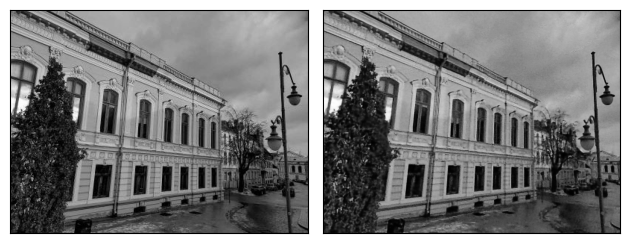

iteration [701/4000], Loss: 0.0013199885142967105
iteration [702/4000], Loss: 0.0012571725528687239
iteration [703/4000], Loss: 0.0012047727359458804
iteration [704/4000], Loss: 0.0012675473699346185
iteration [705/4000], Loss: 0.0011609973153099418
iteration [706/4000], Loss: 0.0012087603099644184
iteration [707/4000], Loss: 0.0011621516896411777
iteration [708/4000], Loss: 0.001161018619313836
iteration [709/4000], Loss: 0.0011418693466112018
iteration [710/4000], Loss: 0.0011096548987552524
iteration [711/4000], Loss: 0.0011314487783238292
iteration [712/4000], Loss: 0.0010765722254291177
iteration [713/4000], Loss: 0.0010986034758388996
iteration [714/4000], Loss: 0.00106231146492064
iteration [715/4000], Loss: 0.00106399180367589
iteration [716/4000], Loss: 0.0010626398725435138
iteration [717/4000], Loss: 0.0010606769938021898
iteration [718/4000], Loss: 0.0010638160165399313
iteration [719/4000], Loss: 0.0010672381613403559
iteration [720/4000], Loss: 0.0011354086454957724
itera

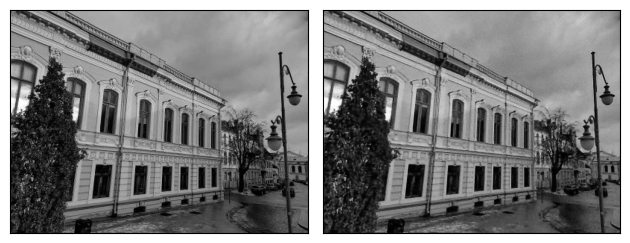

iteration [726/4000], Loss: 0.0012216087197884917
iteration [727/4000], Loss: 0.0013986185658723116
iteration [728/4000], Loss: 0.0012427701149135828
iteration [729/4000], Loss: 0.0011734024155884981
iteration [730/4000], Loss: 0.001280922326259315
iteration [731/4000], Loss: 0.0011811589356511831
iteration [732/4000], Loss: 0.001113537116907537
iteration [733/4000], Loss: 0.0011584489839151502
iteration [734/4000], Loss: 0.0011201540473848581
iteration [735/4000], Loss: 0.0010903928196057677
iteration [736/4000], Loss: 0.0011087619932368398
iteration [737/4000], Loss: 0.0010987076675519347
iteration [738/4000], Loss: 0.0010689996415749192
iteration [739/4000], Loss: 0.0010746467160061002
iteration [740/4000], Loss: 0.001075918902643025
iteration [741/4000], Loss: 0.0010624147253111005
iteration [742/4000], Loss: 0.0010567944264039397
iteration [743/4000], Loss: 0.0010907946852967143
iteration [744/4000], Loss: 0.0011767593678086996
iteration [745/4000], Loss: 0.0011360218049958348
ite

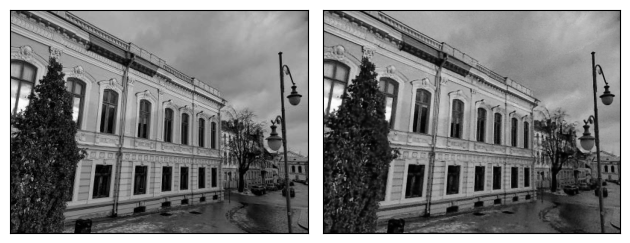

iteration [751/4000], Loss: 0.0012296782806515694
iteration [752/4000], Loss: 0.0012893234379589558
iteration [753/4000], Loss: 0.00129905273206532
iteration [754/4000], Loss: 0.0011459562228992581
iteration [755/4000], Loss: 0.0011128487531095743
iteration [756/4000], Loss: 0.001187163288705051
iteration [757/4000], Loss: 0.001105311675928533
iteration [758/4000], Loss: 0.001104069291613996
iteration [759/4000], Loss: 0.0010951217263936996
iteration [760/4000], Loss: 0.0010587337892502546
iteration [761/4000], Loss: 0.0010892247082665563
iteration [762/4000], Loss: 0.001032223692163825
iteration [763/4000], Loss: 0.0010255055967718363
iteration [764/4000], Loss: 0.001047370838932693
iteration [765/4000], Loss: 0.0010218466632068157
iteration [766/4000], Loss: 0.0010173944756388664
iteration [767/4000], Loss: 0.0010200360557064414
iteration [768/4000], Loss: 0.0010385924251750112
iteration [769/4000], Loss: 0.0010690854396671057
iteration [770/4000], Loss: 0.0011195249389857054
iterati

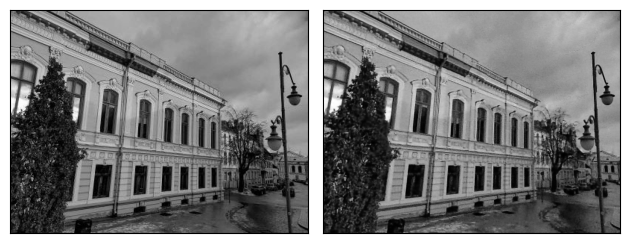

iteration [776/4000], Loss: 0.0010702911531552672
iteration [777/4000], Loss: 0.0010645306902006269
iteration [778/4000], Loss: 0.0010212536435574293
iteration [779/4000], Loss: 0.0010272215586155653
iteration [780/4000], Loss: 0.0010235330555588007
iteration [781/4000], Loss: 0.0010100812651216984
iteration [782/4000], Loss: 0.0009993414860218763
iteration [783/4000], Loss: 0.0009885936742648482
iteration [784/4000], Loss: 0.0009805032750591636
iteration [785/4000], Loss: 0.0010069645941257477
iteration [786/4000], Loss: 0.0010044329101219773
iteration [787/4000], Loss: 0.0010275630047544837
iteration [788/4000], Loss: 0.0010688178008422256
iteration [789/4000], Loss: 0.0011672782711684704
iteration [790/4000], Loss: 0.0011490427423268557
iteration [791/4000], Loss: 0.0010890023550018668
iteration [792/4000], Loss: 0.0010106719564646482
iteration [793/4000], Loss: 0.0010754041140899062
iteration [794/4000], Loss: 0.0011785003589466214
iteration [795/4000], Loss: 0.0010586054995656013


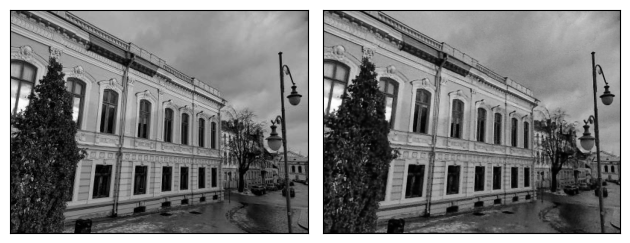

iteration [801/4000], Loss: 0.00103262928314507
iteration [802/4000], Loss: 0.0010380866006016731
iteration [803/4000], Loss: 0.0010366125497967005
iteration [804/4000], Loss: 0.0010137326316908002
iteration [805/4000], Loss: 0.0010011786362156272
iteration [806/4000], Loss: 0.0009898074204102159
iteration [807/4000], Loss: 0.0009614920127205551
iteration [808/4000], Loss: 0.0009561445913277566
iteration [809/4000], Loss: 0.0009506954229436815
iteration [810/4000], Loss: 0.000934384937863797
iteration [811/4000], Loss: 0.0009251586743630469
iteration [812/4000], Loss: 0.0008975345990620553
iteration [813/4000], Loss: 0.000912900548428297
iteration [814/4000], Loss: 0.0009154948638752103
iteration [815/4000], Loss: 0.0009099741582758725
iteration [816/4000], Loss: 0.0009210294228978455
iteration [817/4000], Loss: 0.0009306894498877227
iteration [818/4000], Loss: 0.0009819908300414681
iteration [819/4000], Loss: 0.0010089147835969925
iteration [820/4000], Loss: 0.0010983772808685899
iter

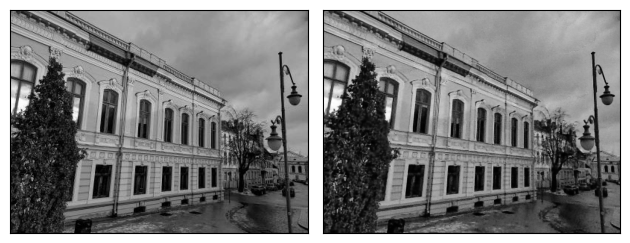

iteration [826/4000], Loss: 0.0011505500879138708
iteration [827/4000], Loss: 0.0010798985604196787
iteration [828/4000], Loss: 0.0011264729546383023
iteration [829/4000], Loss: 0.0010398486629128456
iteration [830/4000], Loss: 0.0011521083069965243
iteration [831/4000], Loss: 0.001073405728675425
iteration [832/4000], Loss: 0.0010090551804751158
iteration [833/4000], Loss: 0.0011043751146644354
iteration [834/4000], Loss: 0.0010253610089421272
iteration [835/4000], Loss: 0.0009944963967427611
iteration [836/4000], Loss: 0.001031953957863152
iteration [837/4000], Loss: 0.0010100487852469087
iteration [838/4000], Loss: 0.0009710407466627657
iteration [839/4000], Loss: 0.000977677060291171
iteration [840/4000], Loss: 0.0009710250305943191
iteration [841/4000], Loss: 0.0009604858933016658
iteration [842/4000], Loss: 0.0009468492353335023
iteration [843/4000], Loss: 0.0009232499287463725
iteration [844/4000], Loss: 0.0009572916897013783
iteration [845/4000], Loss: 0.0009315063362009823
ite

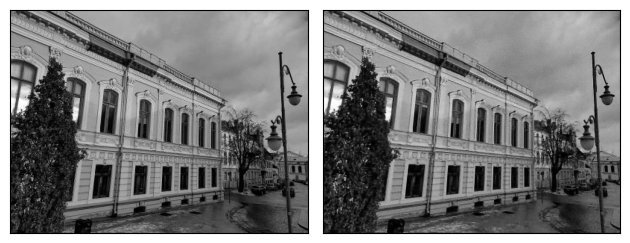

iteration [851/4000], Loss: 0.0008932275814004242
iteration [852/4000], Loss: 0.0008807714912109077
iteration [853/4000], Loss: 0.0008618252468295395
iteration [854/4000], Loss: 0.0008638369617983699
iteration [855/4000], Loss: 0.0008802396478131413
iteration [856/4000], Loss: 0.0008944391738623381
iteration [857/4000], Loss: 0.0009464454487897456
iteration [858/4000], Loss: 0.0010132472962141037
iteration [859/4000], Loss: 0.0011474977945908904
iteration [860/4000], Loss: 0.0010386341018602252
iteration [861/4000], Loss: 0.0010012852726504207
iteration [862/4000], Loss: 0.0010193297639489174
iteration [863/4000], Loss: 0.0010410231770947576
iteration [864/4000], Loss: 0.001092397840693593
iteration [865/4000], Loss: 0.0009185723611153662
iteration [866/4000], Loss: 0.00098123075440526
iteration [867/4000], Loss: 0.0010282853618264198
iteration [868/4000], Loss: 0.0009190076380036771
iteration [869/4000], Loss: 0.0009332969784736633
iteration [870/4000], Loss: 0.0009634543093852699
ite

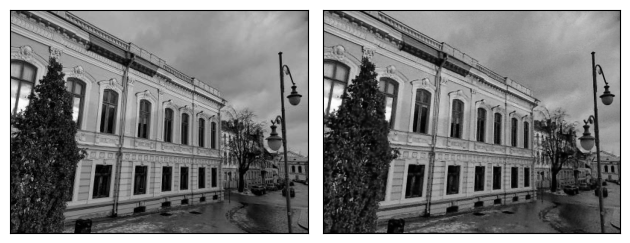

iteration [876/4000], Loss: 0.0009289610898122191
iteration [877/4000], Loss: 0.0009566827793605626
iteration [878/4000], Loss: 0.000984502607025206
iteration [879/4000], Loss: 0.000944897998124361
iteration [880/4000], Loss: 0.0009765683207660913
iteration [881/4000], Loss: 0.0009441666770726442
iteration [882/4000], Loss: 0.0009858468547463417
iteration [883/4000], Loss: 0.001061184797435999
iteration [884/4000], Loss: 0.0010058976477012038
iteration [885/4000], Loss: 0.0009467099444009364
iteration [886/4000], Loss: 0.000855114427395165
iteration [887/4000], Loss: 0.0008830390870571136
iteration [888/4000], Loss: 0.0009367017773911357
iteration [889/4000], Loss: 0.0009016076219268143
iteration [890/4000], Loss: 0.0008808386628516018
iteration [891/4000], Loss: 0.0008532799547538161
iteration [892/4000], Loss: 0.000859476625919342
iteration [893/4000], Loss: 0.000892561161890626
iteration [894/4000], Loss: 0.0008728611283004284
iteration [895/4000], Loss: 0.0008576193358749151
iterat

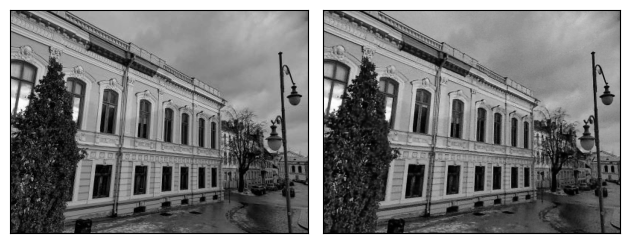

iteration [901/4000], Loss: 0.0009075959678739309
iteration [902/4000], Loss: 0.0009547685622237623
iteration [903/4000], Loss: 0.0010586243588477373
iteration [904/4000], Loss: 0.0009624597150832415
iteration [905/4000], Loss: 0.0008817941998131573
iteration [906/4000], Loss: 0.0008899248205125332
iteration [907/4000], Loss: 0.0009206309332512319
iteration [908/4000], Loss: 0.0009376597590744495
iteration [909/4000], Loss: 0.0009017273550853133
iteration [910/4000], Loss: 0.0008677146397531033
iteration [911/4000], Loss: 0.0008769082487560809
iteration [912/4000], Loss: 0.0008851256570778787
iteration [913/4000], Loss: 0.0008488561143167317
iteration [914/4000], Loss: 0.0008492190972901881
iteration [915/4000], Loss: 0.000882704567629844
iteration [916/4000], Loss: 0.000901024613995105
iteration [917/4000], Loss: 0.0009080246672965586
iteration [918/4000], Loss: 0.0009045945480465889
iteration [919/4000], Loss: 0.0009001802536658943
iteration [920/4000], Loss: 0.0009213004377670586
it

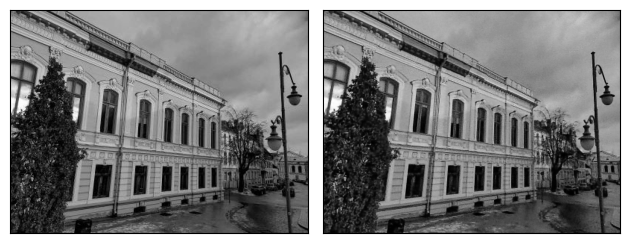

iteration [926/4000], Loss: 0.0008725007646717131
iteration [927/4000], Loss: 0.0008997971890494227
iteration [928/4000], Loss: 0.0009330565226264298
iteration [929/4000], Loss: 0.0010165564017370343
iteration [930/4000], Loss: 0.000978535390459001
iteration [931/4000], Loss: 0.0009784884750843048
iteration [932/4000], Loss: 0.0010273163206875324
iteration [933/4000], Loss: 0.0009295661002397537
iteration [934/4000], Loss: 0.0008587233605794609
iteration [935/4000], Loss: 0.0008475604699924588
iteration [936/4000], Loss: 0.0008619275758974254
iteration [937/4000], Loss: 0.0008559324196539819
iteration [938/4000], Loss: 0.000828863529022783
iteration [939/4000], Loss: 0.0007871753768995404
iteration [940/4000], Loss: 0.0007898567127995193
iteration [941/4000], Loss: 0.0008255223510786891
iteration [942/4000], Loss: 0.0007978423382155597
iteration [943/4000], Loss: 0.0007764743058942258
iteration [944/4000], Loss: 0.0007759915897622705
iteration [945/4000], Loss: 0.0007906400132924318
it

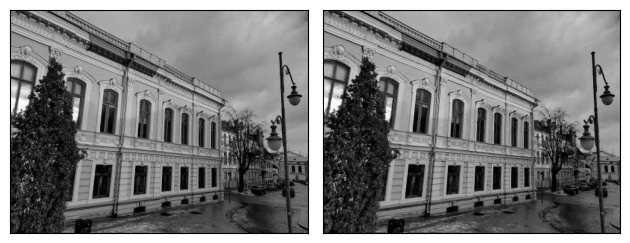

iteration [951/4000], Loss: 0.0009608769905753434
iteration [952/4000], Loss: 0.001081226859241724
iteration [953/4000], Loss: 0.0010527641279622912
iteration [954/4000], Loss: 0.0009260554797947407
iteration [955/4000], Loss: 0.0009356610826216638
iteration [956/4000], Loss: 0.0009356253431178629
iteration [957/4000], Loss: 0.0008666377398185432
iteration [958/4000], Loss: 0.0008574248058721423
iteration [959/4000], Loss: 0.0008722689235582948
iteration [960/4000], Loss: 0.0008365309913642704
iteration [961/4000], Loss: 0.0008288178942166269
iteration [962/4000], Loss: 0.0008421802776865661
iteration [963/4000], Loss: 0.0007943979580886662
iteration [964/4000], Loss: 0.0008031735778786242
iteration [965/4000], Loss: 0.0007840277394279838
iteration [966/4000], Loss: 0.0007639779360033572
iteration [967/4000], Loss: 0.0007752261008135974
iteration [968/4000], Loss: 0.0007723340531811118
iteration [969/4000], Loss: 0.0007781022577546537
iteration [970/4000], Loss: 0.0007639110554009676
i

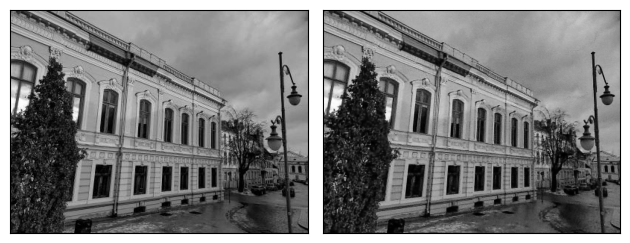

iteration [976/4000], Loss: 0.0009829462505877018
iteration [977/4000], Loss: 0.0010382202453911304
iteration [978/4000], Loss: 0.0009529418894089758
iteration [979/4000], Loss: 0.0008184851612895727
iteration [980/4000], Loss: 0.0008427133434452116
iteration [981/4000], Loss: 0.0009496568818576634
iteration [982/4000], Loss: 0.0008840779773890972
iteration [983/4000], Loss: 0.0007840683683753014
iteration [984/4000], Loss: 0.0008409106521867216
iteration [985/4000], Loss: 0.0009010544745251536
iteration [986/4000], Loss: 0.0008675281424075365
iteration [987/4000], Loss: 0.0008248412050306797
iteration [988/4000], Loss: 0.000891079951543361
iteration [989/4000], Loss: 0.0008093005162663758
iteration [990/4000], Loss: 0.00074586714617908
iteration [991/4000], Loss: 0.0007879057666286826
iteration [992/4000], Loss: 0.000787418510299176
iteration [993/4000], Loss: 0.0007599199889227748
iteration [994/4000], Loss: 0.0007433773716911674
iteration [995/4000], Loss: 0.0007637541275471449
iter

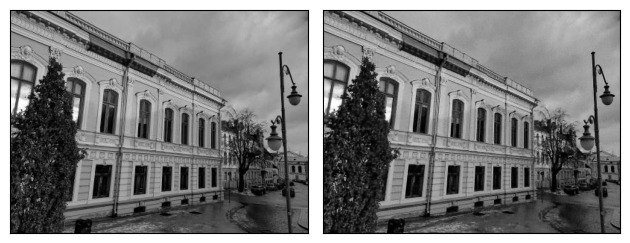

iteration [1001/4000], Loss: 0.0007641899865120649
iteration [1002/4000], Loss: 0.0007709800847806036
iteration [1003/4000], Loss: 0.0007624895661137998
iteration [1004/4000], Loss: 0.0007597069488838315
iteration [1005/4000], Loss: 0.0007631750777363777
iteration [1006/4000], Loss: 0.0007823007181286812
iteration [1007/4000], Loss: 0.0008044550777412951
iteration [1008/4000], Loss: 0.0008230464882217348
iteration [1009/4000], Loss: 0.0007846539956517518
iteration [1010/4000], Loss: 0.000701871991623193
iteration [1011/4000], Loss: 0.0007121309754438698
iteration [1012/4000], Loss: 0.0007668028702028096
iteration [1013/4000], Loss: 0.0007814829587005079
iteration [1014/4000], Loss: 0.0007176361978054047
iteration [1015/4000], Loss: 0.0006927838549017906
iteration [1016/4000], Loss: 0.0007441930938512087
iteration [1017/4000], Loss: 0.0007915812893770635
iteration [1018/4000], Loss: 0.0007768581854179502
iteration [1019/4000], Loss: 0.0008482541306875646
iteration [1020/4000], Loss: 0.0

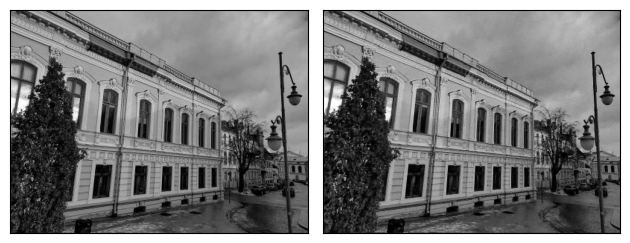

iteration [1026/4000], Loss: 0.0009016405674628913
iteration [1027/4000], Loss: 0.0008542102877981961
iteration [1028/4000], Loss: 0.0007964819087646902
iteration [1029/4000], Loss: 0.0008285135845653713
iteration [1030/4000], Loss: 0.0007589877932332456
iteration [1031/4000], Loss: 0.0007315878756344318
iteration [1032/4000], Loss: 0.0007631328189745545
iteration [1033/4000], Loss: 0.0007202610140666366
iteration [1034/4000], Loss: 0.0007167122093960643
iteration [1035/4000], Loss: 0.000718382652848959
iteration [1036/4000], Loss: 0.0006690103327855468
iteration [1037/4000], Loss: 0.0006907334900461137
iteration [1038/4000], Loss: 0.000696948787663132
iteration [1039/4000], Loss: 0.0006675106124021113
iteration [1040/4000], Loss: 0.000685851788148284
iteration [1041/4000], Loss: 0.0006625534151680768
iteration [1042/4000], Loss: 0.0006527023506350815
iteration [1043/4000], Loss: 0.000660767313092947
iteration [1044/4000], Loss: 0.0006601868662983179
iteration [1045/4000], Loss: 0.0006

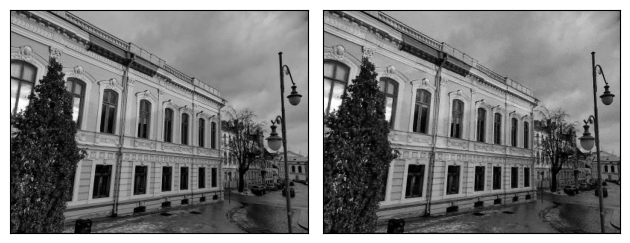

iteration [1051/4000], Loss: 0.0009618166950531304
iteration [1052/4000], Loss: 0.0009426718461327255
iteration [1053/4000], Loss: 0.0012011140352115035
iteration [1054/4000], Loss: 0.0009149768739007413
iteration [1055/4000], Loss: 0.0010583334369584918
iteration [1056/4000], Loss: 0.0012802390847355127
iteration [1057/4000], Loss: 0.0008967441390268505
iteration [1058/4000], Loss: 0.0012077861465513706
iteration [1059/4000], Loss: 0.0009633747395128012
iteration [1060/4000], Loss: 0.0010163915576413274
iteration [1061/4000], Loss: 0.000965922954492271
iteration [1062/4000], Loss: 0.0008970812195912004
iteration [1063/4000], Loss: 0.0009137861779890954
iteration [1064/4000], Loss: 0.0008541196002624929
iteration [1065/4000], Loss: 0.0008494721841998398
iteration [1066/4000], Loss: 0.0008106619352474809
iteration [1067/4000], Loss: 0.0008119783014990389
iteration [1068/4000], Loss: 0.0007754536927677691
iteration [1069/4000], Loss: 0.0007688143523409963
iteration [1070/4000], Loss: 0.0

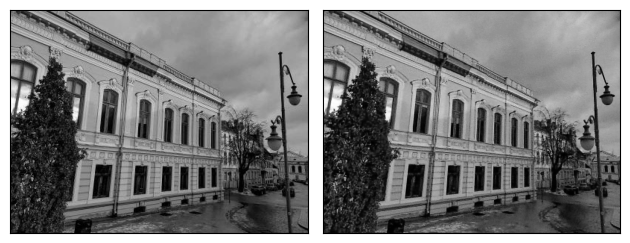

iteration [1076/4000], Loss: 0.000669824075885117
iteration [1077/4000], Loss: 0.0006657320773229003
iteration [1078/4000], Loss: 0.0006528625381179154
iteration [1079/4000], Loss: 0.0006462960736826062
iteration [1080/4000], Loss: 0.0006370231858454645
iteration [1081/4000], Loss: 0.0006331418990157545
iteration [1082/4000], Loss: 0.0006257552886381745
iteration [1083/4000], Loss: 0.0006211065337993205
iteration [1084/4000], Loss: 0.0006178340991027653
iteration [1085/4000], Loss: 0.0006137315067462623
iteration [1086/4000], Loss: 0.000615176628343761
iteration [1087/4000], Loss: 0.0006166553357616067
iteration [1088/4000], Loss: 0.000632897368632257
iteration [1089/4000], Loss: 0.0006649921415373683
iteration [1090/4000], Loss: 0.0007504610694013536
iteration [1091/4000], Loss: 0.0009052663808688521
iteration [1092/4000], Loss: 0.0011454216437414289
iteration [1093/4000], Loss: 0.001156236743554473
iteration [1094/4000], Loss: 0.0008818510686978698
iteration [1095/4000], Loss: 0.0007

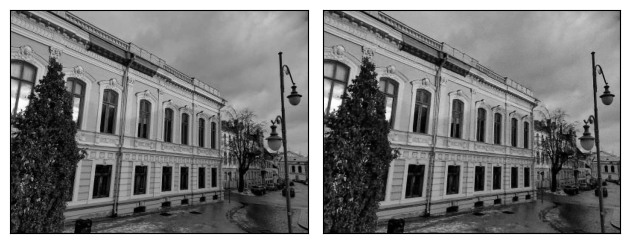

iteration [1101/4000], Loss: 0.0007105739787220955
iteration [1102/4000], Loss: 0.0007712411461398005
iteration [1103/4000], Loss: 0.000720218347851187
iteration [1104/4000], Loss: 0.0006672572926618159
iteration [1105/4000], Loss: 0.0007426459342241287
iteration [1106/4000], Loss: 0.000657292315736413
iteration [1107/4000], Loss: 0.0006553800776600838
iteration [1108/4000], Loss: 0.0007009426481090486
iteration [1109/4000], Loss: 0.0006252344464883208
iteration [1110/4000], Loss: 0.0006455169059336185
iteration [1111/4000], Loss: 0.0006571545964106917
iteration [1112/4000], Loss: 0.0006140214391052723
iteration [1113/4000], Loss: 0.000632811221294105
iteration [1114/4000], Loss: 0.0006507938378490508
iteration [1115/4000], Loss: 0.0006273548351600766
iteration [1116/4000], Loss: 0.0006682974053546786
iteration [1117/4000], Loss: 0.0007375893765129149
iteration [1118/4000], Loss: 0.0007696971297264099
iteration [1119/4000], Loss: 0.0008752910071052611
iteration [1120/4000], Loss: 0.000

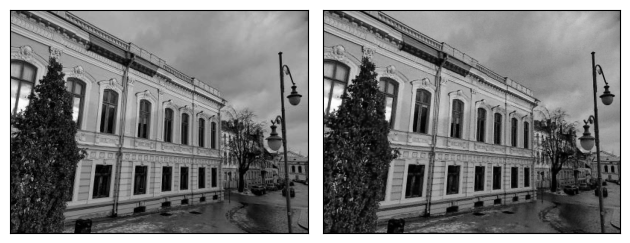

iteration [1126/4000], Loss: 0.0006219379720278084
iteration [1127/4000], Loss: 0.0006290675955824554
iteration [1128/4000], Loss: 0.0006602347129955888
iteration [1129/4000], Loss: 0.000654163071885705
iteration [1130/4000], Loss: 0.0005891447653993964
iteration [1131/4000], Loss: 0.0005909581086598337
iteration [1132/4000], Loss: 0.0006236103363335133
iteration [1133/4000], Loss: 0.0006190330605022609
iteration [1134/4000], Loss: 0.0006096061551943421
iteration [1135/4000], Loss: 0.0005858517833985388
iteration [1136/4000], Loss: 0.0005812717135995626
iteration [1137/4000], Loss: 0.0006199194467626512
iteration [1138/4000], Loss: 0.0006400205311365426
iteration [1139/4000], Loss: 0.0006940959137864411
iteration [1140/4000], Loss: 0.0006822225404903293
iteration [1141/4000], Loss: 0.0007242024876177311
iteration [1142/4000], Loss: 0.0006910901283845305
iteration [1143/4000], Loss: 0.0006792295607738197
iteration [1144/4000], Loss: 0.0006457854760810733
iteration [1145/4000], Loss: 0.0

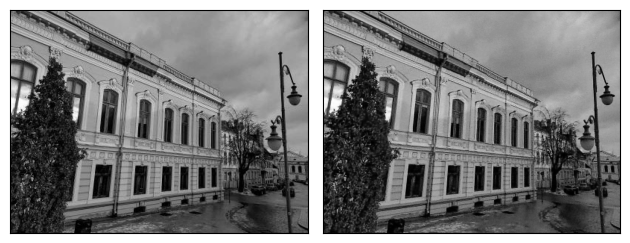

iteration [1151/4000], Loss: 0.0006535330321639776
iteration [1152/4000], Loss: 0.0006398800178430974
iteration [1153/4000], Loss: 0.0006305417628027499
iteration [1154/4000], Loss: 0.0006439636927098036
iteration [1155/4000], Loss: 0.0006647365516982973
iteration [1156/4000], Loss: 0.0006786023150198162
iteration [1157/4000], Loss: 0.0006978085730224848
iteration [1158/4000], Loss: 0.0007522620144300163
iteration [1159/4000], Loss: 0.0007636366644874215
iteration [1160/4000], Loss: 0.0007477783947251737
iteration [1161/4000], Loss: 0.0007609128369949758
iteration [1162/4000], Loss: 0.0007785691414028406
iteration [1163/4000], Loss: 0.0006674530450254679
iteration [1164/4000], Loss: 0.0006922080065123737
iteration [1165/4000], Loss: 0.0007083617965690792
iteration [1166/4000], Loss: 0.0006502379546873271
iteration [1167/4000], Loss: 0.000648879969958216
iteration [1168/4000], Loss: 0.000624648411758244
iteration [1169/4000], Loss: 0.000615508237387985
iteration [1170/4000], Loss: 0.000

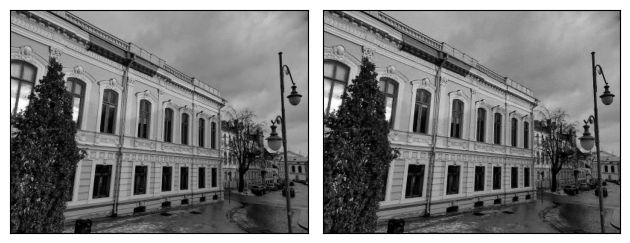

iteration [1176/4000], Loss: 0.0005437952349893749
iteration [1177/4000], Loss: 0.0005466162692755461
iteration [1178/4000], Loss: 0.0005631755921058357
iteration [1179/4000], Loss: 0.0005530150374397635
iteration [1180/4000], Loss: 0.0005632755346596241
iteration [1181/4000], Loss: 0.0005955803208053112
iteration [1182/4000], Loss: 0.0006295618368312716
iteration [1183/4000], Loss: 0.000698154210112989
iteration [1184/4000], Loss: 0.0007923757075332105
iteration [1185/4000], Loss: 0.0008336264290846884
iteration [1186/4000], Loss: 0.0008852814207784832
iteration [1187/4000], Loss: 0.001047890749759972
iteration [1188/4000], Loss: 0.0009818256366997957
iteration [1189/4000], Loss: 0.0007942160591483116
iteration [1190/4000], Loss: 0.0008214266272261739
iteration [1191/4000], Loss: 0.0008211908861994743
iteration [1192/4000], Loss: 0.0007185018039308488
iteration [1193/4000], Loss: 0.0007427584496326745
iteration [1194/4000], Loss: 0.0007318917196244001
iteration [1195/4000], Loss: 0.00

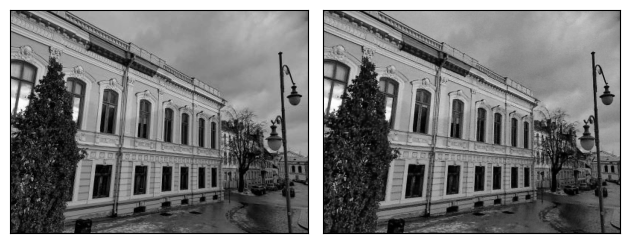

iteration [1201/4000], Loss: 0.0006084206397645175
iteration [1202/4000], Loss: 0.0006135293515399098
iteration [1203/4000], Loss: 0.0005741212517023087
iteration [1204/4000], Loss: 0.0005894933128729463
iteration [1205/4000], Loss: 0.0005708183161914349
iteration [1206/4000], Loss: 0.0005564250750467181
iteration [1207/4000], Loss: 0.0005586451152339578
iteration [1208/4000], Loss: 0.0005486560985445976
iteration [1209/4000], Loss: 0.0005472936318255961
iteration [1210/4000], Loss: 0.0005364115932025015
iteration [1211/4000], Loss: 0.0005339921917766333
iteration [1212/4000], Loss: 0.0005290409899316728
iteration [1213/4000], Loss: 0.000538499210961163
iteration [1214/4000], Loss: 0.0005453175399452448
iteration [1215/4000], Loss: 0.000573004421312362
iteration [1216/4000], Loss: 0.0006230761064216495
iteration [1217/4000], Loss: 0.0007474202429875731
iteration [1218/4000], Loss: 0.0007551746675744653
iteration [1219/4000], Loss: 0.0007601800607517362
iteration [1220/4000], Loss: 0.00

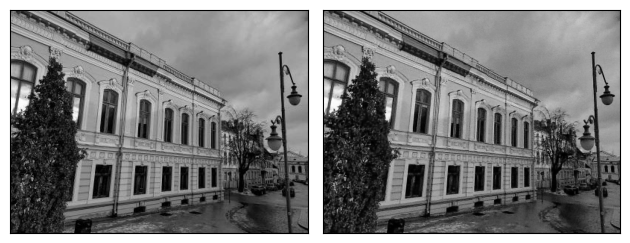

iteration [1226/4000], Loss: 0.0006530872778967023
iteration [1227/4000], Loss: 0.0006250222795642912
iteration [1228/4000], Loss: 0.000574102159589529
iteration [1229/4000], Loss: 0.0005879924283362925
iteration [1230/4000], Loss: 0.0005991648649796844
iteration [1231/4000], Loss: 0.0005659069283865392
iteration [1232/4000], Loss: 0.0005560069112107158
iteration [1233/4000], Loss: 0.0005606465856544673
iteration [1234/4000], Loss: 0.0005431382451206446
iteration [1235/4000], Loss: 0.0005433005280792713
iteration [1236/4000], Loss: 0.0005249882233329117
iteration [1237/4000], Loss: 0.0005284030339680612
iteration [1238/4000], Loss: 0.0005440712557174265
iteration [1239/4000], Loss: 0.0005342786316759884
iteration [1240/4000], Loss: 0.0005391478189267218
iteration [1241/4000], Loss: 0.0005829835426993668
iteration [1242/4000], Loss: 0.0006713384063914418
iteration [1243/4000], Loss: 0.0007752188248559833
iteration [1244/4000], Loss: 0.0009107780060730875
iteration [1245/4000], Loss: 0.0

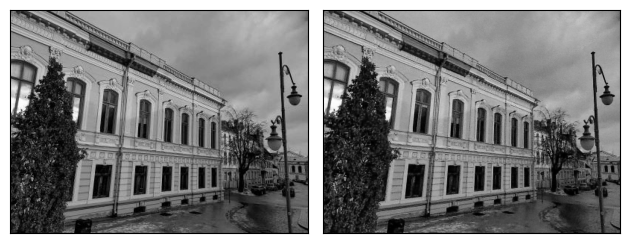

iteration [1251/4000], Loss: 0.0006379240658134222
iteration [1252/4000], Loss: 0.0007420178735628724
iteration [1253/4000], Loss: 0.0006275737541727722
iteration [1254/4000], Loss: 0.0006320584216155112
iteration [1255/4000], Loss: 0.0006755656213499606
iteration [1256/4000], Loss: 0.0005903274868614972
iteration [1257/4000], Loss: 0.0006377539248205721
iteration [1258/4000], Loss: 0.000628449663054198
iteration [1259/4000], Loss: 0.0005816739285364747
iteration [1260/4000], Loss: 0.0006223456002771854
iteration [1261/4000], Loss: 0.0005960699636489153
iteration [1262/4000], Loss: 0.0005798027268610895
iteration [1263/4000], Loss: 0.0005829628207720816
iteration [1264/4000], Loss: 0.0005719252512790263
iteration [1265/4000], Loss: 0.0005573936505243182
iteration [1266/4000], Loss: 0.0005365986144170165
iteration [1267/4000], Loss: 0.0005530441994778812
iteration [1268/4000], Loss: 0.0005307247629389167
iteration [1269/4000], Loss: 0.0005216261488385499
iteration [1270/4000], Loss: 0.0

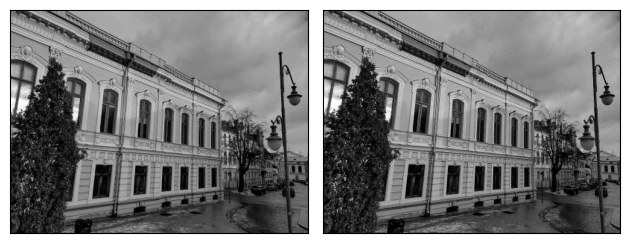

iteration [1276/4000], Loss: 0.0004917415790259838
iteration [1277/4000], Loss: 0.0005016376962885261
iteration [1278/4000], Loss: 0.0005362211959436536
iteration [1279/4000], Loss: 0.0005851975874975324
iteration [1280/4000], Loss: 0.0006606404785998166
iteration [1281/4000], Loss: 0.0007900525233708322
iteration [1282/4000], Loss: 0.0007044799858704209
iteration [1283/4000], Loss: 0.0006236792542040348
iteration [1284/4000], Loss: 0.0005867964355275035
iteration [1285/4000], Loss: 0.0006544319330714643
iteration [1286/4000], Loss: 0.0006688860012218356
iteration [1287/4000], Loss: 0.000600456609390676
iteration [1288/4000], Loss: 0.0006459654541686177
iteration [1289/4000], Loss: 0.0006138649769127369
iteration [1290/4000], Loss: 0.0006036653649061918
iteration [1291/4000], Loss: 0.0005823946557939053
iteration [1292/4000], Loss: 0.0005441567627713084
iteration [1293/4000], Loss: 0.0005468723829835653
iteration [1294/4000], Loss: 0.0005350056453607976
iteration [1295/4000], Loss: 0.0

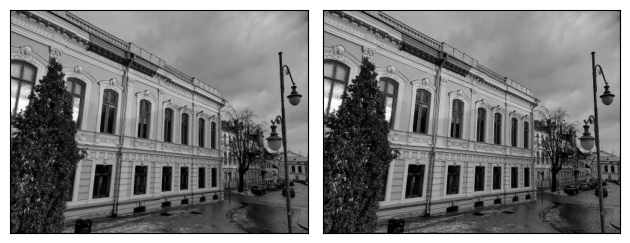

iteration [1301/4000], Loss: 0.0005272901034913957
iteration [1302/4000], Loss: 0.0005468445015139878
iteration [1303/4000], Loss: 0.000569968658965081
iteration [1304/4000], Loss: 0.0005705319927074015
iteration [1305/4000], Loss: 0.0005961067508906126
iteration [1306/4000], Loss: 0.0005972133949398994
iteration [1307/4000], Loss: 0.000554726691916585
iteration [1308/4000], Loss: 0.000537585117854178
iteration [1309/4000], Loss: 0.0005525629385374486
iteration [1310/4000], Loss: 0.0005936049856245518
iteration [1311/4000], Loss: 0.0006313700578175485
iteration [1312/4000], Loss: 0.0006736200884915888
iteration [1313/4000], Loss: 0.0005959280533716083
iteration [1314/4000], Loss: 0.000525235605891794
iteration [1315/4000], Loss: 0.0005061934934929013
iteration [1316/4000], Loss: 0.0005359451752156019
iteration [1317/4000], Loss: 0.0005980572896078229
iteration [1318/4000], Loss: 0.0005629198276437819
iteration [1319/4000], Loss: 0.0005358750931918621
iteration [1320/4000], Loss: 0.0005

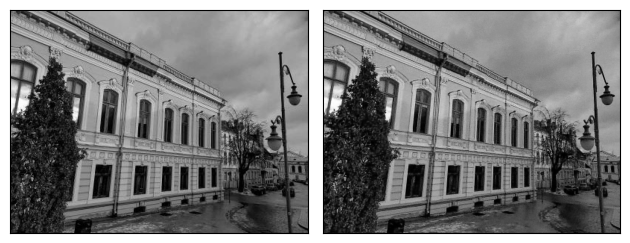

iteration [1326/4000], Loss: 0.0005129898199811578
iteration [1327/4000], Loss: 0.0005057185771875083
iteration [1328/4000], Loss: 0.0004904912202619016
iteration [1329/4000], Loss: 0.0004921687068417668
iteration [1330/4000], Loss: 0.0005221018800511956
iteration [1331/4000], Loss: 0.0005126030882820487
iteration [1332/4000], Loss: 0.000499014335218817
iteration [1333/4000], Loss: 0.0004898080951534212
iteration [1334/4000], Loss: 0.0005091680213809013
iteration [1335/4000], Loss: 0.0005378511850722134
iteration [1336/4000], Loss: 0.0005329132545739412
iteration [1337/4000], Loss: 0.0005401193047873676
iteration [1338/4000], Loss: 0.0005325778038240969
iteration [1339/4000], Loss: 0.0005431678146123886
iteration [1340/4000], Loss: 0.0005643619224429131
iteration [1341/4000], Loss: 0.0005947231547906995
iteration [1342/4000], Loss: 0.000576023303437978
iteration [1343/4000], Loss: 0.0005643732147291303
iteration [1344/4000], Loss: 0.0005237017758190632
iteration [1345/4000], Loss: 0.00

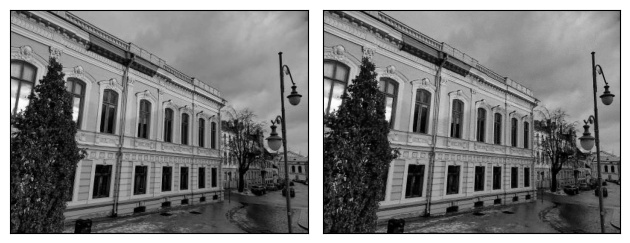

iteration [1351/4000], Loss: 0.00047596023068763316
iteration [1352/4000], Loss: 0.0004630297189578414
iteration [1353/4000], Loss: 0.00048011980834417045
iteration [1354/4000], Loss: 0.0004779525042977184
iteration [1355/4000], Loss: 0.00047900996287353337
iteration [1356/4000], Loss: 0.0004821203474421054
iteration [1357/4000], Loss: 0.0004948698915541172
iteration [1358/4000], Loss: 0.0005408651777543128
iteration [1359/4000], Loss: 0.000578621809836477
iteration [1360/4000], Loss: 0.0006437839474529028
iteration [1361/4000], Loss: 0.000644568121060729
iteration [1362/4000], Loss: 0.0006081883329898119
iteration [1363/4000], Loss: 0.0005129307974129915
iteration [1364/4000], Loss: 0.000496125256177038
iteration [1365/4000], Loss: 0.0005634306580759585
iteration [1366/4000], Loss: 0.000571903248783201
iteration [1367/4000], Loss: 0.0005327194230630994
iteration [1368/4000], Loss: 0.0005028930027037859
iteration [1369/4000], Loss: 0.00048406366840936244
iteration [1370/4000], Loss: 0.

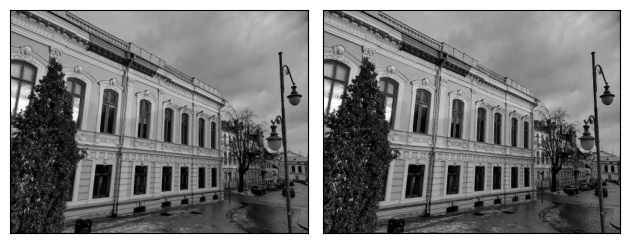

iteration [1376/4000], Loss: 0.0006204736419022083
iteration [1377/4000], Loss: 0.0005670702666975558
iteration [1378/4000], Loss: 0.0005303855868987739
iteration [1379/4000], Loss: 0.0005232690018601716
iteration [1380/4000], Loss: 0.0005047651357017457
iteration [1381/4000], Loss: 0.0004987598513253033
iteration [1382/4000], Loss: 0.0005341742071323097
iteration [1383/4000], Loss: 0.0004873662255704403
iteration [1384/4000], Loss: 0.0004831917758565396
iteration [1385/4000], Loss: 0.00048434437485411763
iteration [1386/4000], Loss: 0.00047182204434648156
iteration [1387/4000], Loss: 0.0004726717306766659
iteration [1388/4000], Loss: 0.0004798250156454742
iteration [1389/4000], Loss: 0.000476074346806854
iteration [1390/4000], Loss: 0.00046837495756335557
iteration [1391/4000], Loss: 0.00044448566040955484
iteration [1392/4000], Loss: 0.0004550669400487095
iteration [1393/4000], Loss: 0.00045588999637402594
iteration [1394/4000], Loss: 0.0004499887872952968
iteration [1395/4000], Loss

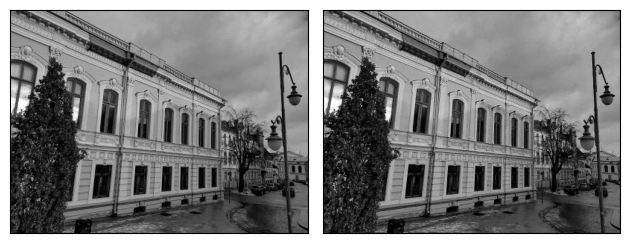

iteration [1401/4000], Loss: 0.0005010209861211479
iteration [1402/4000], Loss: 0.0005242830375209451
iteration [1403/4000], Loss: 0.000610044808126986
iteration [1404/4000], Loss: 0.0006667224806733429
iteration [1405/4000], Loss: 0.0007416241569444537
iteration [1406/4000], Loss: 0.0005825781845487654
iteration [1407/4000], Loss: 0.0005855889758095145
iteration [1408/4000], Loss: 0.0006323722773231566
iteration [1409/4000], Loss: 0.0005748135736212134
iteration [1410/4000], Loss: 0.0005448997835628688
iteration [1411/4000], Loss: 0.000549514836166054
iteration [1412/4000], Loss: 0.0005110391066409647
iteration [1413/4000], Loss: 0.000504109775647521
iteration [1414/4000], Loss: 0.0005139681743457913
iteration [1415/4000], Loss: 0.0004923719679936767
iteration [1416/4000], Loss: 0.00048462252016179264
iteration [1417/4000], Loss: 0.0004658887046389282
iteration [1418/4000], Loss: 0.0004547133285086602
iteration [1419/4000], Loss: 0.000449342536740005
iteration [1420/4000], Loss: 0.000

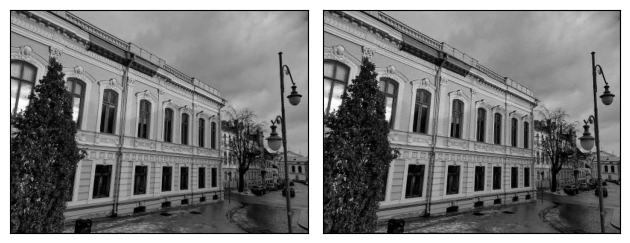

iteration [1426/4000], Loss: 0.0004211630439385772
iteration [1427/4000], Loss: 0.0004289310600142926
iteration [1428/4000], Loss: 0.00042924354784190655
iteration [1429/4000], Loss: 0.0004852918500546366
iteration [1430/4000], Loss: 0.0005076355882920325
iteration [1431/4000], Loss: 0.0005877086659893394
iteration [1432/4000], Loss: 0.0005459042149595916
iteration [1433/4000], Loss: 0.0005448940210044384
iteration [1434/4000], Loss: 0.0004941867664456367
iteration [1435/4000], Loss: 0.0005407045828178525
iteration [1436/4000], Loss: 0.0006311115575954318
iteration [1437/4000], Loss: 0.0006014135433360934
iteration [1438/4000], Loss: 0.0005846946150995791
iteration [1439/4000], Loss: 0.0005195691483095288
iteration [1440/4000], Loss: 0.0005553953815251589
iteration [1441/4000], Loss: 0.000652441696729511
iteration [1442/4000], Loss: 0.000561022199690342
iteration [1443/4000], Loss: 0.0005427131545729935
iteration [1444/4000], Loss: 0.0005707908421754837
iteration [1445/4000], Loss: 0.0

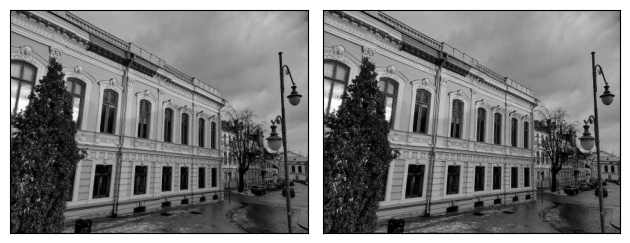

iteration [1451/4000], Loss: 0.0004857805906794965
iteration [1452/4000], Loss: 0.0004844499926548451
iteration [1453/4000], Loss: 0.0004892077413387597
iteration [1454/4000], Loss: 0.0004980321391485631
iteration [1455/4000], Loss: 0.0005165237816981971
iteration [1456/4000], Loss: 0.0005140260909684002
iteration [1457/4000], Loss: 0.000466814759420231
iteration [1458/4000], Loss: 0.0004498485359363258
iteration [1459/4000], Loss: 0.0004498491471167654
iteration [1460/4000], Loss: 0.000419869291363284
iteration [1461/4000], Loss: 0.0004175843787379563
iteration [1462/4000], Loss: 0.00043506920337677
iteration [1463/4000], Loss: 0.00042656916775740683
iteration [1464/4000], Loss: 0.0004206789017189294
iteration [1465/4000], Loss: 0.00041639074333943427
iteration [1466/4000], Loss: 0.00041953279287554324
iteration [1467/4000], Loss: 0.00042045381269417703
iteration [1468/4000], Loss: 0.0004278615233488381
iteration [1469/4000], Loss: 0.00045077147660776973
iteration [1470/4000], Loss: 0

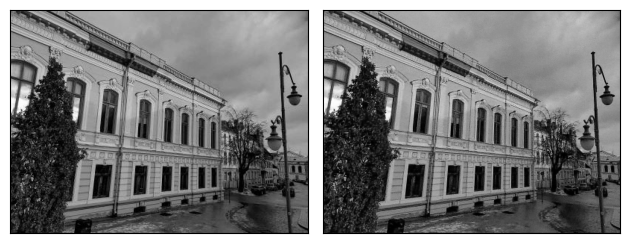

iteration [1476/4000], Loss: 0.000457619724329561
iteration [1477/4000], Loss: 0.00047278142301365733
iteration [1478/4000], Loss: 0.0004889908595941961
iteration [1479/4000], Loss: 0.0004973422619514167
iteration [1480/4000], Loss: 0.0004965090774931014
iteration [1481/4000], Loss: 0.0005525996093638241
iteration [1482/4000], Loss: 0.0006065153866074979
iteration [1483/4000], Loss: 0.0006638566264882684
iteration [1484/4000], Loss: 0.0006123124621808529
iteration [1485/4000], Loss: 0.0004981167730875313
iteration [1486/4000], Loss: 0.000536796695087105
iteration [1487/4000], Loss: 0.00054362160153687
iteration [1488/4000], Loss: 0.0005102913710288703
iteration [1489/4000], Loss: 0.0004575368657242507
iteration [1490/4000], Loss: 0.0005030109314247966
iteration [1491/4000], Loss: 0.0004752814129460603
iteration [1492/4000], Loss: 0.00040936324512586
iteration [1493/4000], Loss: 0.00042777552152983844
iteration [1494/4000], Loss: 0.0004384467611089349
iteration [1495/4000], Loss: 0.0004

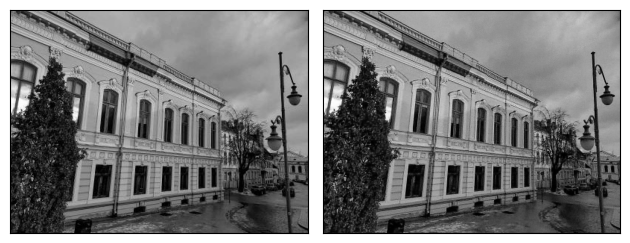

iteration [1501/4000], Loss: 0.00039118301356211305
iteration [1502/4000], Loss: 0.00038650628994219005
iteration [1503/4000], Loss: 0.0003750910982489586
iteration [1504/4000], Loss: 0.00037327493191696703
iteration [1505/4000], Loss: 0.00038373973802663386
iteration [1506/4000], Loss: 0.0003925939090549946
iteration [1507/4000], Loss: 0.0004104639810975641
iteration [1508/4000], Loss: 0.00043670134618878365
iteration [1509/4000], Loss: 0.0005172574892640114
iteration [1510/4000], Loss: 0.0005696693551726639
iteration [1511/4000], Loss: 0.0006431493675336242
iteration [1512/4000], Loss: 0.0005842747632414103
iteration [1513/4000], Loss: 0.0004934877506457269
iteration [1514/4000], Loss: 0.0004796540888492018
iteration [1515/4000], Loss: 0.0005195897538214922
iteration [1516/4000], Loss: 0.000610433635301888
iteration [1517/4000], Loss: 0.0004780488379765302
iteration [1518/4000], Loss: 0.0004496276960708201
iteration [1519/4000], Loss: 0.0005572598311118782
iteration [1520/4000], Loss

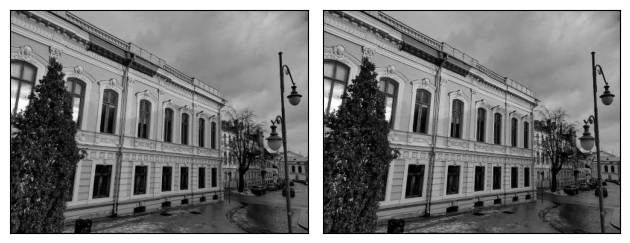

iteration [1526/4000], Loss: 0.00042774391476996243
iteration [1527/4000], Loss: 0.00041580258402973413
iteration [1528/4000], Loss: 0.00040716235525906086
iteration [1529/4000], Loss: 0.00040476530557498336
iteration [1530/4000], Loss: 0.00040909144445322454
iteration [1531/4000], Loss: 0.0004089255817234516
iteration [1532/4000], Loss: 0.00040756716043688357
iteration [1533/4000], Loss: 0.00040631345473229885
iteration [1534/4000], Loss: 0.000423935882281512
iteration [1535/4000], Loss: 0.0004374725394882262
iteration [1536/4000], Loss: 0.0004296771949157119
iteration [1537/4000], Loss: 0.0004404035862535238
iteration [1538/4000], Loss: 0.00045457022497430444
iteration [1539/4000], Loss: 0.00045979805872775614
iteration [1540/4000], Loss: 0.0004638363025151193
iteration [1541/4000], Loss: 0.0004566931747831404
iteration [1542/4000], Loss: 0.0004543220857158303
iteration [1543/4000], Loss: 0.0004669085901696235
iteration [1544/4000], Loss: 0.0004249515477567911
iteration [1545/4000], 

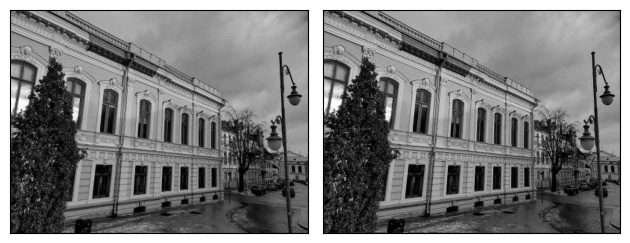

iteration [1551/4000], Loss: 0.0004119139921385795
iteration [1552/4000], Loss: 0.00040566190727986395
iteration [1553/4000], Loss: 0.0004097511700820178
iteration [1554/4000], Loss: 0.00038398077595047653
iteration [1555/4000], Loss: 0.0004029966366942972
iteration [1556/4000], Loss: 0.0004249573976267129
iteration [1557/4000], Loss: 0.0004301636654417962
iteration [1558/4000], Loss: 0.0004065031826030463
iteration [1559/4000], Loss: 0.0004083674284629524
iteration [1560/4000], Loss: 0.0004197987145744264
iteration [1561/4000], Loss: 0.0004428613174241036
iteration [1562/4000], Loss: 0.0003986951778642833
iteration [1563/4000], Loss: 0.00039172699325717986
iteration [1564/4000], Loss: 0.00041343053453601897
iteration [1565/4000], Loss: 0.0004036944010294974
iteration [1566/4000], Loss: 0.0003980494220741093
iteration [1567/4000], Loss: 0.0003810079942923039
iteration [1568/4000], Loss: 0.00039932990330271423
iteration [1569/4000], Loss: 0.0004152644833084196
iteration [1570/4000], Los

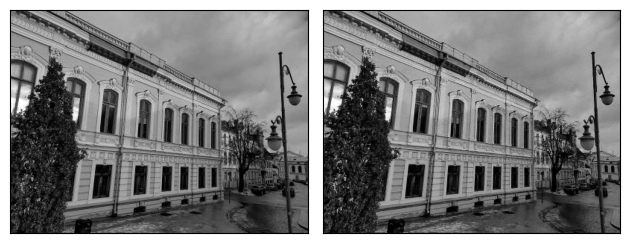

iteration [1576/4000], Loss: 0.000537740474101156
iteration [1577/4000], Loss: 0.0005687113734893501
iteration [1578/4000], Loss: 0.0004617077938746661
iteration [1579/4000], Loss: 0.00048178769065998495
iteration [1580/4000], Loss: 0.0005091519560664892
iteration [1581/4000], Loss: 0.0004359134181868285
iteration [1582/4000], Loss: 0.0004702820151578635
iteration [1583/4000], Loss: 0.00044400032493285835
iteration [1584/4000], Loss: 0.0004084859392605722
iteration [1585/4000], Loss: 0.0004277914122212678
iteration [1586/4000], Loss: 0.00039424290298484266
iteration [1587/4000], Loss: 0.0003960198082495481
iteration [1588/4000], Loss: 0.0004019768675789237
iteration [1589/4000], Loss: 0.0003670544538181275
iteration [1590/4000], Loss: 0.0003782418498303741
iteration [1591/4000], Loss: 0.00037099342443980277
iteration [1592/4000], Loss: 0.0003492866235319525
iteration [1593/4000], Loss: 0.00036190400714986026
iteration [1594/4000], Loss: 0.00035253530950285494
iteration [1595/4000], Los

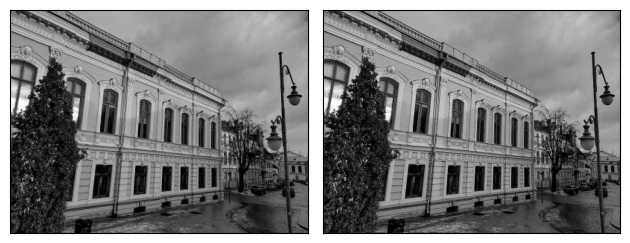

iteration [1601/4000], Loss: 0.0004110884910915047
iteration [1602/4000], Loss: 0.0004973619943484664
iteration [1603/4000], Loss: 0.0006747268489561975
iteration [1604/4000], Loss: 0.000777275359723717
iteration [1605/4000], Loss: 0.0008160109864547849
iteration [1606/4000], Loss: 0.0006619244813919067
iteration [1607/4000], Loss: 0.0007568766595795751
iteration [1608/4000], Loss: 0.0008770935237407684
iteration [1609/4000], Loss: 0.0005531977512873709
iteration [1610/4000], Loss: 0.0007084285607561469
iteration [1611/4000], Loss: 0.0006542509654536843
iteration [1612/4000], Loss: 0.000624565058387816
iteration [1613/4000], Loss: 0.0007019457407295704
iteration [1614/4000], Loss: 0.0005589547799900174
iteration [1615/4000], Loss: 0.0006152423447929323
iteration [1616/4000], Loss: 0.0005474899080581963
iteration [1617/4000], Loss: 0.0005297820316627622
iteration [1618/4000], Loss: 0.0005002445541322231
iteration [1619/4000], Loss: 0.0004965587868355215
iteration [1620/4000], Loss: 0.00

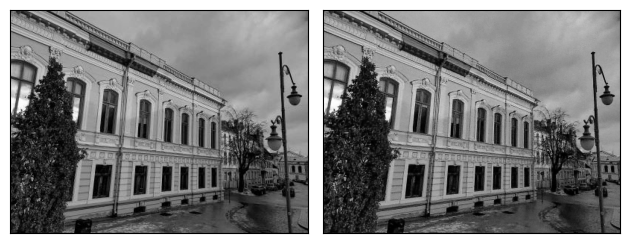

iteration [1626/4000], Loss: 0.00039499832200817764
iteration [1627/4000], Loss: 0.00038358199526555836
iteration [1628/4000], Loss: 0.0003804450388997793
iteration [1629/4000], Loss: 0.00036954262759536505
iteration [1630/4000], Loss: 0.0003614678862504661
iteration [1631/4000], Loss: 0.0003562625788617879
iteration [1632/4000], Loss: 0.00035152054624632
iteration [1633/4000], Loss: 0.0003455265541560948
iteration [1634/4000], Loss: 0.00034082832280546427
iteration [1635/4000], Loss: 0.00033702253131195903
iteration [1636/4000], Loss: 0.000331827555783093
iteration [1637/4000], Loss: 0.0003285818675067276
iteration [1638/4000], Loss: 0.00032626933534629643
iteration [1639/4000], Loss: 0.00032514409394934773
iteration [1640/4000], Loss: 0.00032869650749489665
iteration [1641/4000], Loss: 0.00033531285589560866
iteration [1642/4000], Loss: 0.0003546496154740453
iteration [1643/4000], Loss: 0.00038971882895566523
iteration [1644/4000], Loss: 0.0004693763912655413
iteration [1645/4000], L

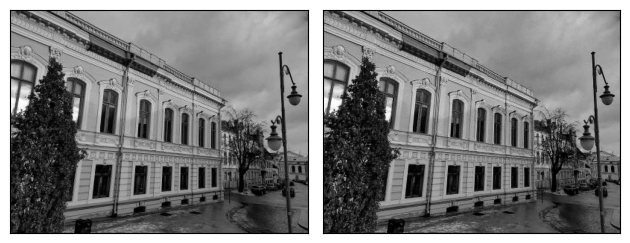

iteration [1651/4000], Loss: 0.0004644354630727321
iteration [1652/4000], Loss: 0.0003824059967882931
iteration [1653/4000], Loss: 0.0003862129815388471
iteration [1654/4000], Loss: 0.0004652934439945966
iteration [1655/4000], Loss: 0.00039346894482150674
iteration [1656/4000], Loss: 0.000361781072570011
iteration [1657/4000], Loss: 0.0004189683822914958
iteration [1658/4000], Loss: 0.00037140308995731175
iteration [1659/4000], Loss: 0.0003471937670838088
iteration [1660/4000], Loss: 0.0003709979937411845
iteration [1661/4000], Loss: 0.0003536987351253629
iteration [1662/4000], Loss: 0.00033607808290980756
iteration [1663/4000], Loss: 0.0003347551391925663
iteration [1664/4000], Loss: 0.0003399083507247269
iteration [1665/4000], Loss: 0.0003386617754586041
iteration [1666/4000], Loss: 0.0003193214943166822
iteration [1667/4000], Loss: 0.0003234283358324319
iteration [1668/4000], Loss: 0.0003430948418099433
iteration [1669/4000], Loss: 0.00033510150387883186
iteration [1670/4000], Loss:

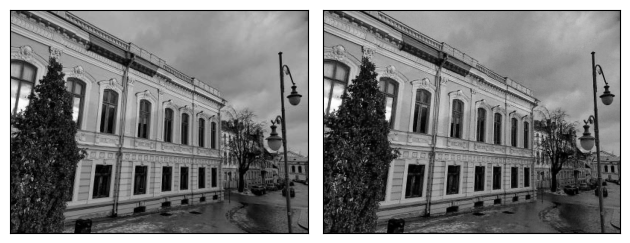

iteration [1676/4000], Loss: 0.0005015608621761203
iteration [1677/4000], Loss: 0.0005262630875222385
iteration [1678/4000], Loss: 0.0005943015567027032
iteration [1679/4000], Loss: 0.0006711545865982771
iteration [1680/4000], Loss: 0.00047178991371765733
iteration [1681/4000], Loss: 0.000472498795716092
iteration [1682/4000], Loss: 0.000597330101300031
iteration [1683/4000], Loss: 0.0004349855298642069
iteration [1684/4000], Loss: 0.0004701901925727725
iteration [1685/4000], Loss: 0.0005271541303955019
iteration [1686/4000], Loss: 0.0004176653455942869
iteration [1687/4000], Loss: 0.0004858838801737875
iteration [1688/4000], Loss: 0.0004228287434671074
iteration [1689/4000], Loss: 0.00040685111889615655
iteration [1690/4000], Loss: 0.0004515072505455464
iteration [1691/4000], Loss: 0.00036336155608296394
iteration [1692/4000], Loss: 0.0004067685513291508
iteration [1693/4000], Loss: 0.000378169963369146
iteration [1694/4000], Loss: 0.00035942517570219934
iteration [1695/4000], Loss: 0

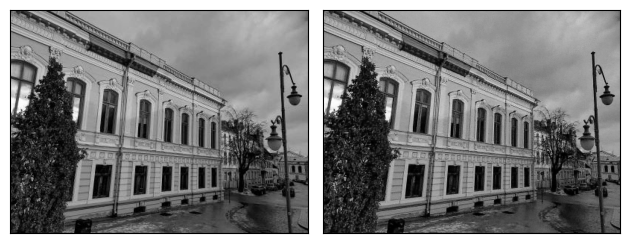

iteration [1701/4000], Loss: 0.00031339703127741814
iteration [1702/4000], Loss: 0.00032782898051664233
iteration [1703/4000], Loss: 0.00031208028667606413
iteration [1704/4000], Loss: 0.00030493552912957966
iteration [1705/4000], Loss: 0.00030846489244140685
iteration [1706/4000], Loss: 0.00029821816133335233
iteration [1707/4000], Loss: 0.00030576970311813056
iteration [1708/4000], Loss: 0.0003033320826943964
iteration [1709/4000], Loss: 0.00030833514756523073
iteration [1710/4000], Loss: 0.000334074575221166
iteration [1711/4000], Loss: 0.00037822857848368585
iteration [1712/4000], Loss: 0.0004856750601902604
iteration [1713/4000], Loss: 0.0005448066513054073
iteration [1714/4000], Loss: 0.0005196858546696603
iteration [1715/4000], Loss: 0.00038638903060927987
iteration [1716/4000], Loss: 0.00037743631401099265
iteration [1717/4000], Loss: 0.00046785830636508763
iteration [1718/4000], Loss: 0.00042577419662848115
iteration [1719/4000], Loss: 0.000357737357262522
iteration [1720/4000

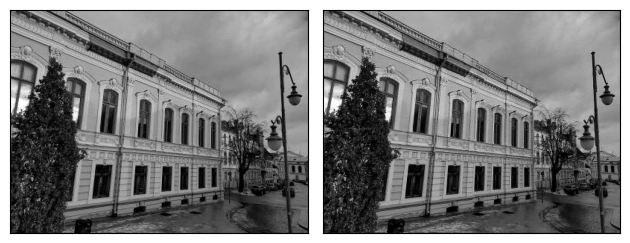

iteration [1726/4000], Loss: 0.00041760873864404857
iteration [1727/4000], Loss: 0.00044803484342992306
iteration [1728/4000], Loss: 0.00045803948887623847
iteration [1729/4000], Loss: 0.0004446074308361858
iteration [1730/4000], Loss: 0.00041565526043996215
iteration [1731/4000], Loss: 0.00038456107722595334
iteration [1732/4000], Loss: 0.00034738844260573387
iteration [1733/4000], Loss: 0.0003436412662267685
iteration [1734/4000], Loss: 0.0003575635200832039
iteration [1735/4000], Loss: 0.0003561684279702604
iteration [1736/4000], Loss: 0.00034503042115829885
iteration [1737/4000], Loss: 0.0003335032088216394
iteration [1738/4000], Loss: 0.00032896664924919605
iteration [1739/4000], Loss: 0.00031348978518508375
iteration [1740/4000], Loss: 0.0003050287195947021
iteration [1741/4000], Loss: 0.00031896334257908165
iteration [1742/4000], Loss: 0.0003099995374213904
iteration [1743/4000], Loss: 0.0003036094713024795
iteration [1744/4000], Loss: 0.0003058711299672723
iteration [1745/4000]

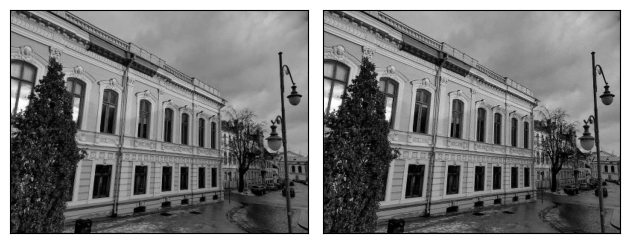

iteration [1751/4000], Loss: 0.0003372878418304026
iteration [1752/4000], Loss: 0.00035989907337352633
iteration [1753/4000], Loss: 0.0003665571566671133
iteration [1754/4000], Loss: 0.0003693652106449008
iteration [1755/4000], Loss: 0.0003558455209713429
iteration [1756/4000], Loss: 0.0003477927530184388
iteration [1757/4000], Loss: 0.0003557092568371445
iteration [1758/4000], Loss: 0.0003589223779272288
iteration [1759/4000], Loss: 0.00038014809251762927
iteration [1760/4000], Loss: 0.00037645528209395707
iteration [1761/4000], Loss: 0.00037992227589711547
iteration [1762/4000], Loss: 0.0003801603161264211
iteration [1763/4000], Loss: 0.0004177199152763933
iteration [1764/4000], Loss: 0.00043218160863034427
iteration [1765/4000], Loss: 0.00040077531593851745
iteration [1766/4000], Loss: 0.0003766283334698528
iteration [1767/4000], Loss: 0.0003665944386739284
iteration [1768/4000], Loss: 0.0003645448596216738
iteration [1769/4000], Loss: 0.00034953534486703575
iteration [1770/4000], L

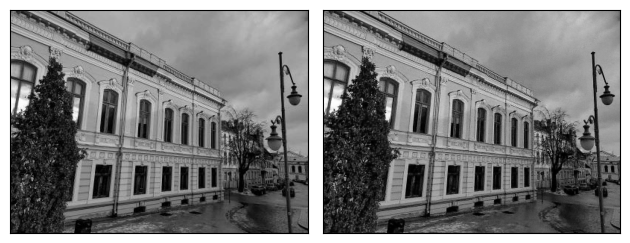

iteration [1776/4000], Loss: 0.0003847597981803119
iteration [1777/4000], Loss: 0.0003949268430005759
iteration [1778/4000], Loss: 0.0003539196914061904
iteration [1779/4000], Loss: 0.00033686120877973735
iteration [1780/4000], Loss: 0.00034840419539250433
iteration [1781/4000], Loss: 0.0003366365563124418
iteration [1782/4000], Loss: 0.000319813349051401
iteration [1783/4000], Loss: 0.000330121984006837
iteration [1784/4000], Loss: 0.0003165281959809363
iteration [1785/4000], Loss: 0.00030966897611506283
iteration [1786/4000], Loss: 0.0003185357782058418
iteration [1787/4000], Loss: 0.0003056979621760547
iteration [1788/4000], Loss: 0.00030259814229793847
iteration [1789/4000], Loss: 0.0002871793694794178
iteration [1790/4000], Loss: 0.00027943160966970026
iteration [1791/4000], Loss: 0.0002803992829285562
iteration [1792/4000], Loss: 0.0002833772450685501
iteration [1793/4000], Loss: 0.00028715250664390624
iteration [1794/4000], Loss: 0.000291215575998649
iteration [1795/4000], Loss:

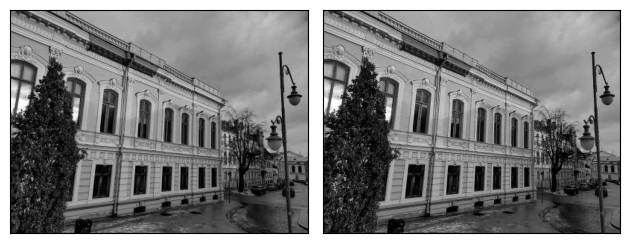

iteration [1801/4000], Loss: 0.0004756652924697846
iteration [1802/4000], Loss: 0.0004922614898532629
iteration [1803/4000], Loss: 0.0005550403147935867
iteration [1804/4000], Loss: 0.0006261517992243171
iteration [1805/4000], Loss: 0.0006249311263673007
iteration [1806/4000], Loss: 0.0005620263982564211
iteration [1807/4000], Loss: 0.0006933666300028563
iteration [1808/4000], Loss: 0.0005548626650124788
iteration [1809/4000], Loss: 0.00048206609790213406
iteration [1810/4000], Loss: 0.0005632610409520566
iteration [1811/4000], Loss: 0.0004648321191780269
iteration [1812/4000], Loss: 0.0004773822729475796
iteration [1813/4000], Loss: 0.00047301649465225637
iteration [1814/4000], Loss: 0.0004280084976926446
iteration [1815/4000], Loss: 0.000449004874099046
iteration [1816/4000], Loss: 0.0004010834381915629
iteration [1817/4000], Loss: 0.00039624475175514817
iteration [1818/4000], Loss: 0.00038919952930882573
iteration [1819/4000], Loss: 0.00036716056638397276
iteration [1820/4000], Loss

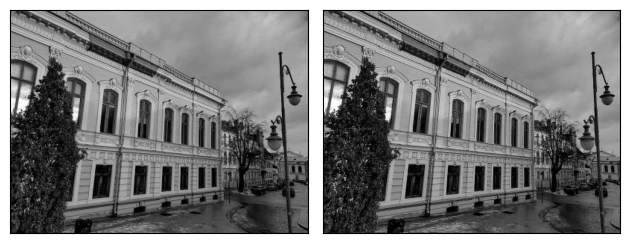

iteration [1826/4000], Loss: 0.0003060498565901071
iteration [1827/4000], Loss: 0.00030113133834674954
iteration [1828/4000], Loss: 0.0002955048985313624
iteration [1829/4000], Loss: 0.0002902612031903118
iteration [1830/4000], Loss: 0.0002844814443960786
iteration [1831/4000], Loss: 0.00027934828540310264
iteration [1832/4000], Loss: 0.00027528361533768475
iteration [1833/4000], Loss: 0.0002727485552895814
iteration [1834/4000], Loss: 0.0002667339285835624
iteration [1835/4000], Loss: 0.00026584710576571524
iteration [1836/4000], Loss: 0.0002619658480398357
iteration [1837/4000], Loss: 0.00025918742176145315
iteration [1838/4000], Loss: 0.0002581056614872068
iteration [1839/4000], Loss: 0.00025578291388228536
iteration [1840/4000], Loss: 0.00025706749875098467
iteration [1841/4000], Loss: 0.0002604084147606045
iteration [1842/4000], Loss: 0.00027384483837522566
iteration [1843/4000], Loss: 0.0003020317235495895
iteration [1844/4000], Loss: 0.00038052102900110185
iteration [1845/4000],

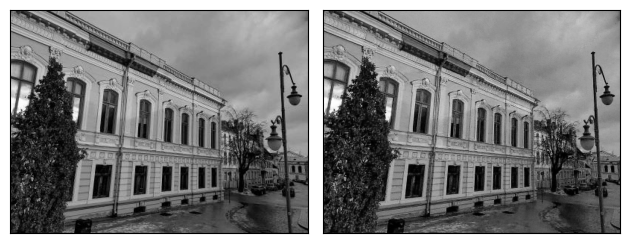

iteration [1851/4000], Loss: 0.0006905751652084291
iteration [1852/4000], Loss: 0.00039974486571736634
iteration [1853/4000], Loss: 0.0006113614072091877
iteration [1854/4000], Loss: 0.0006261238013394177
iteration [1855/4000], Loss: 0.00040387510671280324
iteration [1856/4000], Loss: 0.0006372691132128239
iteration [1857/4000], Loss: 0.0004485353420022875
iteration [1858/4000], Loss: 0.00047008992987684906
iteration [1859/4000], Loss: 0.000477162713650614
iteration [1860/4000], Loss: 0.00037705490831285715
iteration [1861/4000], Loss: 0.0004518665955401957
iteration [1862/4000], Loss: 0.00033909035846590996
iteration [1863/4000], Loss: 0.00042031609336845577
iteration [1864/4000], Loss: 0.0003525693609844893
iteration [1865/4000], Loss: 0.00035721310996450484
iteration [1866/4000], Loss: 0.0003592065186239779
iteration [1867/4000], Loss: 0.0003155557787977159
iteration [1868/4000], Loss: 0.000347501365467906
iteration [1869/4000], Loss: 0.00030101664015091956
iteration [1870/4000], Lo

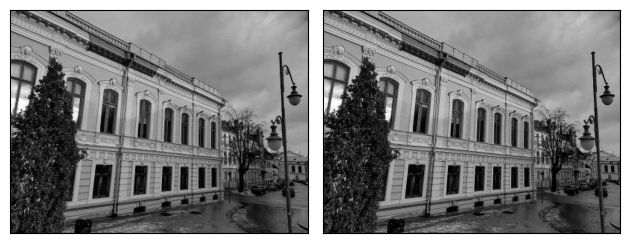

iteration [1876/4000], Loss: 0.00027438055258244276
iteration [1877/4000], Loss: 0.00027226455858908594
iteration [1878/4000], Loss: 0.00026982720009982586
iteration [1879/4000], Loss: 0.00026206622715108097
iteration [1880/4000], Loss: 0.000261348468484357
iteration [1881/4000], Loss: 0.00025825444026850164
iteration [1882/4000], Loss: 0.0002537827240303159
iteration [1883/4000], Loss: 0.0002552104997448623
iteration [1884/4000], Loss: 0.0002533032966312021
iteration [1885/4000], Loss: 0.000253685429925099
iteration [1886/4000], Loss: 0.0002605584741104394
iteration [1887/4000], Loss: 0.00027693045558407903
iteration [1888/4000], Loss: 0.00030259889899753034
iteration [1889/4000], Loss: 0.00037561162025667727
iteration [1890/4000], Loss: 0.0004098101344425231
iteration [1891/4000], Loss: 0.00046772678615525365
iteration [1892/4000], Loss: 0.00033124364563263953
iteration [1893/4000], Loss: 0.0002785807300824672
iteration [1894/4000], Loss: 0.00033847978920675814
iteration [1895/4000],

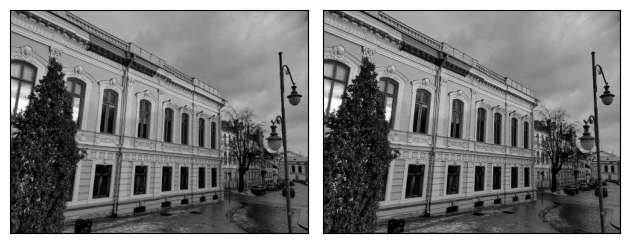

iteration [1901/4000], Loss: 0.00029789478867314756
iteration [1902/4000], Loss: 0.0003379126137588173
iteration [1903/4000], Loss: 0.00035255964030511677
iteration [1904/4000], Loss: 0.0003379720728844404
iteration [1905/4000], Loss: 0.00036182263283990324
iteration [1906/4000], Loss: 0.0003977488959208131
iteration [1907/4000], Loss: 0.0003833379887510091
iteration [1908/4000], Loss: 0.0003399153065402061
iteration [1909/4000], Loss: 0.0003468417562544346
iteration [1910/4000], Loss: 0.000347513152519241
iteration [1911/4000], Loss: 0.0003212221199646592
iteration [1912/4000], Loss: 0.00032459120848216116
iteration [1913/4000], Loss: 0.00031529684201814234
iteration [1914/4000], Loss: 0.0002838750369846821
iteration [1915/4000], Loss: 0.0002872557961381972
iteration [1916/4000], Loss: 0.00029474488110281527
iteration [1917/4000], Loss: 0.00028133526211604476
iteration [1918/4000], Loss: 0.0002736680908128619
iteration [1919/4000], Loss: 0.0002715716836974025
iteration [1920/4000], Lo

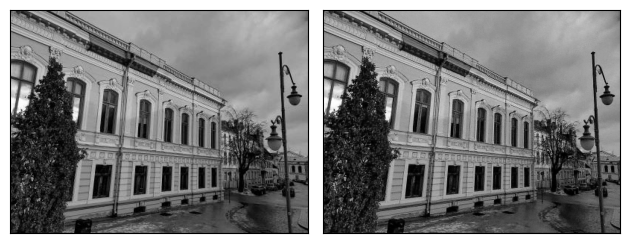

iteration [1926/4000], Loss: 0.00024380124523304403
iteration [1927/4000], Loss: 0.0002432298060739413
iteration [1928/4000], Loss: 0.0002557531697675586
iteration [1929/4000], Loss: 0.0002758536720648408
iteration [1930/4000], Loss: 0.0002892805787269026
iteration [1931/4000], Loss: 0.00033715253812260926
iteration [1932/4000], Loss: 0.00038022437365725636
iteration [1933/4000], Loss: 0.00044160717516206205
iteration [1934/4000], Loss: 0.000431221560575068
iteration [1935/4000], Loss: 0.0004163063713349402
iteration [1936/4000], Loss: 0.00041016016621142626
iteration [1937/4000], Loss: 0.00046147455577738583
iteration [1938/4000], Loss: 0.0005265672225505114
iteration [1939/4000], Loss: 0.00039978791028261185
iteration [1940/4000], Loss: 0.0003396429237909615
iteration [1941/4000], Loss: 0.0004392630362417549
iteration [1942/4000], Loss: 0.0004015764279756695
iteration [1943/4000], Loss: 0.00029962073313072324
iteration [1944/4000], Loss: 0.0003436650731600821
iteration [1945/4000], L

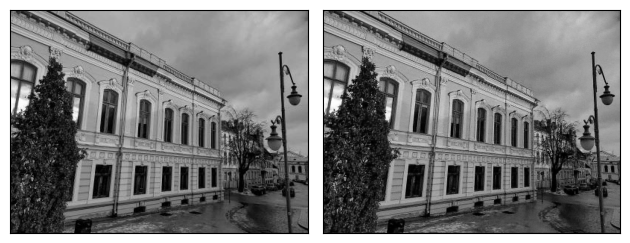

iteration [1951/4000], Loss: 0.00027793896151706576
iteration [1952/4000], Loss: 0.00026500484091229737
iteration [1953/4000], Loss: 0.00027117374702356756
iteration [1954/4000], Loss: 0.00025593439931981266
iteration [1955/4000], Loss: 0.0002548136399127543
iteration [1956/4000], Loss: 0.0002578635758254677
iteration [1957/4000], Loss: 0.0002515023807063699
iteration [1958/4000], Loss: 0.00025123966042883694
iteration [1959/4000], Loss: 0.000255477090831846
iteration [1960/4000], Loss: 0.0002587570925243199
iteration [1961/4000], Loss: 0.0002662989136297256
iteration [1962/4000], Loss: 0.00028451901744119823
iteration [1963/4000], Loss: 0.00031187813146971166
iteration [1964/4000], Loss: 0.0003441818989813328
iteration [1965/4000], Loss: 0.00036248969263397157
iteration [1966/4000], Loss: 0.00035468509304337204
iteration [1967/4000], Loss: 0.00030337233329191804
iteration [1968/4000], Loss: 0.000261584558757022
iteration [1969/4000], Loss: 0.0002632027317304164
iteration [1970/4000], 

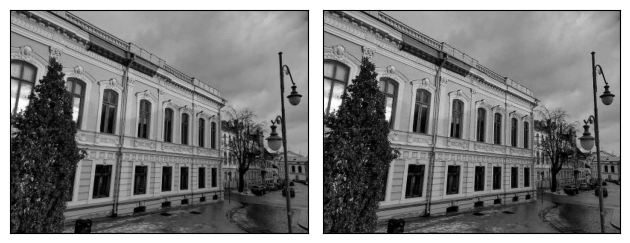

iteration [1976/4000], Loss: 0.0003486115310806781
iteration [1977/4000], Loss: 0.0003335023648105562
iteration [1978/4000], Loss: 0.0002938328543677926
iteration [1979/4000], Loss: 0.00028038781601935625
iteration [1980/4000], Loss: 0.000301385298371315
iteration [1981/4000], Loss: 0.0003291874018032104
iteration [1982/4000], Loss: 0.0003424113674554974
iteration [1983/4000], Loss: 0.000340651924489066
iteration [1984/4000], Loss: 0.0003562742786016315
iteration [1985/4000], Loss: 0.000341349485097453
iteration [1986/4000], Loss: 0.0002875776553992182
iteration [1987/4000], Loss: 0.0002651205286383629
iteration [1988/4000], Loss: 0.0002834494807757437
iteration [1989/4000], Loss: 0.00028351607033982873
iteration [1990/4000], Loss: 0.000261713401414454
iteration [1991/4000], Loss: 0.0002651755348779261
iteration [1992/4000], Loss: 0.00026818999322131276
iteration [1993/4000], Loss: 0.00024657929316163063
iteration [1994/4000], Loss: 0.00023947839508764446
iteration [1995/4000], Loss: 0

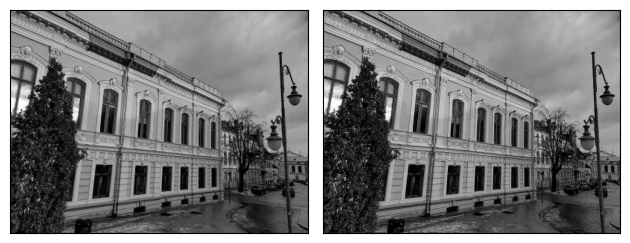

iteration [2001/4000], Loss: 0.00039308323175646365
iteration [2002/4000], Loss: 0.00040294125210493803
iteration [2003/4000], Loss: 0.0003651112783700228
iteration [2004/4000], Loss: 0.00032878544880077243
iteration [2005/4000], Loss: 0.00032760362955741584
iteration [2006/4000], Loss: 0.00036523299058899283
iteration [2007/4000], Loss: 0.00033959985012188554
iteration [2008/4000], Loss: 0.0002841546374838799
iteration [2009/4000], Loss: 0.00027848483296111226
iteration [2010/4000], Loss: 0.0003281906247138977
iteration [2011/4000], Loss: 0.000317416968755424
iteration [2012/4000], Loss: 0.00027185669750906527
iteration [2013/4000], Loss: 0.00027238394250161946
iteration [2014/4000], Loss: 0.0002874215133488178
iteration [2015/4000], Loss: 0.0002752917935140431
iteration [2016/4000], Loss: 0.0002583854366093874
iteration [2017/4000], Loss: 0.00025398327852599323
iteration [2018/4000], Loss: 0.0002660509489942342
iteration [2019/4000], Loss: 0.00026176124811172485
iteration [2020/4000]

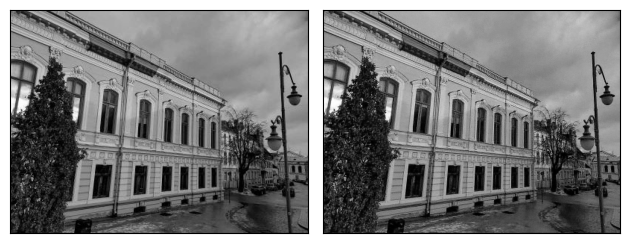

iteration [2026/4000], Loss: 0.00031324991141445935
iteration [2027/4000], Loss: 0.0003341939300298691
iteration [2028/4000], Loss: 0.00034254719503223896
iteration [2029/4000], Loss: 0.00033225840888917446
iteration [2030/4000], Loss: 0.00028595628100447357
iteration [2031/4000], Loss: 0.0002642571344040334
iteration [2032/4000], Loss: 0.000269267096882686
iteration [2033/4000], Loss: 0.00028493895661085844
iteration [2034/4000], Loss: 0.0002958906698040664
iteration [2035/4000], Loss: 0.00030735699692741036
iteration [2036/4000], Loss: 0.00028512650169432163
iteration [2037/4000], Loss: 0.0002613194228615612
iteration [2038/4000], Loss: 0.000250280078034848
iteration [2039/4000], Loss: 0.00025710646877996624
iteration [2040/4000], Loss: 0.0002612126700114459
iteration [2041/4000], Loss: 0.00026431464357301593
iteration [2042/4000], Loss: 0.0002597861457616091
iteration [2043/4000], Loss: 0.00024904945166781545
iteration [2044/4000], Loss: 0.0002655952121131122
iteration [2045/4000], 

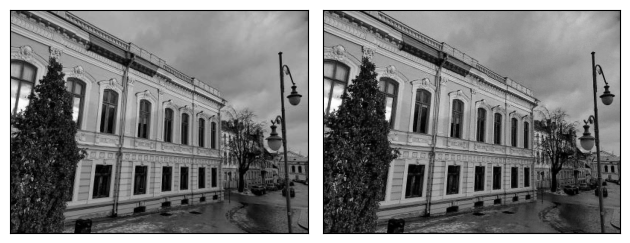

iteration [2051/4000], Loss: 0.00029488917789421976
iteration [2052/4000], Loss: 0.0002928917238023132
iteration [2053/4000], Loss: 0.00030660457559861243
iteration [2054/4000], Loss: 0.0002905988076236099
iteration [2055/4000], Loss: 0.00028391063096933067
iteration [2056/4000], Loss: 0.0002544705930631608
iteration [2057/4000], Loss: 0.00026578159304335713
iteration [2058/4000], Loss: 0.0002872739569284022
iteration [2059/4000], Loss: 0.0002605152840260416
iteration [2060/4000], Loss: 0.00024227012181654572
iteration [2061/4000], Loss: 0.0002465489087626338
iteration [2062/4000], Loss: 0.00024912552908062935
iteration [2063/4000], Loss: 0.0002669084642548114
iteration [2064/4000], Loss: 0.0002569069911260158
iteration [2065/4000], Loss: 0.000256731960689649
iteration [2066/4000], Loss: 0.0002735257730819285
iteration [2067/4000], Loss: 0.000310218776576221
iteration [2068/4000], Loss: 0.0003288398729637265
iteration [2069/4000], Loss: 0.00034658555523492396
iteration [2070/4000], Los

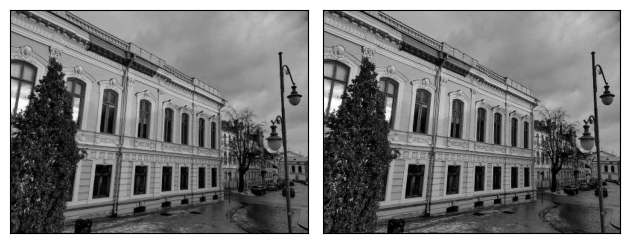

iteration [2076/4000], Loss: 0.00038967758882790804
iteration [2077/4000], Loss: 0.00031434191623702645
iteration [2078/4000], Loss: 0.00029813492437824607
iteration [2079/4000], Loss: 0.00032498702057637274
iteration [2080/4000], Loss: 0.0003076997818425298
iteration [2081/4000], Loss: 0.0002913241332862526
iteration [2082/4000], Loss: 0.0002643833286128938
iteration [2083/4000], Loss: 0.00028378068236634135
iteration [2084/4000], Loss: 0.0002796995686367154
iteration [2085/4000], Loss: 0.0002469508326612413
iteration [2086/4000], Loss: 0.00024079697323031723
iteration [2087/4000], Loss: 0.0002531011705286801
iteration [2088/4000], Loss: 0.0002434373600408435
iteration [2089/4000], Loss: 0.0002277277671964839
iteration [2090/4000], Loss: 0.00022760251886211336
iteration [2091/4000], Loss: 0.00023362295178230852
iteration [2092/4000], Loss: 0.0002301493368577212
iteration [2093/4000], Loss: 0.0002208525111200288
iteration [2094/4000], Loss: 0.00021853575890418142
iteration [2095/4000],

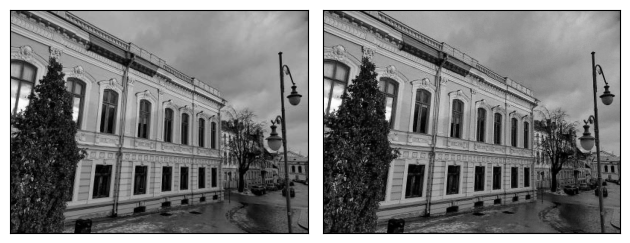

iteration [2101/4000], Loss: 0.0003376076347194612
iteration [2102/4000], Loss: 0.00036263736546970904
iteration [2103/4000], Loss: 0.0004140617966186255
iteration [2104/4000], Loss: 0.0003915353736374527
iteration [2105/4000], Loss: 0.00042533554369583726
iteration [2106/4000], Loss: 0.00044901962974108756
iteration [2107/4000], Loss: 0.00047142780385911465
iteration [2108/4000], Loss: 0.0004742592864204198
iteration [2109/4000], Loss: 0.00045807359856553376
iteration [2110/4000], Loss: 0.00046330844634212554
iteration [2111/4000], Loss: 0.00035702792229130864
iteration [2112/4000], Loss: 0.0003869251231662929
iteration [2113/4000], Loss: 0.00039667478995397687
iteration [2114/4000], Loss: 0.00028711179038509727
iteration [2115/4000], Loss: 0.0003469950461294502
iteration [2116/4000], Loss: 0.000330131413647905
iteration [2117/4000], Loss: 0.00027543416945263743
iteration [2118/4000], Loss: 0.000321759405778721
iteration [2119/4000], Loss: 0.0002771864819806069
iteration [2120/4000], 

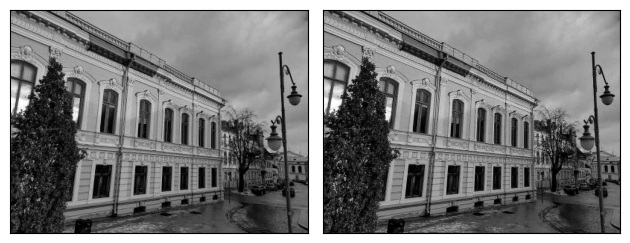

iteration [2126/4000], Loss: 0.00024322517856489867
iteration [2127/4000], Loss: 0.00022572923626285046
iteration [2128/4000], Loss: 0.0002298860636074096
iteration [2129/4000], Loss: 0.0002194507687818259
iteration [2130/4000], Loss: 0.00021796734654344618
iteration [2131/4000], Loss: 0.00021537406428251415
iteration [2132/4000], Loss: 0.00020869974105153233
iteration [2133/4000], Loss: 0.00021116991410963237
iteration [2134/4000], Loss: 0.00020512078481260687
iteration [2135/4000], Loss: 0.00020643573952838778
iteration [2136/4000], Loss: 0.00020750309340655804
iteration [2137/4000], Loss: 0.00021000197739340365
iteration [2138/4000], Loss: 0.00022221206745598465
iteration [2139/4000], Loss: 0.0002381752710789442
iteration [2140/4000], Loss: 0.0002712420537136495
iteration [2141/4000], Loss: 0.0003273754264228046
iteration [2142/4000], Loss: 0.0003963181225117296
iteration [2143/4000], Loss: 0.00045368430437520146
iteration [2144/4000], Loss: 0.00042855003266595304
iteration [2145/40

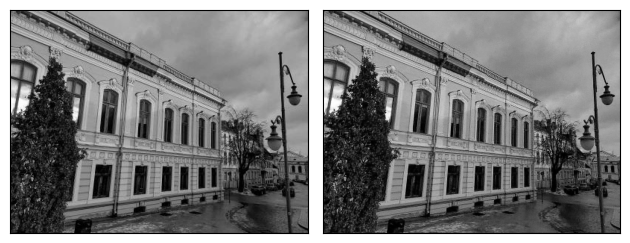

iteration [2151/4000], Loss: 0.0002659869787748903
iteration [2152/4000], Loss: 0.0003428844502195716
iteration [2153/4000], Loss: 0.0003408437187317759
iteration [2154/4000], Loss: 0.0002731389249674976
iteration [2155/4000], Loss: 0.0002577470149844885
iteration [2156/4000], Loss: 0.00029432677547447383
iteration [2157/4000], Loss: 0.0003014930116478354
iteration [2158/4000], Loss: 0.00025152123998850584
iteration [2159/4000], Loss: 0.00024829665198922157
iteration [2160/4000], Loss: 0.0002872041950467974
iteration [2161/4000], Loss: 0.00026917242212221026
iteration [2162/4000], Loss: 0.00022532427101396024
iteration [2163/4000], Loss: 0.0002253701677545905
iteration [2164/4000], Loss: 0.0002616240526549518
iteration [2165/4000], Loss: 0.000262555229710415
iteration [2166/4000], Loss: 0.0002462312113493681
iteration [2167/4000], Loss: 0.0002542665752116591
iteration [2168/4000], Loss: 0.0002909847244154662
iteration [2169/4000], Loss: 0.00025992008158937097
iteration [2170/4000], Los

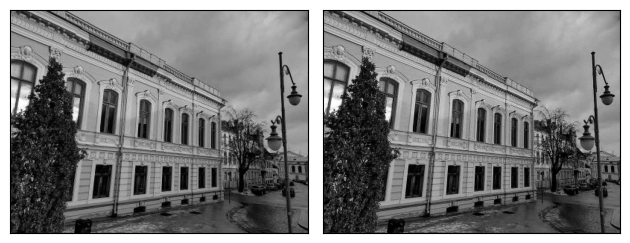

iteration [2176/4000], Loss: 0.00023499623057432473
iteration [2177/4000], Loss: 0.00022894692665431648
iteration [2178/4000], Loss: 0.00022759380226489156
iteration [2179/4000], Loss: 0.0002344507083762437
iteration [2180/4000], Loss: 0.00024745575501583517
iteration [2181/4000], Loss: 0.0002657279255799949
iteration [2182/4000], Loss: 0.00027399216196499765
iteration [2183/4000], Loss: 0.00029245938640087843
iteration [2184/4000], Loss: 0.00031324615702033043
iteration [2185/4000], Loss: 0.0003068012301810086
iteration [2186/4000], Loss: 0.00031404171022586524
iteration [2187/4000], Loss: 0.00032982713310047984
iteration [2188/4000], Loss: 0.000329316797433421
iteration [2189/4000], Loss: 0.0003337677044328302
iteration [2190/4000], Loss: 0.00031949352705851197
iteration [2191/4000], Loss: 0.00032303339685313404
iteration [2192/4000], Loss: 0.00031575094908475876
iteration [2193/4000], Loss: 0.00029074272606521845
iteration [2194/4000], Loss: 0.00026546671870164573
iteration [2195/40

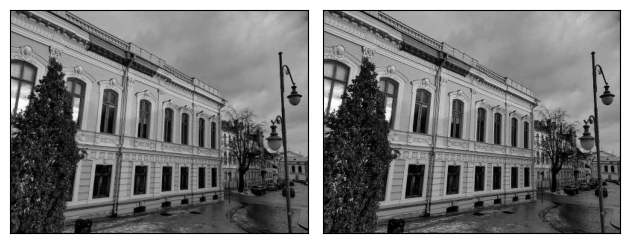

iteration [2201/4000], Loss: 0.0002257195592392236
iteration [2202/4000], Loss: 0.00021435116650536656
iteration [2203/4000], Loss: 0.0002060307888314128
iteration [2204/4000], Loss: 0.00020636776753235608
iteration [2205/4000], Loss: 0.00020393797603901476
iteration [2206/4000], Loss: 0.00019674519717227668
iteration [2207/4000], Loss: 0.00019745403551496565
iteration [2208/4000], Loss: 0.00019317296391818672
iteration [2209/4000], Loss: 0.00018803692364599556
iteration [2210/4000], Loss: 0.0001924864191096276
iteration [2211/4000], Loss: 0.00019565153343137354
iteration [2212/4000], Loss: 0.00019793855608440936
iteration [2213/4000], Loss: 0.00022168440045788884
iteration [2214/4000], Loss: 0.00024500995641574264
iteration [2215/4000], Loss: 0.0003316012443974614
iteration [2216/4000], Loss: 0.0003208986599929631
iteration [2217/4000], Loss: 0.00033371822792105377
iteration [2218/4000], Loss: 0.00029125131550244987
iteration [2219/4000], Loss: 0.000315918936394155
iteration [2220/400

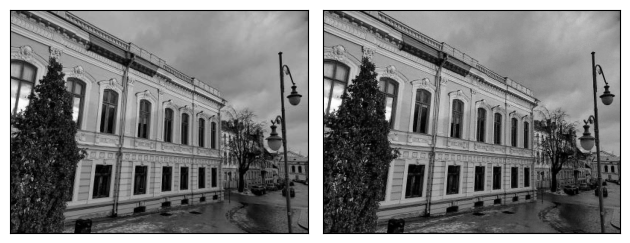

iteration [2226/4000], Loss: 0.00025188663857989013
iteration [2227/4000], Loss: 0.00026553336647339165
iteration [2228/4000], Loss: 0.0002449750027153641
iteration [2229/4000], Loss: 0.00023421627702191472
iteration [2230/4000], Loss: 0.0002495422086212784
iteration [2231/4000], Loss: 0.0002537866239435971
iteration [2232/4000], Loss: 0.0002381605445407331
iteration [2233/4000], Loss: 0.0002634576230775565
iteration [2234/4000], Loss: 0.0002777879999484867
iteration [2235/4000], Loss: 0.0002950364723801613
iteration [2236/4000], Loss: 0.0003069600206799805
iteration [2237/4000], Loss: 0.0003267760039307177
iteration [2238/4000], Loss: 0.0002928636677097529
iteration [2239/4000], Loss: 0.0002594426041468978
iteration [2240/4000], Loss: 0.00023056437203194946
iteration [2241/4000], Loss: 0.0002300491905771196
iteration [2242/4000], Loss: 0.0002662453625816852
iteration [2243/4000], Loss: 0.0002633315452840179
iteration [2244/4000], Loss: 0.0002719915646594018
iteration [2245/4000], Loss

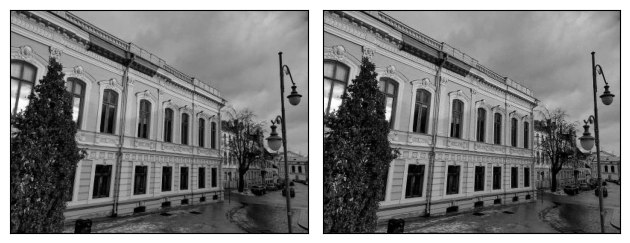

iteration [2251/4000], Loss: 0.0002231438411399722
iteration [2252/4000], Loss: 0.00022974351304583251
iteration [2253/4000], Loss: 0.00022376555716618896
iteration [2254/4000], Loss: 0.00020822715305257589
iteration [2255/4000], Loss: 0.0002012803452089429
iteration [2256/4000], Loss: 0.000202050810912624
iteration [2257/4000], Loss: 0.00020417214545886964
iteration [2258/4000], Loss: 0.00020365320960991085
iteration [2259/4000], Loss: 0.00020004907855764031
iteration [2260/4000], Loss: 0.0001974937185877934
iteration [2261/4000], Loss: 0.00019605160923674703
iteration [2262/4000], Loss: 0.00019911961862817407
iteration [2263/4000], Loss: 0.0001975658378796652
iteration [2264/4000], Loss: 0.00019650807371363044
iteration [2265/4000], Loss: 0.0002034019271377474
iteration [2266/4000], Loss: 0.00023307981609832495
iteration [2267/4000], Loss: 0.0002827288117259741
iteration [2268/4000], Loss: 0.0003396257816348225
iteration [2269/4000], Loss: 0.0003991439298260957
iteration [2270/4000],

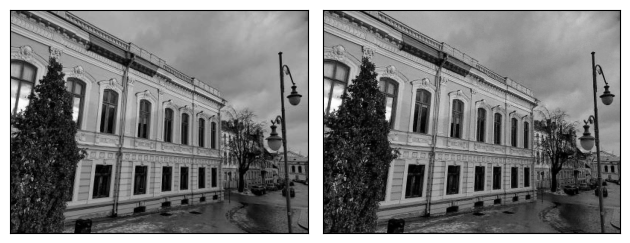

iteration [2276/4000], Loss: 0.0003541196638252586
iteration [2277/4000], Loss: 0.0003358378307893872
iteration [2278/4000], Loss: 0.00028796284459531307
iteration [2279/4000], Loss: 0.0002903657441493124
iteration [2280/4000], Loss: 0.0002782025549095124
iteration [2281/4000], Loss: 0.00025495272711850703
iteration [2282/4000], Loss: 0.00024533236864954233
iteration [2283/4000], Loss: 0.00023665447952225804
iteration [2284/4000], Loss: 0.0002353472082177177
iteration [2285/4000], Loss: 0.00023185659665614367
iteration [2286/4000], Loss: 0.00021352402109187096
iteration [2287/4000], Loss: 0.00021204732183832675
iteration [2288/4000], Loss: 0.00021186296362429857
iteration [2289/4000], Loss: 0.000198995548998937
iteration [2290/4000], Loss: 0.0001983090041903779
iteration [2291/4000], Loss: 0.00020083592971786857
iteration [2292/4000], Loss: 0.000187642450327985
iteration [2293/4000], Loss: 0.00018644814554136246
iteration [2294/4000], Loss: 0.000191161161637865
iteration [2295/4000], L

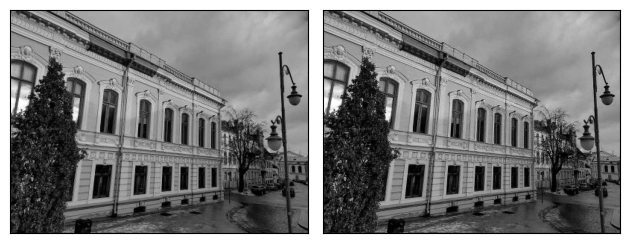

iteration [2301/4000], Loss: 0.0002850667224265635
iteration [2302/4000], Loss: 0.0003366958408150822
iteration [2303/4000], Loss: 0.00034103135112673044
iteration [2304/4000], Loss: 0.00032082031248137355
iteration [2305/4000], Loss: 0.0003025053010787815
iteration [2306/4000], Loss: 0.0003329780010972172
iteration [2307/4000], Loss: 0.0003796268138103187
iteration [2308/4000], Loss: 0.00032916860072873533
iteration [2309/4000], Loss: 0.0003037098504137248
iteration [2310/4000], Loss: 0.0003479710721876472
iteration [2311/4000], Loss: 0.00031712226336821914
iteration [2312/4000], Loss: 0.00027785892598330975
iteration [2313/4000], Loss: 0.00027447822503745556
iteration [2314/4000], Loss: 0.0002636336721479893
iteration [2315/4000], Loss: 0.00024351886531803757
iteration [2316/4000], Loss: 0.0002322533546248451
iteration [2317/4000], Loss: 0.0002280097542097792
iteration [2318/4000], Loss: 0.000221384791075252
iteration [2319/4000], Loss: 0.0002209880913142115
iteration [2320/4000], Lo

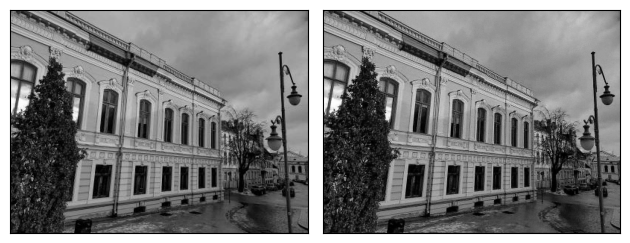

iteration [2326/4000], Loss: 0.0001854334695963189
iteration [2327/4000], Loss: 0.0001837305462686345
iteration [2328/4000], Loss: 0.00018135870050173253
iteration [2329/4000], Loss: 0.000181728188181296
iteration [2330/4000], Loss: 0.00018562382319942117
iteration [2331/4000], Loss: 0.00019168354629073292
iteration [2332/4000], Loss: 0.00020568101899698377
iteration [2333/4000], Loss: 0.00023441393568646163
iteration [2334/4000], Loss: 0.0002744792145676911
iteration [2335/4000], Loss: 0.00035798928001895547
iteration [2336/4000], Loss: 0.0003821585269179195
iteration [2337/4000], Loss: 0.000403848709538579
iteration [2338/4000], Loss: 0.0002630445815157145
iteration [2339/4000], Loss: 0.000210036218049936
iteration [2340/4000], Loss: 0.00026496630744077265
iteration [2341/4000], Loss: 0.0003280336386524141
iteration [2342/4000], Loss: 0.00031449529342353344
iteration [2343/4000], Loss: 0.00023952865740284324
iteration [2344/4000], Loss: 0.0002485779405105859
iteration [2345/4000], Lo

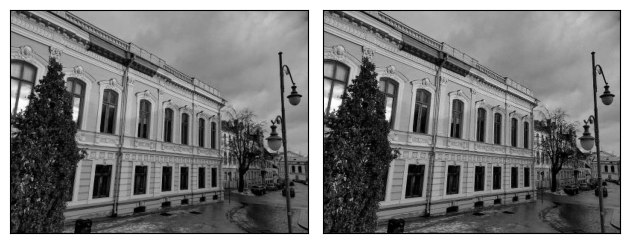

iteration [2351/4000], Loss: 0.0002167428465327248
iteration [2352/4000], Loss: 0.00021610110707115382
iteration [2353/4000], Loss: 0.00021833262871950865
iteration [2354/4000], Loss: 0.00020262600446585566
iteration [2355/4000], Loss: 0.0001922990777529776
iteration [2356/4000], Loss: 0.0001887404650915414
iteration [2357/4000], Loss: 0.00018826930318027735
iteration [2358/4000], Loss: 0.00018614316650200635
iteration [2359/4000], Loss: 0.00017855246551334858
iteration [2360/4000], Loss: 0.00017732713604345918
iteration [2361/4000], Loss: 0.00018024536257144064
iteration [2362/4000], Loss: 0.0001790682872524485
iteration [2363/4000], Loss: 0.00017710514657665044
iteration [2364/4000], Loss: 0.0001834168069763109
iteration [2365/4000], Loss: 0.00019467361562419683
iteration [2366/4000], Loss: 0.00021045580797363073
iteration [2367/4000], Loss: 0.00024265785759780556
iteration [2368/4000], Loss: 0.00029219844145700336
iteration [2369/4000], Loss: 0.0003451232914812863
iteration [2370/40

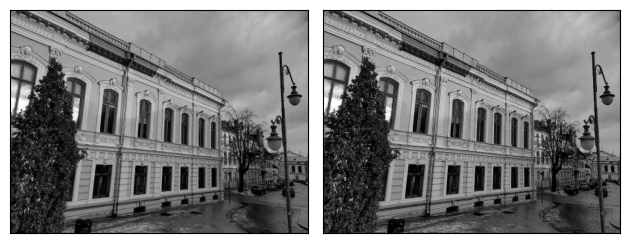

iteration [2376/4000], Loss: 0.0003232192248106003
iteration [2377/4000], Loss: 0.00028714785003103316
iteration [2378/4000], Loss: 0.0002870021853595972
iteration [2379/4000], Loss: 0.0002841863897629082
iteration [2380/4000], Loss: 0.0002384660765528679
iteration [2381/4000], Loss: 0.0002347874251427129
iteration [2382/4000], Loss: 0.0002534907544031739
iteration [2383/4000], Loss: 0.00022778457787353545
iteration [2384/4000], Loss: 0.00021620267943944782
iteration [2385/4000], Loss: 0.0002145745966117829
iteration [2386/4000], Loss: 0.00020124924776609987
iteration [2387/4000], Loss: 0.00020256704010535032
iteration [2388/4000], Loss: 0.00019255970255471766
iteration [2389/4000], Loss: 0.00018433399964123964
iteration [2390/4000], Loss: 0.00018756958888843656
iteration [2391/4000], Loss: 0.0001798733719624579
iteration [2392/4000], Loss: 0.00017396268958691508
iteration [2393/4000], Loss: 0.00017620032303966582
iteration [2394/4000], Loss: 0.00017211586236953735
iteration [2395/4000

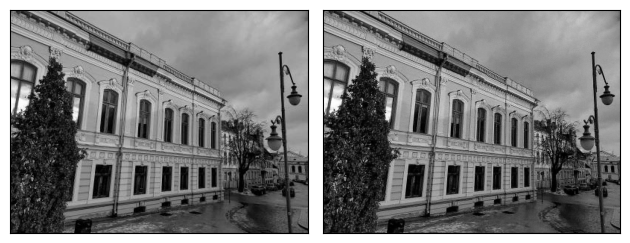

iteration [2401/4000], Loss: 0.00019735406385734677
iteration [2402/4000], Loss: 0.00023121217964217067
iteration [2403/4000], Loss: 0.00029344038921408355
iteration [2404/4000], Loss: 0.00035064175608567894
iteration [2405/4000], Loss: 0.00037848143256269395
iteration [2406/4000], Loss: 0.0002788391138892621
iteration [2407/4000], Loss: 0.00022623802942689508
iteration [2408/4000], Loss: 0.0002760098723229021
iteration [2409/4000], Loss: 0.0003669536381494254
iteration [2410/4000], Loss: 0.00033340422669425607
iteration [2411/4000], Loss: 0.0002782151859719306
iteration [2412/4000], Loss: 0.0002806978882290423
iteration [2413/4000], Loss: 0.00027562532341107726
iteration [2414/4000], Loss: 0.0002372566523263231
iteration [2415/4000], Loss: 0.0002412838366581127
iteration [2416/4000], Loss: 0.00024272175505757332
iteration [2417/4000], Loss: 0.00022792334493715316
iteration [2418/4000], Loss: 0.00023710521054454148
iteration [2419/4000], Loss: 0.00021948573703411967
iteration [2420/400

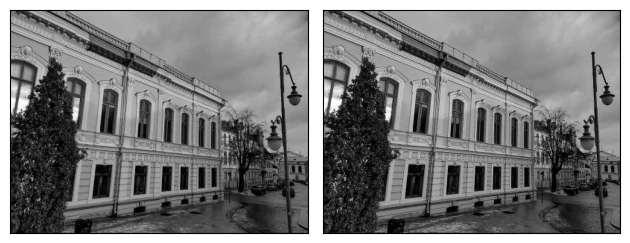

iteration [2426/4000], Loss: 0.00017414710600860417
iteration [2427/4000], Loss: 0.00017825906979851425
iteration [2428/4000], Loss: 0.00017453069449402392
iteration [2429/4000], Loss: 0.0001732098317006603
iteration [2430/4000], Loss: 0.00017760494665708393
iteration [2431/4000], Loss: 0.0001851456327131018
iteration [2432/4000], Loss: 0.0001930585567606613
iteration [2433/4000], Loss: 0.00022047491802368313
iteration [2434/4000], Loss: 0.00026373605942353606
iteration [2435/4000], Loss: 0.00032994593493640423
iteration [2436/4000], Loss: 0.00038760778261348605
iteration [2437/4000], Loss: 0.0004153093905188143
iteration [2438/4000], Loss: 0.00040185663965530694
iteration [2439/4000], Loss: 0.0003465384943410754
iteration [2440/4000], Loss: 0.0003893268876709044
iteration [2441/4000], Loss: 0.0003234584874007851
iteration [2442/4000], Loss: 0.00027238039183430374
iteration [2443/4000], Loss: 0.0002832815225701779
iteration [2444/4000], Loss: 0.0002872433979064226
iteration [2445/4000]

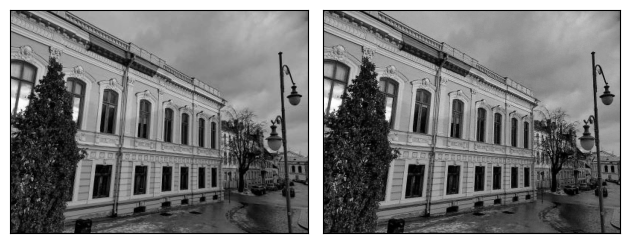

iteration [2451/4000], Loss: 0.00023706491629127413
iteration [2452/4000], Loss: 0.00019504933152347803
iteration [2453/4000], Loss: 0.00019005683134309947
iteration [2454/4000], Loss: 0.00020485771528910846
iteration [2455/4000], Loss: 0.00018960355373565108
iteration [2456/4000], Loss: 0.00018378111417405307
iteration [2457/4000], Loss: 0.0001799857127480209
iteration [2458/4000], Loss: 0.00017546587332617491
iteration [2459/4000], Loss: 0.00017100374680012465
iteration [2460/4000], Loss: 0.00016898367903195322
iteration [2461/4000], Loss: 0.00016778407734818757
iteration [2462/4000], Loss: 0.00016371661331504583
iteration [2463/4000], Loss: 0.00016225433500949293
iteration [2464/4000], Loss: 0.00016562144446652383
iteration [2465/4000], Loss: 0.00016861475887708366
iteration [2466/4000], Loss: 0.0001775143318809569
iteration [2467/4000], Loss: 0.00018603265925776213
iteration [2468/4000], Loss: 0.00021725139231421053
iteration [2469/4000], Loss: 0.0002270621043862775
iteration [2470

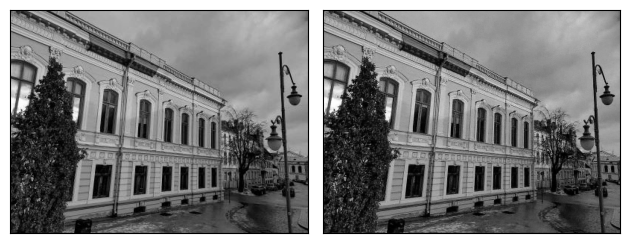

iteration [2476/4000], Loss: 0.0002528590557631105
iteration [2477/4000], Loss: 0.0002451612090226263
iteration [2478/4000], Loss: 0.00021425654995255172
iteration [2479/4000], Loss: 0.00022257001546677202
iteration [2480/4000], Loss: 0.00021970355010125786
iteration [2481/4000], Loss: 0.00021064310567453504
iteration [2482/4000], Loss: 0.00022250069014262408
iteration [2483/4000], Loss: 0.00023705365310888737
iteration [2484/4000], Loss: 0.000248166878009215
iteration [2485/4000], Loss: 0.0002729374682530761
iteration [2486/4000], Loss: 0.0002695668372325599
iteration [2487/4000], Loss: 0.0002865054993890226
iteration [2488/4000], Loss: 0.0002455491339787841
iteration [2489/4000], Loss: 0.00024158891756087542
iteration [2490/4000], Loss: 0.00023508109734393656
iteration [2491/4000], Loss: 0.0002505530137568712
iteration [2492/4000], Loss: 0.00028636236675083637
iteration [2493/4000], Loss: 0.0002507747558411211
iteration [2494/4000], Loss: 0.0002267581585329026
iteration [2495/4000], 

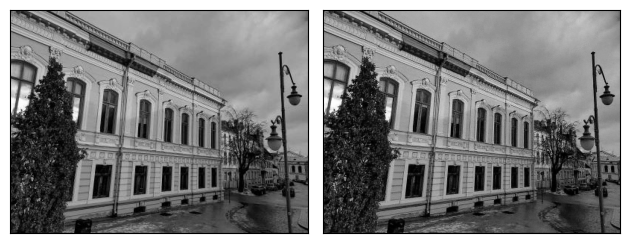

iteration [2501/4000], Loss: 0.00019651110051199794
iteration [2502/4000], Loss: 0.0001948656718013808
iteration [2503/4000], Loss: 0.00021709302382078022
iteration [2504/4000], Loss: 0.00022156338673084974
iteration [2505/4000], Loss: 0.00023253388644661754
iteration [2506/4000], Loss: 0.00023657629208173603
iteration [2507/4000], Loss: 0.00022881990298628807
iteration [2508/4000], Loss: 0.00020109362958464772
iteration [2509/4000], Loss: 0.00019733168301172554
iteration [2510/4000], Loss: 0.00020515854703262448
iteration [2511/4000], Loss: 0.00020042039977852255
iteration [2512/4000], Loss: 0.00019044008513446897
iteration [2513/4000], Loss: 0.00018558393639978021
iteration [2514/4000], Loss: 0.00018992560217157006
iteration [2515/4000], Loss: 0.00018525574705563486
iteration [2516/4000], Loss: 0.00017866685811895877
iteration [2517/4000], Loss: 0.00017495955398771912
iteration [2518/4000], Loss: 0.0001700285356491804
iteration [2519/4000], Loss: 0.00016878121823538095
iteration [252

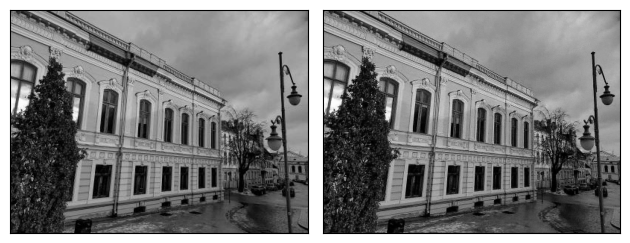

iteration [2526/4000], Loss: 0.00020850836881436408
iteration [2527/4000], Loss: 0.00021835947700310498
iteration [2528/4000], Loss: 0.00020813095034100115
iteration [2529/4000], Loss: 0.00021784799173474312
iteration [2530/4000], Loss: 0.00022375256230589002
iteration [2531/4000], Loss: 0.00023473621695302427
iteration [2532/4000], Loss: 0.00024862756254151464
iteration [2533/4000], Loss: 0.0002687199448700994
iteration [2534/4000], Loss: 0.00029484860715456307
iteration [2535/4000], Loss: 0.00029697336140088737
iteration [2536/4000], Loss: 0.0002534340019337833
iteration [2537/4000], Loss: 0.00022579851793125272
iteration [2538/4000], Loss: 0.00022749036725144833
iteration [2539/4000], Loss: 0.00024127011420205235
iteration [2540/4000], Loss: 0.00022256706142798066
iteration [2541/4000], Loss: 0.00021335466590244323
iteration [2542/4000], Loss: 0.00020126946037635207
iteration [2543/4000], Loss: 0.00019196816720068455
iteration [2544/4000], Loss: 0.00019580624939408153
iteration [254

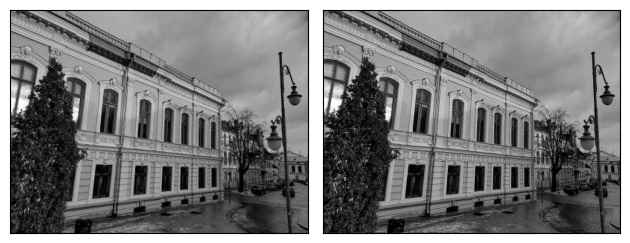

iteration [2551/4000], Loss: 0.00015904672909528017
iteration [2552/4000], Loss: 0.00015650303976144642
iteration [2553/4000], Loss: 0.00015274087490979582
iteration [2554/4000], Loss: 0.000155370551510714
iteration [2555/4000], Loss: 0.00015823003195691854
iteration [2556/4000], Loss: 0.00016454121214337647
iteration [2557/4000], Loss: 0.00017215106345247477
iteration [2558/4000], Loss: 0.00019595178309828043
iteration [2559/4000], Loss: 0.00022991570585872978
iteration [2560/4000], Loss: 0.00027580332243815064
iteration [2561/4000], Loss: 0.0003166979586239904
iteration [2562/4000], Loss: 0.0003412649966776371
iteration [2563/4000], Loss: 0.0003386619791854173
iteration [2564/4000], Loss: 0.00031893429695628583
iteration [2565/4000], Loss: 0.000397800060454756
iteration [2566/4000], Loss: 0.00037808046909049153
iteration [2567/4000], Loss: 0.00036451398045755923
iteration [2568/4000], Loss: 0.00029123027343302965
iteration [2569/4000], Loss: 0.0002743173681665212
iteration [2570/4000

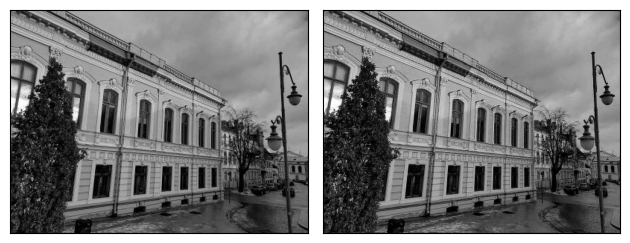

iteration [2576/4000], Loss: 0.00020998356922063977
iteration [2577/4000], Loss: 0.00021769174782093614
iteration [2578/4000], Loss: 0.00020739674801006913
iteration [2579/4000], Loss: 0.00019563626847229898
iteration [2580/4000], Loss: 0.0001944768737303093
iteration [2581/4000], Loss: 0.00018432097567711025
iteration [2582/4000], Loss: 0.00018437192193232477
iteration [2583/4000], Loss: 0.0001782703766366467
iteration [2584/4000], Loss: 0.0001720364234643057
iteration [2585/4000], Loss: 0.0001727105409372598
iteration [2586/4000], Loss: 0.00017009266593959183
iteration [2587/4000], Loss: 0.00017455431225243956
iteration [2588/4000], Loss: 0.0001725186302792281
iteration [2589/4000], Loss: 0.00018068119243253022
iteration [2590/4000], Loss: 0.00019840530876535922
iteration [2591/4000], Loss: 0.00021822689450345933
iteration [2592/4000], Loss: 0.0002483599237166345
iteration [2593/4000], Loss: 0.0002781193470582366
iteration [2594/4000], Loss: 0.000286897731712088
iteration [2595/4000]

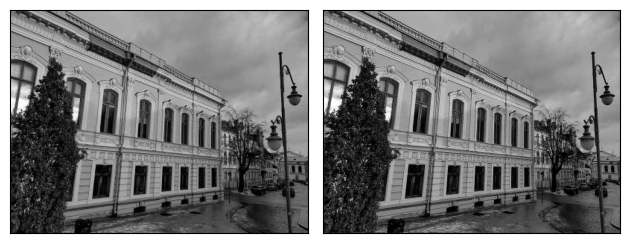

iteration [2601/4000], Loss: 0.00019736113608814776
iteration [2602/4000], Loss: 0.0001762801839504391
iteration [2603/4000], Loss: 0.00017876410856842995
iteration [2604/4000], Loss: 0.00019438624440226704
iteration [2605/4000], Loss: 0.00020216719713062048
iteration [2606/4000], Loss: 0.00018991126853507012
iteration [2607/4000], Loss: 0.0001684457529336214
iteration [2608/4000], Loss: 0.00016979782958514988
iteration [2609/4000], Loss: 0.00017805217066779733
iteration [2610/4000], Loss: 0.00019122607773169875
iteration [2611/4000], Loss: 0.00017426548583898693
iteration [2612/4000], Loss: 0.0001593639753991738
iteration [2613/4000], Loss: 0.00015495065599679947
iteration [2614/4000], Loss: 0.00016468725516460836
iteration [2615/4000], Loss: 0.0001701367145869881
iteration [2616/4000], Loss: 0.0001651288039283827
iteration [2617/4000], Loss: 0.00016479911573696882
iteration [2618/4000], Loss: 0.00018445747264195234
iteration [2619/4000], Loss: 0.00019891907868441194
iteration [2620/4

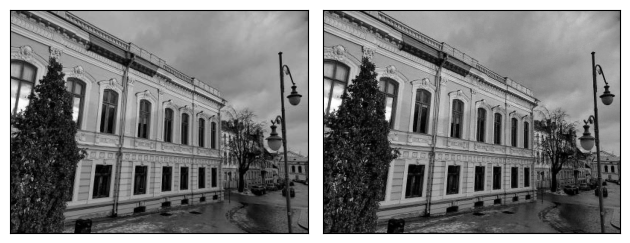

iteration [2626/4000], Loss: 0.00023037398932501674
iteration [2627/4000], Loss: 0.00023942498955875635
iteration [2628/4000], Loss: 0.00023764734214637429
iteration [2629/4000], Loss: 0.00022588911815546453
iteration [2630/4000], Loss: 0.00021187003585509956
iteration [2631/4000], Loss: 0.0002322780928807333
iteration [2632/4000], Loss: 0.0002163940080208704
iteration [2633/4000], Loss: 0.00018139975145459175
iteration [2634/4000], Loss: 0.00018617922614794225
iteration [2635/4000], Loss: 0.00020104028226342052
iteration [2636/4000], Loss: 0.0001713870879029855
iteration [2637/4000], Loss: 0.00015863313456065953
iteration [2638/4000], Loss: 0.00016592977044638246
iteration [2639/4000], Loss: 0.00015657352923881263
iteration [2640/4000], Loss: 0.00015377452655229717
iteration [2641/4000], Loss: 0.00015658493794035167
iteration [2642/4000], Loss: 0.00015001374413259327
iteration [2643/4000], Loss: 0.00014635638217441738
iteration [2644/4000], Loss: 0.0001503539679106325
iteration [2645/

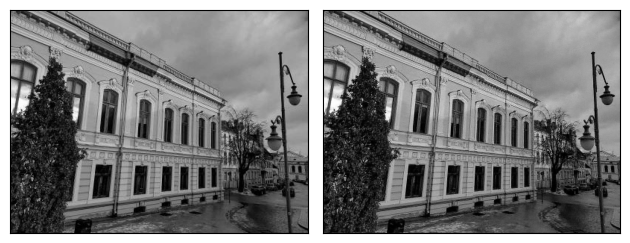

iteration [2651/4000], Loss: 0.0002160987933166325
iteration [2652/4000], Loss: 0.00027009969926439226
iteration [2653/4000], Loss: 0.00028691909392364323
iteration [2654/4000], Loss: 0.0002870472089853138
iteration [2655/4000], Loss: 0.00022207120491657406
iteration [2656/4000], Loss: 0.00017946369189303368
iteration [2657/4000], Loss: 0.00020389871497172862
iteration [2658/4000], Loss: 0.00024116208078339696
iteration [2659/4000], Loss: 0.00026168799377046525
iteration [2660/4000], Loss: 0.000202306589926593
iteration [2661/4000], Loss: 0.00018293835455551744
iteration [2662/4000], Loss: 0.00020493860938586295
iteration [2663/4000], Loss: 0.0002206330100307241
iteration [2664/4000], Loss: 0.00021540385205298662
iteration [2665/4000], Loss: 0.00018903314776252955
iteration [2666/4000], Loss: 0.00019694615912158042
iteration [2667/4000], Loss: 0.00021204112272243947
iteration [2668/4000], Loss: 0.00019426817016210407
iteration [2669/4000], Loss: 0.00018616167653817683
iteration [2670/4

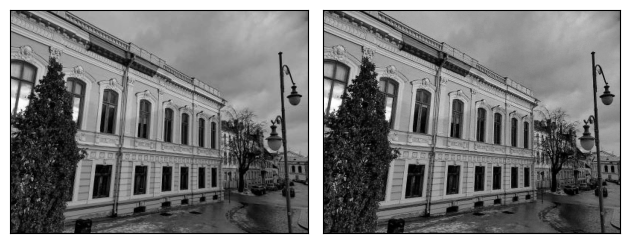

iteration [2676/4000], Loss: 0.0002154470857931301
iteration [2677/4000], Loss: 0.0002130981592927128
iteration [2678/4000], Loss: 0.00021415147057268769
iteration [2679/4000], Loss: 0.0001993393962038681
iteration [2680/4000], Loss: 0.00020598566334228963
iteration [2681/4000], Loss: 0.00022494849690701813
iteration [2682/4000], Loss: 0.0002470563049428165
iteration [2683/4000], Loss: 0.00020876039343420416
iteration [2684/4000], Loss: 0.00018581145559437573
iteration [2685/4000], Loss: 0.00018486252520233393
iteration [2686/4000], Loss: 0.00017369064153172076
iteration [2687/4000], Loss: 0.0001790357637219131
iteration [2688/4000], Loss: 0.00018481771985534579
iteration [2689/4000], Loss: 0.00018965279741678387
iteration [2690/4000], Loss: 0.0001741210580803454
iteration [2691/4000], Loss: 0.00016960383800324053
iteration [2692/4000], Loss: 0.00017605465836822987
iteration [2693/4000], Loss: 0.000192937848623842
iteration [2694/4000], Loss: 0.00019088767294306308
iteration [2695/4000

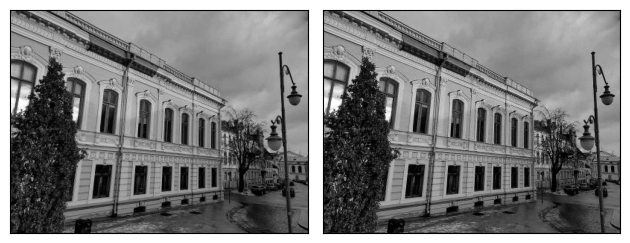

iteration [2701/4000], Loss: 0.0001884900702862069
iteration [2702/4000], Loss: 0.00019054327276535332
iteration [2703/4000], Loss: 0.0001936030457727611
iteration [2704/4000], Loss: 0.00018615592853166163
iteration [2705/4000], Loss: 0.00016518392658326775
iteration [2706/4000], Loss: 0.00015346880536526442
iteration [2707/4000], Loss: 0.00016957092157099396
iteration [2708/4000], Loss: 0.0001918241468956694
iteration [2709/4000], Loss: 0.00021726613340433687
iteration [2710/4000], Loss: 0.00022790416551288217
iteration [2711/4000], Loss: 0.00025539056514389813
iteration [2712/4000], Loss: 0.00024142551410477608
iteration [2713/4000], Loss: 0.00023608490300830454
iteration [2714/4000], Loss: 0.00023148953914642334
iteration [2715/4000], Loss: 0.00022346069454215467
iteration [2716/4000], Loss: 0.00021089220535941422
iteration [2717/4000], Loss: 0.00019986143161077052
iteration [2718/4000], Loss: 0.00020204267639201134
iteration [2719/4000], Loss: 0.00019422743935137987
iteration [2720

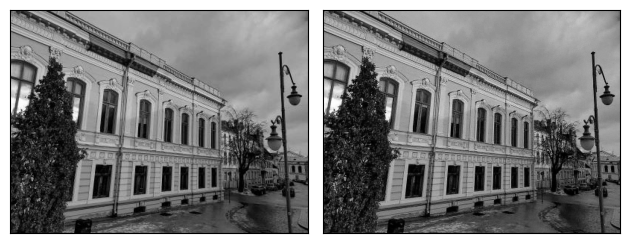

iteration [2726/4000], Loss: 0.00015268729475792497
iteration [2727/4000], Loss: 0.00015698900097049773
iteration [2728/4000], Loss: 0.00015756180800963193
iteration [2729/4000], Loss: 0.00015946566418278962
iteration [2730/4000], Loss: 0.00016433096607215703
iteration [2731/4000], Loss: 0.00018161037587560713
iteration [2732/4000], Loss: 0.00019061591592617333
iteration [2733/4000], Loss: 0.0002091314527206123
iteration [2734/4000], Loss: 0.00020621491421479732
iteration [2735/4000], Loss: 0.00020235190459061414
iteration [2736/4000], Loss: 0.00017720866890158504
iteration [2737/4000], Loss: 0.00016962140216492116
iteration [2738/4000], Loss: 0.00017183084855787456
iteration [2739/4000], Loss: 0.00017861976812127978
iteration [2740/4000], Loss: 0.00020341671188361943
iteration [2741/4000], Loss: 0.00021797168301418424
iteration [2742/4000], Loss: 0.00022919518232811242
iteration [2743/4000], Loss: 0.00021555523562710732
iteration [2744/4000], Loss: 0.00022381125018000603
iteration [27

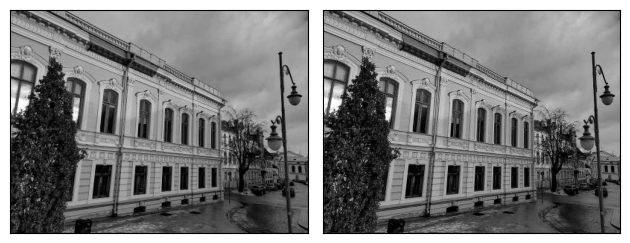

iteration [2751/4000], Loss: 0.00017344331718049943
iteration [2752/4000], Loss: 0.00017969048349186778
iteration [2753/4000], Loss: 0.0001834462018450722
iteration [2754/4000], Loss: 0.00018106852076016366
iteration [2755/4000], Loss: 0.00017868817667476833
iteration [2756/4000], Loss: 0.0001863486977526918
iteration [2757/4000], Loss: 0.00021376922086346895
iteration [2758/4000], Loss: 0.0002367480774410069
iteration [2759/4000], Loss: 0.0002667953376658261
iteration [2760/4000], Loss: 0.00027671578573063016
iteration [2761/4000], Loss: 0.0002853715850505978
iteration [2762/4000], Loss: 0.0002640643797349185
iteration [2763/4000], Loss: 0.00022081477800384164
iteration [2764/4000], Loss: 0.00021127599757164717
iteration [2765/4000], Loss: 0.00020375291933305562
iteration [2766/4000], Loss: 0.00020902813412249088
iteration [2767/4000], Loss: 0.00021120074961800128
iteration [2768/4000], Loss: 0.00019058772886637598
iteration [2769/4000], Loss: 0.0001686073374003172
iteration [2770/400

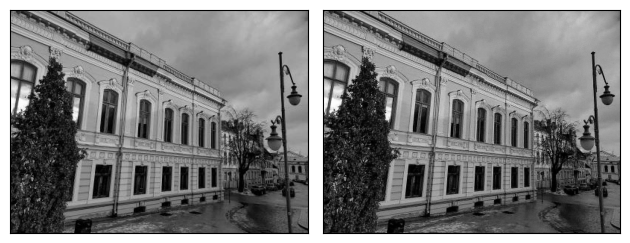

iteration [2776/4000], Loss: 0.00014207106141839176
iteration [2777/4000], Loss: 0.00013886851957067847
iteration [2778/4000], Loss: 0.0001347788784187287
iteration [2779/4000], Loss: 0.00013763796596322209
iteration [2780/4000], Loss: 0.00013502805086318403
iteration [2781/4000], Loss: 0.00013225559087004513
iteration [2782/4000], Loss: 0.00013368341024033725
iteration [2783/4000], Loss: 0.0001338182482868433
iteration [2784/4000], Loss: 0.0001393162674503401
iteration [2785/4000], Loss: 0.0001468755945097655
iteration [2786/4000], Loss: 0.0001618613605387509
iteration [2787/4000], Loss: 0.00019004472414962947
iteration [2788/4000], Loss: 0.0002349398855585605
iteration [2789/4000], Loss: 0.0002715371083468199
iteration [2790/4000], Loss: 0.00029842567164450884
iteration [2791/4000], Loss: 0.00024777749786153436
iteration [2792/4000], Loss: 0.00019861405598931015
iteration [2793/4000], Loss: 0.00019336979312356561
iteration [2794/4000], Loss: 0.0002655226562637836
iteration [2795/4000

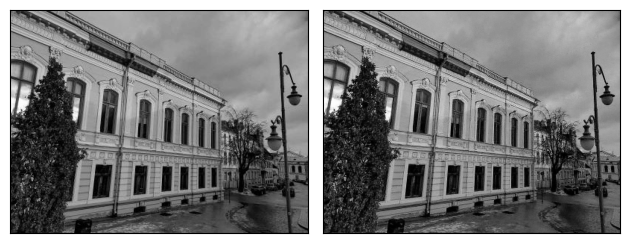

iteration [2801/4000], Loss: 0.00027098864666186273
iteration [2802/4000], Loss: 0.0002833032631315291
iteration [2803/4000], Loss: 0.0002511008642613888
iteration [2804/4000], Loss: 0.00021702671074308455
iteration [2805/4000], Loss: 0.000220121190068312
iteration [2806/4000], Loss: 0.00019394034461583942
iteration [2807/4000], Loss: 0.00019397737924009562
iteration [2808/4000], Loss: 0.00019612979667726904
iteration [2809/4000], Loss: 0.00016869216051418334
iteration [2810/4000], Loss: 0.00017206167103722692
iteration [2811/4000], Loss: 0.0001695691462373361
iteration [2812/4000], Loss: 0.00015061804151628166
iteration [2813/4000], Loss: 0.00015517942665610462
iteration [2814/4000], Loss: 0.00015620847989339381
iteration [2815/4000], Loss: 0.00014742909115739167
iteration [2816/4000], Loss: 0.00014396500773727894
iteration [2817/4000], Loss: 0.00013910600682720542
iteration [2818/4000], Loss: 0.00013492123980540782
iteration [2819/4000], Loss: 0.00013118595234118402
iteration [2820/4

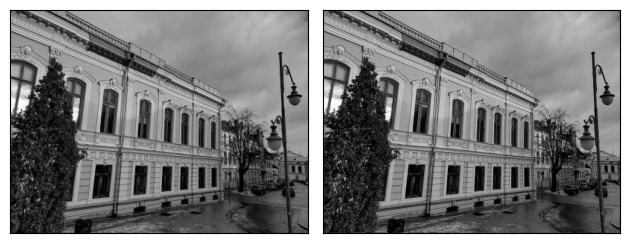

iteration [2826/4000], Loss: 0.00015176318993326277
iteration [2827/4000], Loss: 0.00017750851111486554
iteration [2828/4000], Loss: 0.0001995910715777427
iteration [2829/4000], Loss: 0.00024484601453877985
iteration [2830/4000], Loss: 0.00024604357895441353
iteration [2831/4000], Loss: 0.00024434414808638394
iteration [2832/4000], Loss: 0.00018436912796460092
iteration [2833/4000], Loss: 0.0001674231607466936
iteration [2834/4000], Loss: 0.00020816213509533554
iteration [2835/4000], Loss: 0.00022541097132489085
iteration [2836/4000], Loss: 0.00022915298177395016
iteration [2837/4000], Loss: 0.0001722040760796517
iteration [2838/4000], Loss: 0.0001801013422664255
iteration [2839/4000], Loss: 0.00021569190721493214
iteration [2840/4000], Loss: 0.0002077832177747041
iteration [2841/4000], Loss: 0.0001896872854558751
iteration [2842/4000], Loss: 0.00019017941667698324
iteration [2843/4000], Loss: 0.00020022870739921927
iteration [2844/4000], Loss: 0.00020014928304590285
iteration [2845/40

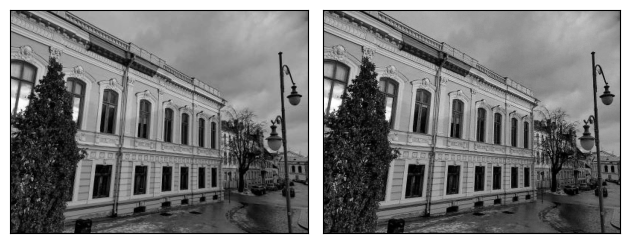

iteration [2851/4000], Loss: 0.00018997864390257746
iteration [2852/4000], Loss: 0.00018257557530887425
iteration [2853/4000], Loss: 0.0001732890959829092
iteration [2854/4000], Loss: 0.00016520297504030168
iteration [2855/4000], Loss: 0.0001693406084086746
iteration [2856/4000], Loss: 0.00016334475367330015
iteration [2857/4000], Loss: 0.00016354912077076733
iteration [2858/4000], Loss: 0.00017866886628326029
iteration [2859/4000], Loss: 0.0001893714361358434
iteration [2860/4000], Loss: 0.00019725669699255377
iteration [2861/4000], Loss: 0.00018873790395446122
iteration [2862/4000], Loss: 0.00017581248539499938
iteration [2863/4000], Loss: 0.00016588837024755776
iteration [2864/4000], Loss: 0.00015614360745530576
iteration [2865/4000], Loss: 0.00015096327115315944
iteration [2866/4000], Loss: 0.00015738832007627934
iteration [2867/4000], Loss: 0.00016701058484613895
iteration [2868/4000], Loss: 0.00015608531248290092
iteration [2869/4000], Loss: 0.00014186903717927635
iteration [2870

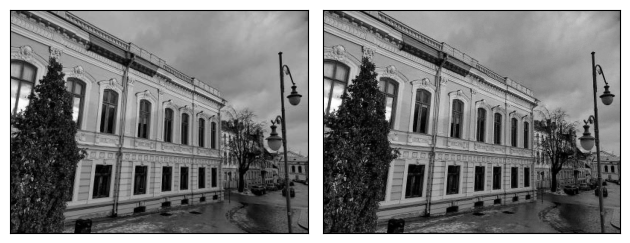

iteration [2876/4000], Loss: 0.00022104091476649046
iteration [2877/4000], Loss: 0.0002467810991220176
iteration [2878/4000], Loss: 0.00025849376106634736
iteration [2879/4000], Loss: 0.00024266415857709944
iteration [2880/4000], Loss: 0.00020585446327459067
iteration [2881/4000], Loss: 0.00018759106751531363
iteration [2882/4000], Loss: 0.00020131806377321482
iteration [2883/4000], Loss: 0.00020312349079176784
iteration [2884/4000], Loss: 0.0001922154042404145
iteration [2885/4000], Loss: 0.00017499517707619816
iteration [2886/4000], Loss: 0.00017292429402004927
iteration [2887/4000], Loss: 0.00018416208331473172
iteration [2888/4000], Loss: 0.0001791038375813514
iteration [2889/4000], Loss: 0.00017464760458096862
iteration [2890/4000], Loss: 0.00017141742864623666
iteration [2891/4000], Loss: 0.00017037465295288712
iteration [2892/4000], Loss: 0.00016391310782637447
iteration [2893/4000], Loss: 0.0001619285176275298
iteration [2894/4000], Loss: 0.00016027809760998935
iteration [2895/

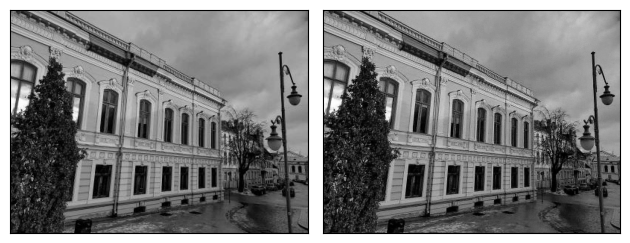

iteration [2901/4000], Loss: 0.00018590215768199414
iteration [2902/4000], Loss: 0.0001873562578111887
iteration [2903/4000], Loss: 0.00019785668700933456
iteration [2904/4000], Loss: 0.00018830414046533406
iteration [2905/4000], Loss: 0.00017920247046276927
iteration [2906/4000], Loss: 0.00016295745444949716
iteration [2907/4000], Loss: 0.0001574170746607706
iteration [2908/4000], Loss: 0.00016478994803037494
iteration [2909/4000], Loss: 0.00017369013221468776
iteration [2910/4000], Loss: 0.00018193972937297076
iteration [2911/4000], Loss: 0.00017397063493262976
iteration [2912/4000], Loss: 0.00016476403106935322
iteration [2913/4000], Loss: 0.00014517437375616282
iteration [2914/4000], Loss: 0.00013494607992470264
iteration [2915/4000], Loss: 0.0001354277046630159
iteration [2916/4000], Loss: 0.0001446263922844082
iteration [2917/4000], Loss: 0.00015382884885184467
iteration [2918/4000], Loss: 0.00014799022756051272
iteration [2919/4000], Loss: 0.00013735103129874915
iteration [2920/

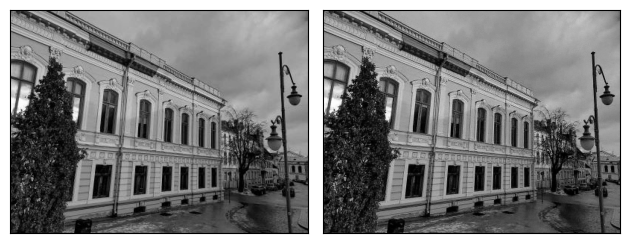

iteration [2926/4000], Loss: 0.00014785441453568637
iteration [2927/4000], Loss: 0.00015923520550131798
iteration [2928/4000], Loss: 0.00017455029592383653
iteration [2929/4000], Loss: 0.0002042452833848074
iteration [2930/4000], Loss: 0.00023078917001839727
iteration [2931/4000], Loss: 0.00026502233231440187
iteration [2932/4000], Loss: 0.0002534876111894846
iteration [2933/4000], Loss: 0.0002666523214429617
iteration [2934/4000], Loss: 0.0002815060142893344
iteration [2935/4000], Loss: 0.00032312446273863316
iteration [2936/4000], Loss: 0.00034207775024697185
iteration [2937/4000], Loss: 0.00027407429297454655
iteration [2938/4000], Loss: 0.0003057279100175947
iteration [2939/4000], Loss: 0.0003232590388506651
iteration [2940/4000], Loss: 0.00026154430815950036
iteration [2941/4000], Loss: 0.00022892758715897799
iteration [2942/4000], Loss: 0.0002711487468332052
iteration [2943/4000], Loss: 0.0002087451284751296
iteration [2944/4000], Loss: 0.00019025226356461644
iteration [2945/4000

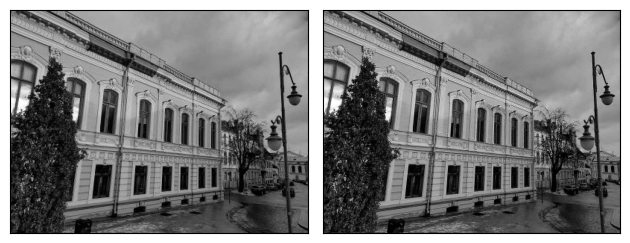

iteration [2951/4000], Loss: 0.00015450901992153376
iteration [2952/4000], Loss: 0.0001432169956387952
iteration [2953/4000], Loss: 0.0001474715390941128
iteration [2954/4000], Loss: 0.00014222358004190028
iteration [2955/4000], Loss: 0.0001338183064945042
iteration [2956/4000], Loss: 0.0001336219283984974
iteration [2957/4000], Loss: 0.00012751264148391783
iteration [2958/4000], Loss: 0.00012201844219816849
iteration [2959/4000], Loss: 0.00012404314475134015
iteration [2960/4000], Loss: 0.00011976964742643759
iteration [2961/4000], Loss: 0.00011665753117995337
iteration [2962/4000], Loss: 0.00011738153989426792
iteration [2963/4000], Loss: 0.00011486982111819088
iteration [2964/4000], Loss: 0.00011508680472616106
iteration [2965/4000], Loss: 0.00011714553693309426
iteration [2966/4000], Loss: 0.00012050489021930844
iteration [2967/4000], Loss: 0.00012935763515997678
iteration [2968/4000], Loss: 0.0001433830475434661
iteration [2969/4000], Loss: 0.00017372204456478357
iteration [2970/4

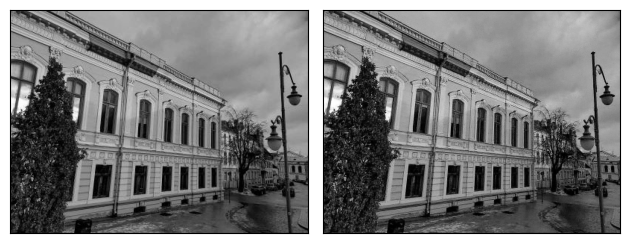

iteration [2976/4000], Loss: 0.0004058930790051818
iteration [2977/4000], Loss: 0.00033839530078694224
iteration [2978/4000], Loss: 0.00025171032757498324
iteration [2979/4000], Loss: 0.000265503884293139
iteration [2980/4000], Loss: 0.0002889057795982808
iteration [2981/4000], Loss: 0.00021809854661114514
iteration [2982/4000], Loss: 0.00020984811999369413
iteration [2983/4000], Loss: 0.0002185975608881563
iteration [2984/4000], Loss: 0.0001903307274915278
iteration [2985/4000], Loss: 0.00018901017028838396
iteration [2986/4000], Loss: 0.00018065745825879276
iteration [2987/4000], Loss: 0.00016768829664215446
iteration [2988/4000], Loss: 0.00016299494018312544
iteration [2989/4000], Loss: 0.00015562091721221805
iteration [2990/4000], Loss: 0.0001510357833467424
iteration [2991/4000], Loss: 0.0001455619785701856
iteration [2992/4000], Loss: 0.0001405402144882828
iteration [2993/4000], Loss: 0.00013654865324497223
iteration [2994/4000], Loss: 0.00013299078273121268
iteration [2995/4000]

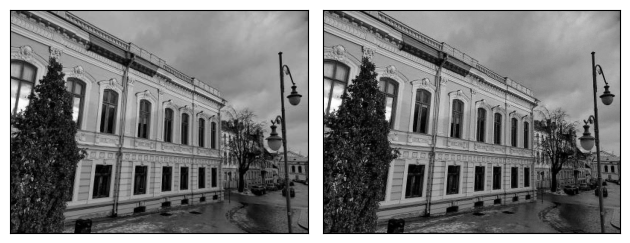

iteration [3001/4000], Loss: 0.00011282842751825228
iteration [3002/4000], Loss: 0.00010998161451425403
iteration [3003/4000], Loss: 0.00010941860819002613
iteration [3004/4000], Loss: 0.00010737762931967154
iteration [3005/4000], Loss: 0.00010788658255478367
iteration [3006/4000], Loss: 0.00010639500396791846
iteration [3007/4000], Loss: 0.00010785131598822773
iteration [3008/4000], Loss: 0.00011287609959254041
iteration [3009/4000], Loss: 0.00012183195940451697
iteration [3010/4000], Loss: 0.0001425388763891533
iteration [3011/4000], Loss: 0.00018999274470843375
iteration [3012/4000], Loss: 0.00026579966652207077
iteration [3013/4000], Loss: 0.0003982760536018759
iteration [3014/4000], Loss: 0.0004816160071641207
iteration [3015/4000], Loss: 0.0004197420203126967
iteration [3016/4000], Loss: 0.00032374871079809964
iteration [3017/4000], Loss: 0.00036161812022328377
iteration [3018/4000], Loss: 0.00043784096487797797
iteration [3019/4000], Loss: 0.0002634231932461262
iteration [3020/4

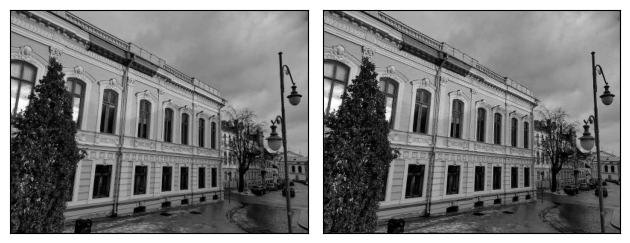

iteration [3026/4000], Loss: 0.00030607020016759634
iteration [3027/4000], Loss: 0.00021046730398666114
iteration [3028/4000], Loss: 0.00026582664577290416
iteration [3029/4000], Loss: 0.00021166699298191816
iteration [3030/4000], Loss: 0.00021014211233705282
iteration [3031/4000], Loss: 0.00021381073747761548
iteration [3032/4000], Loss: 0.00018290188745595515
iteration [3033/4000], Loss: 0.00019917641475331038
iteration [3034/4000], Loss: 0.00017005126574076712
iteration [3035/4000], Loss: 0.00016952432633843273
iteration [3036/4000], Loss: 0.0001682674919720739
iteration [3037/4000], Loss: 0.00015220479690469801
iteration [3038/4000], Loss: 0.00015537526633124799
iteration [3039/4000], Loss: 0.00014367885887622833
iteration [3040/4000], Loss: 0.00014057662338018417
iteration [3041/4000], Loss: 0.00013668897736351937
iteration [3042/4000], Loss: 0.0001327896461589262
iteration [3043/4000], Loss: 0.00012946016795467585
iteration [3044/4000], Loss: 0.0001258688571397215
iteration [3045

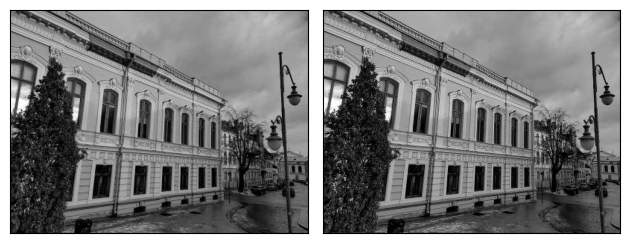

iteration [3051/4000], Loss: 0.00011074842041125521
iteration [3052/4000], Loss: 0.00011047557200072333
iteration [3053/4000], Loss: 0.00011053867638111115
iteration [3054/4000], Loss: 0.0001126754650613293
iteration [3055/4000], Loss: 0.00011745222582248971
iteration [3056/4000], Loss: 0.00012574989523272961
iteration [3057/4000], Loss: 0.00014304912474472076
iteration [3058/4000], Loss: 0.0001655133382882923
iteration [3059/4000], Loss: 0.00019752445223275572
iteration [3060/4000], Loss: 0.00022397766588255763
iteration [3061/4000], Loss: 0.00022748910123482347
iteration [3062/4000], Loss: 0.0001973377075046301
iteration [3063/4000], Loss: 0.0001587935839779675
iteration [3064/4000], Loss: 0.0001678092376096174
iteration [3065/4000], Loss: 0.0002131353976437822
iteration [3066/4000], Loss: 0.0002544074668549001
iteration [3067/4000], Loss: 0.0002058013342320919
iteration [3068/4000], Loss: 0.00014743657084181905
iteration [3069/4000], Loss: 0.00015674102178309113
iteration [3070/4000

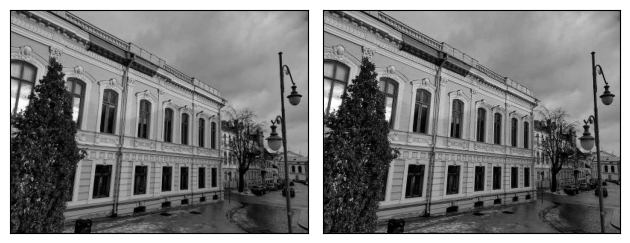

iteration [3076/4000], Loss: 0.00013975448382552713
iteration [3077/4000], Loss: 0.0001531898305984214
iteration [3078/4000], Loss: 0.00015442607400473207
iteration [3079/4000], Loss: 0.0001273876114282757
iteration [3080/4000], Loss: 0.00012247945414856076
iteration [3081/4000], Loss: 0.00013871192641090602
iteration [3082/4000], Loss: 0.00013035153097007424
iteration [3083/4000], Loss: 0.000124057027278468
iteration [3084/4000], Loss: 0.00013153422332834452
iteration [3085/4000], Loss: 0.00013342246529646218
iteration [3086/4000], Loss: 0.00012440697173587978
iteration [3087/4000], Loss: 0.00012375084043014795
iteration [3088/4000], Loss: 0.00012354635691735893
iteration [3089/4000], Loss: 0.00012129036622354761
iteration [3090/4000], Loss: 0.00011850593000417575
iteration [3091/4000], Loss: 0.00012340088142082095
iteration [3092/4000], Loss: 0.0001276982802664861
iteration [3093/4000], Loss: 0.00014048411685507745
iteration [3094/4000], Loss: 0.0001522089442005381
iteration [3095/40

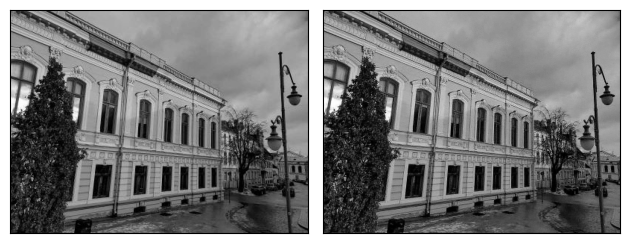

iteration [3101/4000], Loss: 0.00017238795408047736
iteration [3102/4000], Loss: 0.00018362038827035576
iteration [3103/4000], Loss: 0.00021319404186215252
iteration [3104/4000], Loss: 0.0002207015349995345
iteration [3105/4000], Loss: 0.00019085804524365813
iteration [3106/4000], Loss: 0.0001528899883851409
iteration [3107/4000], Loss: 0.00015185443044174463
iteration [3108/4000], Loss: 0.00017874885816127062
iteration [3109/4000], Loss: 0.00019072220311500132
iteration [3110/4000], Loss: 0.00016076139581855386
iteration [3111/4000], Loss: 0.0001357931032544002
iteration [3112/4000], Loss: 0.00014249600644689053
iteration [3113/4000], Loss: 0.0001513456372777
iteration [3114/4000], Loss: 0.00014430326700676233
iteration [3115/4000], Loss: 0.00013214134378358722
iteration [3116/4000], Loss: 0.0001299795403610915
iteration [3117/4000], Loss: 0.00012746205902658403
iteration [3118/4000], Loss: 0.00012947633513249457
iteration [3119/4000], Loss: 0.00012918472930323333
iteration [3120/4000

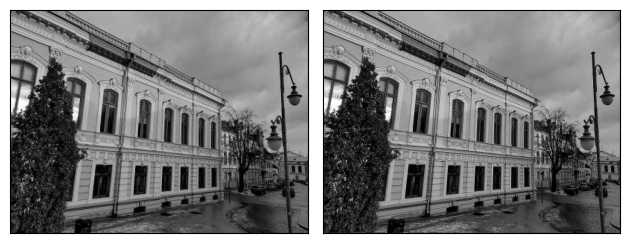

iteration [3126/4000], Loss: 0.00014906897558830678
iteration [3127/4000], Loss: 0.00014586032193619758
iteration [3128/4000], Loss: 0.0001424022630089894
iteration [3129/4000], Loss: 0.00013426574878394604
iteration [3130/4000], Loss: 0.0001288417843170464
iteration [3131/4000], Loss: 0.00013233070785645396
iteration [3132/4000], Loss: 0.00014041505346540362
iteration [3133/4000], Loss: 0.0001544583064969629
iteration [3134/4000], Loss: 0.0001620025868760422
iteration [3135/4000], Loss: 0.00017477372603025287
iteration [3136/4000], Loss: 0.0001600822142791003
iteration [3137/4000], Loss: 0.000146183927427046
iteration [3138/4000], Loss: 0.00013245560694485903
iteration [3139/4000], Loss: 0.00013763978495262563
iteration [3140/4000], Loss: 0.00016439515457022935
iteration [3141/4000], Loss: 0.00017411113367415965
iteration [3142/4000], Loss: 0.00018685204850044101
iteration [3143/4000], Loss: 0.00018007830658461899
iteration [3144/4000], Loss: 0.0001848662504926324
iteration [3145/4000

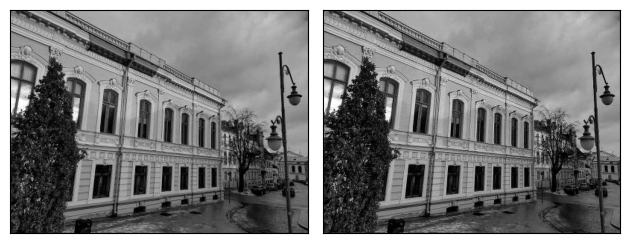

iteration [3151/4000], Loss: 0.00023026597045827657
iteration [3152/4000], Loss: 0.0002289130206918344
iteration [3153/4000], Loss: 0.00019710810738615692
iteration [3154/4000], Loss: 0.00019384114420972764
iteration [3155/4000], Loss: 0.00018839802942238748
iteration [3156/4000], Loss: 0.00016814432456158102
iteration [3157/4000], Loss: 0.00016480455815326422
iteration [3158/4000], Loss: 0.00015958715812303126
iteration [3159/4000], Loss: 0.00016349070938304067
iteration [3160/4000], Loss: 0.00014454814663622528
iteration [3161/4000], Loss: 0.0001379523891955614
iteration [3162/4000], Loss: 0.0001378750748699531
iteration [3163/4000], Loss: 0.00012882573355454952
iteration [3164/4000], Loss: 0.00011947962775593624
iteration [3165/4000], Loss: 0.00011807127157226205
iteration [3166/4000], Loss: 0.00011990060011157766
iteration [3167/4000], Loss: 0.00011818773054983467
iteration [3168/4000], Loss: 0.00011421281669754535
iteration [3169/4000], Loss: 0.00010814022971317172
iteration [3170

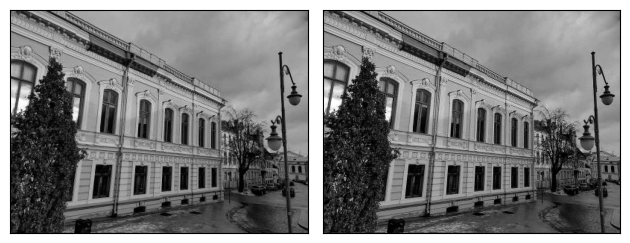

iteration [3176/4000], Loss: 0.0001006407110253349
iteration [3177/4000], Loss: 0.00010273758380208164
iteration [3178/4000], Loss: 0.00010703573207138106
iteration [3179/4000], Loss: 0.00011436166823841631
iteration [3180/4000], Loss: 0.00013134072651155293
iteration [3181/4000], Loss: 0.0001514731120551005
iteration [3182/4000], Loss: 0.00018619827460497618
iteration [3183/4000], Loss: 0.0002215652057202533
iteration [3184/4000], Loss: 0.0002652308321557939
iteration [3185/4000], Loss: 0.00025120677310042083
iteration [3186/4000], Loss: 0.00022755845566280186
iteration [3187/4000], Loss: 0.00022814735712017864
iteration [3188/4000], Loss: 0.00028727107564918697
iteration [3189/4000], Loss: 0.00040447062929160893
iteration [3190/4000], Loss: 0.0003136255545541644
iteration [3191/4000], Loss: 0.00022553141752723604
iteration [3192/4000], Loss: 0.00023807135585229844
iteration [3193/4000], Loss: 0.00026988208992406726
iteration [3194/4000], Loss: 0.0002200049493694678
iteration [3195/40

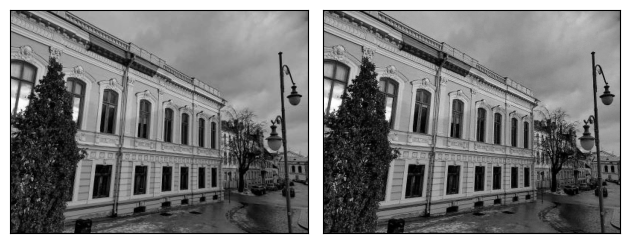

iteration [3201/4000], Loss: 0.00014950339391361922
iteration [3202/4000], Loss: 0.00015247678675223142
iteration [3203/4000], Loss: 0.0001305631740251556
iteration [3204/4000], Loss: 0.000135708149173297
iteration [3205/4000], Loss: 0.00013437312736641616
iteration [3206/4000], Loss: 0.00011620833538472652
iteration [3207/4000], Loss: 0.00012287743447814137
iteration [3208/4000], Loss: 0.00012042975868098438
iteration [3209/4000], Loss: 0.00010817491420311853
iteration [3210/4000], Loss: 0.0001130513337557204
iteration [3211/4000], Loss: 0.00011048728629248217
iteration [3212/4000], Loss: 0.000103202743048314
iteration [3213/4000], Loss: 0.000107031904917676
iteration [3214/4000], Loss: 0.00010249905608361587
iteration [3215/4000], Loss: 9.947733633453026e-05
iteration [3216/4000], Loss: 0.00010150842717848718
iteration [3217/4000], Loss: 9.935137495631352e-05
iteration [3218/4000], Loss: 9.988599776988849e-05
iteration [3219/4000], Loss: 0.00010463553917361423
iteration [3220/4000], 

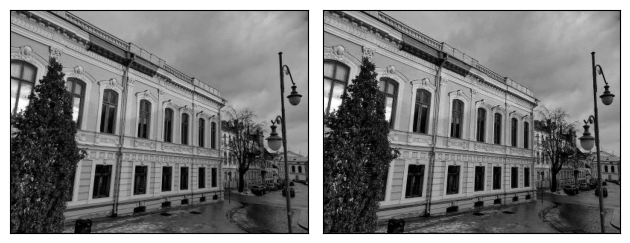

iteration [3226/4000], Loss: 0.00023792171850800514
iteration [3227/4000], Loss: 0.00021643104264512658
iteration [3228/4000], Loss: 0.00023681709717493504
iteration [3229/4000], Loss: 0.0002874010242521763
iteration [3230/4000], Loss: 0.0002884666610043496
iteration [3231/4000], Loss: 0.00020068093726877123
iteration [3232/4000], Loss: 0.00022713042562827468
iteration [3233/4000], Loss: 0.0002369172580074519
iteration [3234/4000], Loss: 0.00017038403893820941
iteration [3235/4000], Loss: 0.00017844604735728353
iteration [3236/4000], Loss: 0.00020597757247742265
iteration [3237/4000], Loss: 0.00016371496894862503
iteration [3238/4000], Loss: 0.00016595274792052805
iteration [3239/4000], Loss: 0.00017267698422074318
iteration [3240/4000], Loss: 0.0001441353524569422
iteration [3241/4000], Loss: 0.0001488832785980776
iteration [3242/4000], Loss: 0.0001425850496161729
iteration [3243/4000], Loss: 0.00012852592044509947
iteration [3244/4000], Loss: 0.00013706300524063408
iteration [3245/40

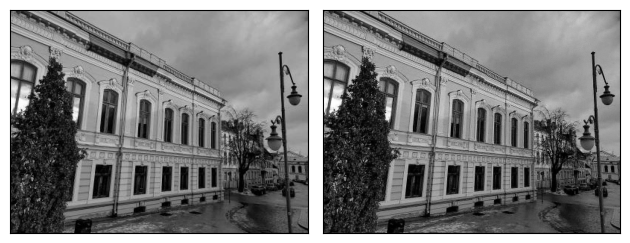

iteration [3251/4000], Loss: 0.00010508783452678472
iteration [3252/4000], Loss: 0.00010643266432452947
iteration [3253/4000], Loss: 0.00010668934555724263
iteration [3254/4000], Loss: 0.0001057348563335836
iteration [3255/4000], Loss: 0.0001124157352023758
iteration [3256/4000], Loss: 0.00011666890350170434
iteration [3257/4000], Loss: 0.0001281086733797565
iteration [3258/4000], Loss: 0.00014084255963098258
iteration [3259/4000], Loss: 0.00015991786494851112
iteration [3260/4000], Loss: 0.00015894912939984351
iteration [3261/4000], Loss: 0.00016030528058763593
iteration [3262/4000], Loss: 0.0001351420214632526
iteration [3263/4000], Loss: 0.00011784338857978582
iteration [3264/4000], Loss: 0.0001238087861565873
iteration [3265/4000], Loss: 0.00014176340482663363
iteration [3266/4000], Loss: 0.00016798167780507356
iteration [3267/4000], Loss: 0.00015672968584112823
iteration [3268/4000], Loss: 0.00014315824955701828
iteration [3269/4000], Loss: 0.00012947175127919763
iteration [3270/4

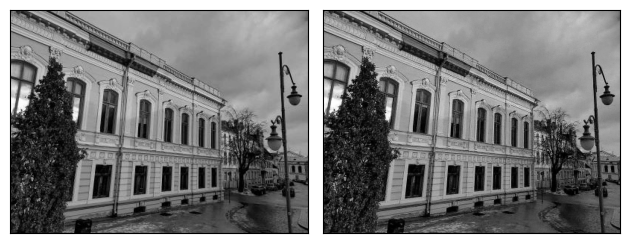

iteration [3276/4000], Loss: 0.00024116529675666243
iteration [3277/4000], Loss: 0.0002064666332444176
iteration [3278/4000], Loss: 0.0001997378858504817
iteration [3279/4000], Loss: 0.00022476987214758992
iteration [3280/4000], Loss: 0.00021799575188197196
iteration [3281/4000], Loss: 0.00016650889301672578
iteration [3282/4000], Loss: 0.00018032404477708042
iteration [3283/4000], Loss: 0.00019774842076003551
iteration [3284/4000], Loss: 0.00016551237786188722
iteration [3285/4000], Loss: 0.00014700843894388527
iteration [3286/4000], Loss: 0.00016626078286208212
iteration [3287/4000], Loss: 0.00013913356815464795
iteration [3288/4000], Loss: 0.00012090068048564717
iteration [3289/4000], Loss: 0.00013611877511721104
iteration [3290/4000], Loss: 0.0001253554510185495
iteration [3291/4000], Loss: 0.00011331179848639295
iteration [3292/4000], Loss: 0.0001192747731693089
iteration [3293/4000], Loss: 0.00011504519352456555
iteration [3294/4000], Loss: 0.00010351904347771779
iteration [3295/

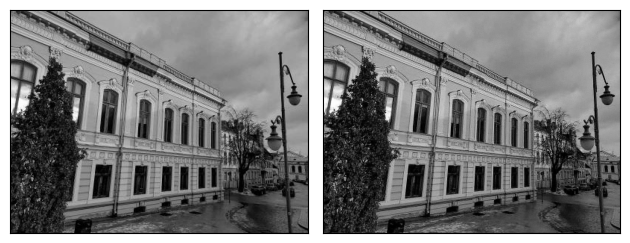

iteration [3301/4000], Loss: 9.778286766959354e-05
iteration [3302/4000], Loss: 0.00010197744268225506
iteration [3303/4000], Loss: 0.0001048378981067799
iteration [3304/4000], Loss: 0.00011061414261348546
iteration [3305/4000], Loss: 0.0001260530116269365
iteration [3306/4000], Loss: 0.00014460676175076514
iteration [3307/4000], Loss: 0.0001768233341863379
iteration [3308/4000], Loss: 0.00020831522124353796
iteration [3309/4000], Loss: 0.00024353624030482024
iteration [3310/4000], Loss: 0.0002393137983744964
iteration [3311/4000], Loss: 0.0001945246331160888
iteration [3312/4000], Loss: 0.0001449736737413332
iteration [3313/4000], Loss: 0.00014161953004077077
iteration [3314/4000], Loss: 0.0001961921079782769
iteration [3315/4000], Loss: 0.00021930647199042141
iteration [3316/4000], Loss: 0.00023356264864560217
iteration [3317/4000], Loss: 0.00016874652646947652
iteration [3318/4000], Loss: 0.0001569627202115953
iteration [3319/4000], Loss: 0.0001902488002087921
iteration [3320/4000],

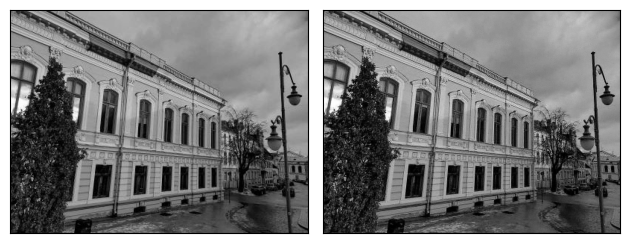

iteration [3326/4000], Loss: 0.00012677845370490104
iteration [3327/4000], Loss: 0.00012703514948952943
iteration [3328/4000], Loss: 0.00011617539712460712
iteration [3329/4000], Loss: 0.00011403300595702603
iteration [3330/4000], Loss: 0.0001122481407946907
iteration [3331/4000], Loss: 0.0001055552638717927
iteration [3332/4000], Loss: 0.00010354960977565497
iteration [3333/4000], Loss: 0.00010430894326418638
iteration [3334/4000], Loss: 0.00010004751675296575
iteration [3335/4000], Loss: 9.585829684510827e-05
iteration [3336/4000], Loss: 9.687433339422569e-05
iteration [3337/4000], Loss: 9.614278678782284e-05
iteration [3338/4000], Loss: 9.406809840584174e-05
iteration [3339/4000], Loss: 9.441014844924212e-05
iteration [3340/4000], Loss: 9.440643043490127e-05
iteration [3341/4000], Loss: 9.64100836426951e-05
iteration [3342/4000], Loss: 0.00010052239667857066
iteration [3343/4000], Loss: 0.00010568563448032364
iteration [3344/4000], Loss: 0.00011351024295436218
iteration [3345/4000],

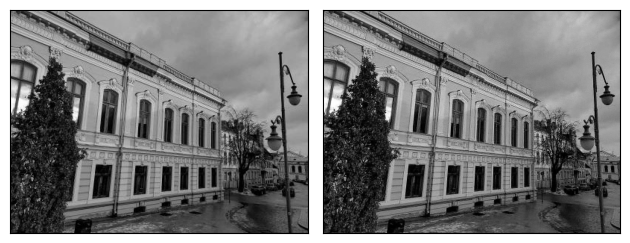

iteration [3351/4000], Loss: 0.00011459105735411867
iteration [3352/4000], Loss: 0.00012485946353990585
iteration [3353/4000], Loss: 0.00015429711493197829
iteration [3354/4000], Loss: 0.00018596983863972127
iteration [3355/4000], Loss: 0.0002093087532557547
iteration [3356/4000], Loss: 0.00021706857660319656
iteration [3357/4000], Loss: 0.00021589967946056277
iteration [3358/4000], Loss: 0.0002285116643179208
iteration [3359/4000], Loss: 0.00024369815946556628
iteration [3360/4000], Loss: 0.0002140903234248981
iteration [3361/4000], Loss: 0.00018340506358072162
iteration [3362/4000], Loss: 0.00017028495494741946
iteration [3363/4000], Loss: 0.00019430408428888768
iteration [3364/4000], Loss: 0.00019808545766863972
iteration [3365/4000], Loss: 0.00017820320499595255
iteration [3366/4000], Loss: 0.00015672610606998205
iteration [3367/4000], Loss: 0.00015119221643544734
iteration [3368/4000], Loss: 0.00015715342306066304
iteration [3369/4000], Loss: 0.00014592411753255874
iteration [3370

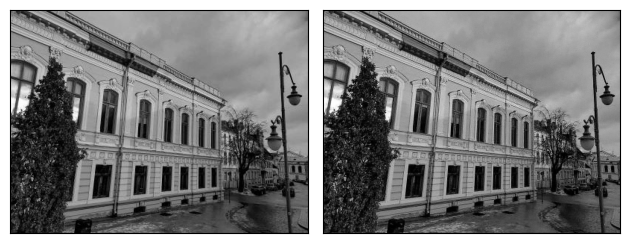

iteration [3376/4000], Loss: 0.00011487682786537334
iteration [3377/4000], Loss: 0.00011625893966993317
iteration [3378/4000], Loss: 0.0001058072957675904
iteration [3379/4000], Loss: 0.00010620724788168445
iteration [3380/4000], Loss: 0.00010377273429185152
iteration [3381/4000], Loss: 9.729449811857194e-05
iteration [3382/4000], Loss: 9.685085387900472e-05
iteration [3383/4000], Loss: 9.526276699034497e-05
iteration [3384/4000], Loss: 9.196693281410262e-05
iteration [3385/4000], Loss: 9.485940972808748e-05
iteration [3386/4000], Loss: 9.757547377375886e-05
iteration [3387/4000], Loss: 0.00010241430572932586
iteration [3388/4000], Loss: 0.00010978039063047618
iteration [3389/4000], Loss: 0.0001317875285167247
iteration [3390/4000], Loss: 0.0001528666471131146
iteration [3391/4000], Loss: 0.0002034976932918653
iteration [3392/4000], Loss: 0.00022823517792858183
iteration [3393/4000], Loss: 0.0002765962854027748
iteration [3394/4000], Loss: 0.0002295019367011264
iteration [3395/4000], L

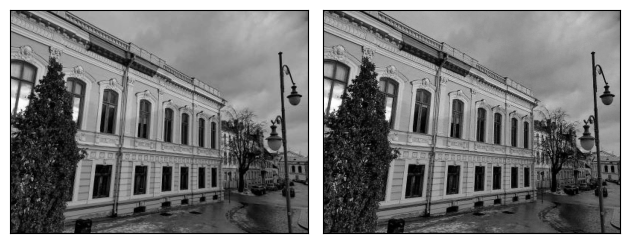

iteration [3401/4000], Loss: 0.00022481175255961716
iteration [3402/4000], Loss: 0.00016036706801969558
iteration [3403/4000], Loss: 0.00012867678015027195
iteration [3404/4000], Loss: 0.00015425866877194494
iteration [3405/4000], Loss: 0.00014602595183532685
iteration [3406/4000], Loss: 0.00012509430234786123
iteration [3407/4000], Loss: 0.0001191818155348301
iteration [3408/4000], Loss: 0.00012310146121308208
iteration [3409/4000], Loss: 0.00012248130224179476
iteration [3410/4000], Loss: 0.0001087249765987508
iteration [3411/4000], Loss: 0.00011222545435884967
iteration [3412/4000], Loss: 0.00011780405475292355
iteration [3413/4000], Loss: 0.00010656820086296648
iteration [3414/4000], Loss: 0.00010539848153712228
iteration [3415/4000], Loss: 0.00011528436152730137
iteration [3416/4000], Loss: 0.00011595011164899915
iteration [3417/4000], Loss: 0.00011958282993873581
iteration [3418/4000], Loss: 0.00012353532656561583
iteration [3419/4000], Loss: 0.00013997532369103283
iteration [342

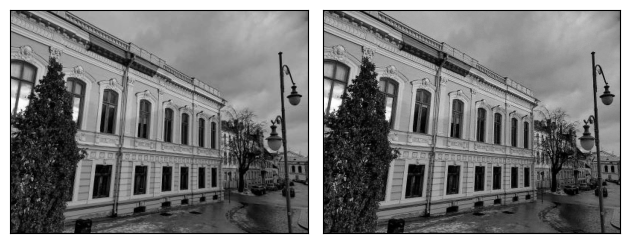

iteration [3426/4000], Loss: 0.000121909542940557
iteration [3427/4000], Loss: 0.00013131674495525658
iteration [3428/4000], Loss: 0.00014242423640098423
iteration [3429/4000], Loss: 0.00014309812104329467
iteration [3430/4000], Loss: 0.0001516268093837425
iteration [3431/4000], Loss: 0.0001662405556999147
iteration [3432/4000], Loss: 0.00019509444246068597
iteration [3433/4000], Loss: 0.00023760547628626227
iteration [3434/4000], Loss: 0.0002503346768207848
iteration [3435/4000], Loss: 0.00023193901870399714
iteration [3436/4000], Loss: 0.00019160502415616065
iteration [3437/4000], Loss: 0.0001833315909607336
iteration [3438/4000], Loss: 0.00018357328372076154
iteration [3439/4000], Loss: 0.0001680670538917184
iteration [3440/4000], Loss: 0.00015233283920679241
iteration [3441/4000], Loss: 0.00015435424575116485
iteration [3442/4000], Loss: 0.00016257374954875559
iteration [3443/4000], Loss: 0.00014725475921295583
iteration [3444/4000], Loss: 0.0001455998426536098
iteration [3445/4000

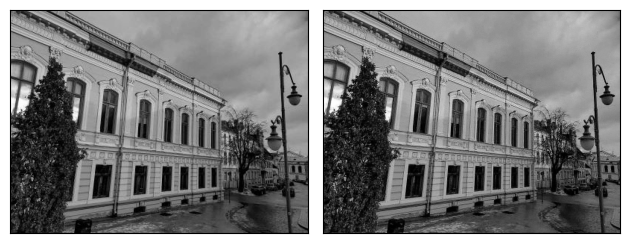

iteration [3451/4000], Loss: 0.00010367415961809456
iteration [3452/4000], Loss: 0.00010409124661237001
iteration [3453/4000], Loss: 0.000101303136034403
iteration [3454/4000], Loss: 9.5572009740863e-05
iteration [3455/4000], Loss: 9.855793177848682e-05
iteration [3456/4000], Loss: 9.700383816380054e-05
iteration [3457/4000], Loss: 9.522876644041389e-05
iteration [3458/4000], Loss: 9.603101352695376e-05
iteration [3459/4000], Loss: 9.56178701017052e-05
iteration [3460/4000], Loss: 9.359671093989164e-05
iteration [3461/4000], Loss: 9.47781591094099e-05
iteration [3462/4000], Loss: 9.352339839097112e-05
iteration [3463/4000], Loss: 9.234126628143713e-05
iteration [3464/4000], Loss: 9.472632518736646e-05
iteration [3465/4000], Loss: 9.662008233135566e-05
iteration [3466/4000], Loss: 0.00010365194611949846
iteration [3467/4000], Loss: 0.0001167516820714809
iteration [3468/4000], Loss: 0.00013794275582768023
iteration [3469/4000], Loss: 0.0001709917705738917
iteration [3470/4000], Loss: 0.0

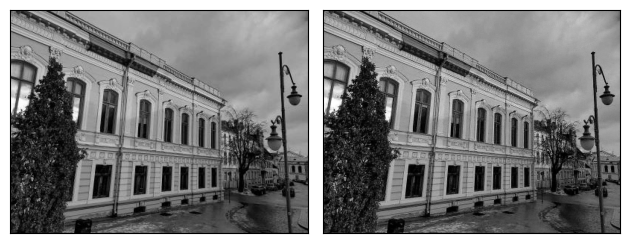

iteration [3476/4000], Loss: 0.00020462996326386929
iteration [3477/4000], Loss: 0.0001945748954312876
iteration [3478/4000], Loss: 0.00014250037202145904
iteration [3479/4000], Loss: 0.00013314174429979175
iteration [3480/4000], Loss: 0.00016197116929106414
iteration [3481/4000], Loss: 0.0001491043803980574
iteration [3482/4000], Loss: 0.0001165578723885119
iteration [3483/4000], Loss: 0.00012053327372996137
iteration [3484/4000], Loss: 0.00013475034211296588
iteration [3485/4000], Loss: 0.00012270685692783445
iteration [3486/4000], Loss: 0.00010313291568309069
iteration [3487/4000], Loss: 0.00011404271936044097
iteration [3488/4000], Loss: 0.00011612412345129997
iteration [3489/4000], Loss: 0.00010003130591940135
iteration [3490/4000], Loss: 9.448412311030552e-05
iteration [3491/4000], Loss: 0.00010328675125492737
iteration [3492/4000], Loss: 0.00010071490396512672
iteration [3493/4000], Loss: 9.646833495935425e-05
iteration [3494/4000], Loss: 0.00010434955038363114
iteration [3495/4

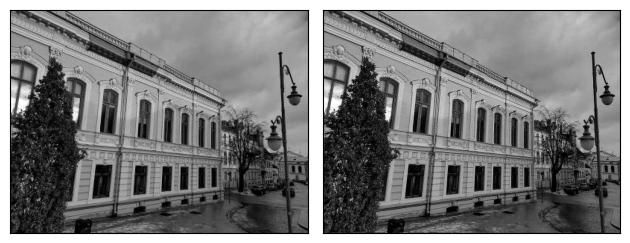

iteration [3501/4000], Loss: 0.0001445434900233522
iteration [3502/4000], Loss: 0.00013760439469479024
iteration [3503/4000], Loss: 0.00013885412772651762
iteration [3504/4000], Loss: 0.00016664112627040595
iteration [3505/4000], Loss: 0.00019424162746872753
iteration [3506/4000], Loss: 0.00018506307969801128
iteration [3507/4000], Loss: 0.000145791593240574
iteration [3508/4000], Loss: 0.00012875828542746603
iteration [3509/4000], Loss: 0.00014426505367737263
iteration [3510/4000], Loss: 0.0001605959259904921
iteration [3511/4000], Loss: 0.00014905392890796065
iteration [3512/4000], Loss: 0.00012549890379887074
iteration [3513/4000], Loss: 0.00013020855840295553
iteration [3514/4000], Loss: 0.0001449171977583319
iteration [3515/4000], Loss: 0.00015373867063317448
iteration [3516/4000], Loss: 0.00015399885887745768
iteration [3517/4000], Loss: 0.00015571987023577094
iteration [3518/4000], Loss: 0.0001579245290486142
iteration [3519/4000], Loss: 0.000163168107974343
iteration [3520/4000

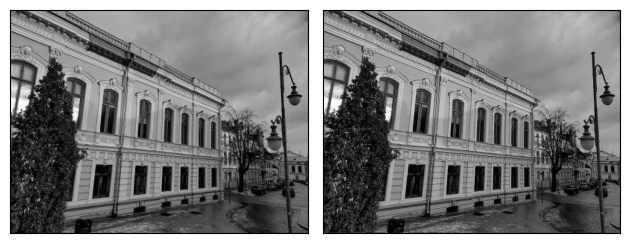

iteration [3526/4000], Loss: 0.00014872557949274778
iteration [3527/4000], Loss: 0.00013753621897194535
iteration [3528/4000], Loss: 0.00014197533892001957
iteration [3529/4000], Loss: 0.00014957974781282246
iteration [3530/4000], Loss: 0.00014479552919510752
iteration [3531/4000], Loss: 0.0001439736079191789
iteration [3532/4000], Loss: 0.00012955054990015924
iteration [3533/4000], Loss: 0.0001137293002102524
iteration [3534/4000], Loss: 0.00010147664579562843
iteration [3535/4000], Loss: 0.00010409650712972507
iteration [3536/4000], Loss: 0.00011000705853803083
iteration [3537/4000], Loss: 0.00011340408673277125
iteration [3538/4000], Loss: 0.00010834647400770336
iteration [3539/4000], Loss: 9.788831084733829e-05
iteration [3540/4000], Loss: 9.647935075918213e-05
iteration [3541/4000], Loss: 9.788211900740862e-05
iteration [3542/4000], Loss: 9.597132884664461e-05
iteration [3543/4000], Loss: 9.525819041300565e-05
iteration [3544/4000], Loss: 9.379251423524693e-05
iteration [3545/4000

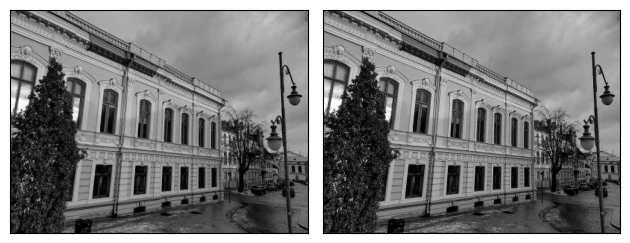

iteration [3551/4000], Loss: 9.472788224229589e-05
iteration [3552/4000], Loss: 0.00010131564340554178
iteration [3553/4000], Loss: 0.00010594425111776218
iteration [3554/4000], Loss: 0.00012055281695211306
iteration [3555/4000], Loss: 0.00013625519932247698
iteration [3556/4000], Loss: 0.00017575777019374073
iteration [3557/4000], Loss: 0.0001941072550835088
iteration [3558/4000], Loss: 0.00023341587802860886
iteration [3559/4000], Loss: 0.00021473942615557462
iteration [3560/4000], Loss: 0.00020076060900464654
iteration [3561/4000], Loss: 0.00017317634774371982
iteration [3562/4000], Loss: 0.00017099856631830335
iteration [3563/4000], Loss: 0.00018318532966077328
iteration [3564/4000], Loss: 0.00017480827227700502
iteration [3565/4000], Loss: 0.00016428208618890494
iteration [3566/4000], Loss: 0.0001494333118898794
iteration [3567/4000], Loss: 0.00014557161193806678
iteration [3568/4000], Loss: 0.0001486723922425881
iteration [3569/4000], Loss: 0.00014879362424835563
iteration [3570/

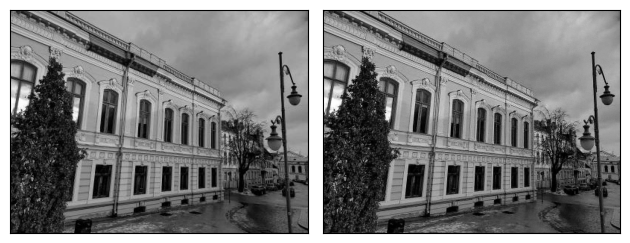

iteration [3576/4000], Loss: 0.0001282575831282884
iteration [3577/4000], Loss: 0.0001249036140507087
iteration [3578/4000], Loss: 0.00011382925731595606
iteration [3579/4000], Loss: 0.00011189594079041854
iteration [3580/4000], Loss: 0.0001106676209019497
iteration [3581/4000], Loss: 0.0001100082736229524
iteration [3582/4000], Loss: 0.0001167187001556158
iteration [3583/4000], Loss: 0.00012870664068032056
iteration [3584/4000], Loss: 0.00015100435120984912
iteration [3585/4000], Loss: 0.00017427426064386964
iteration [3586/4000], Loss: 0.0001979299122467637
iteration [3587/4000], Loss: 0.00020985623996239156
iteration [3588/4000], Loss: 0.00019033053831662983
iteration [3589/4000], Loss: 0.00015048238856252283
iteration [3590/4000], Loss: 0.0001283111923839897
iteration [3591/4000], Loss: 0.00013269076589494944
iteration [3592/4000], Loss: 0.00014380671200342476
iteration [3593/4000], Loss: 0.0001458683836972341
iteration [3594/4000], Loss: 0.00012923574831802398
iteration [3595/4000

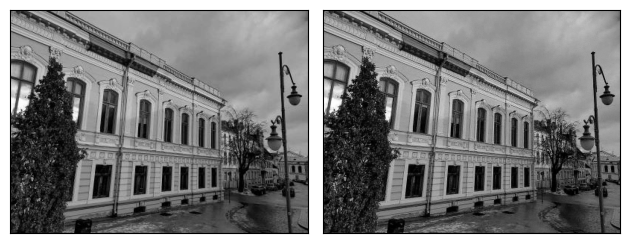

iteration [3601/4000], Loss: 9.332124318461865e-05
iteration [3602/4000], Loss: 9.630448766984046e-05
iteration [3603/4000], Loss: 9.770131873665377e-05
iteration [3604/4000], Loss: 9.305591811425984e-05
iteration [3605/4000], Loss: 8.960960258264095e-05
iteration [3606/4000], Loss: 8.936053927754983e-05
iteration [3607/4000], Loss: 9.353252971777692e-05
iteration [3608/4000], Loss: 9.762023546500131e-05
iteration [3609/4000], Loss: 0.00010018322063842788
iteration [3610/4000], Loss: 0.00010449643013998866
iteration [3611/4000], Loss: 0.00011753924627555534
iteration [3612/4000], Loss: 0.00013553028111346066
iteration [3613/4000], Loss: 0.00016266675083898008
iteration [3614/4000], Loss: 0.00018078161519952118
iteration [3615/4000], Loss: 0.00019063054060097784
iteration [3616/4000], Loss: 0.00018216752505395561
iteration [3617/4000], Loss: 0.00018453117809258401
iteration [3618/4000], Loss: 0.000215039006434381
iteration [3619/4000], Loss: 0.0002314425219083205
iteration [3620/4000], 

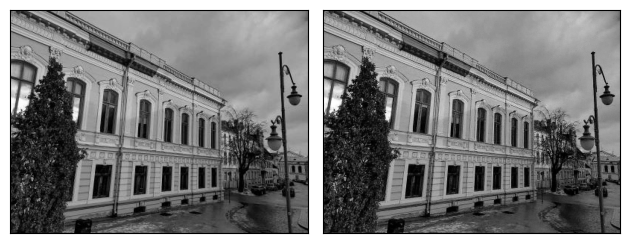

iteration [3626/4000], Loss: 0.0001644580188440159
iteration [3627/4000], Loss: 0.0001581846154294908
iteration [3628/4000], Loss: 0.00016130218864418566
iteration [3629/4000], Loss: 0.00014671043027192354
iteration [3630/4000], Loss: 0.00014327770622912794
iteration [3631/4000], Loss: 0.0001409791293554008
iteration [3632/4000], Loss: 0.0001257024414371699
iteration [3633/4000], Loss: 0.0001209065958391875
iteration [3634/4000], Loss: 0.00011934765643673018
iteration [3635/4000], Loss: 0.00010759480210253969
iteration [3636/4000], Loss: 0.00010702727740863338
iteration [3637/4000], Loss: 0.00010380144522059709
iteration [3638/4000], Loss: 9.864312596619129e-05
iteration [3639/4000], Loss: 9.770346514414996e-05
iteration [3640/4000], Loss: 9.529809904051945e-05
iteration [3641/4000], Loss: 9.402370051247999e-05
iteration [3642/4000], Loss: 9.682793461252004e-05
iteration [3643/4000], Loss: 9.445707109989598e-05
iteration [3644/4000], Loss: 9.686995326774195e-05
iteration [3645/4000], L

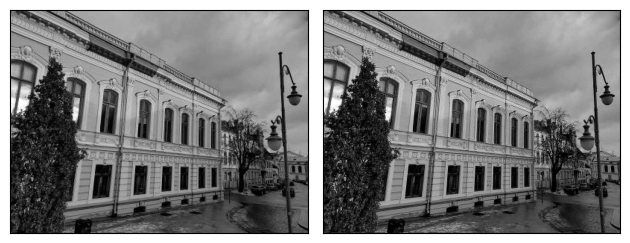

iteration [3651/4000], Loss: 0.00011175664985785261
iteration [3652/4000], Loss: 0.00011208948853891343
iteration [3653/4000], Loss: 0.00010411308176117018
iteration [3654/4000], Loss: 0.00010433130228193477
iteration [3655/4000], Loss: 0.00011118299153167754
iteration [3656/4000], Loss: 0.00012748860171996057
iteration [3657/4000], Loss: 0.00015084142796695232
iteration [3658/4000], Loss: 0.00017736482550390065
iteration [3659/4000], Loss: 0.00018291398009750992
iteration [3660/4000], Loss: 0.00016772473463788629
iteration [3661/4000], Loss: 0.00014597644621971995
iteration [3662/4000], Loss: 0.00014851878222543746
iteration [3663/4000], Loss: 0.00017503739218227565
iteration [3664/4000], Loss: 0.00014876249770168215
iteration [3665/4000], Loss: 0.00012494350085034966
iteration [3666/4000], Loss: 0.00014059257227927446
iteration [3667/4000], Loss: 0.00017575394304003567
iteration [3668/4000], Loss: 0.00017493015911895782
iteration [3669/4000], Loss: 0.0001494526950409636
iteration [36

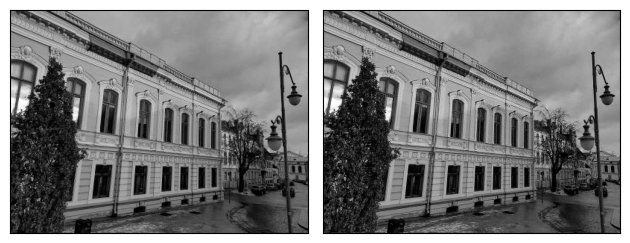

iteration [3676/4000], Loss: 0.00011789376003434882
iteration [3677/4000], Loss: 0.00013581968960352242
iteration [3678/4000], Loss: 0.0001266636827494949
iteration [3679/4000], Loss: 0.00011162020382471383
iteration [3680/4000], Loss: 0.00011283022467978299
iteration [3681/4000], Loss: 0.00011366737453499809
iteration [3682/4000], Loss: 0.00010603912960505113
iteration [3683/4000], Loss: 0.00010810524690896273
iteration [3684/4000], Loss: 0.00011110772175015882
iteration [3685/4000], Loss: 0.00010726506297942251
iteration [3686/4000], Loss: 0.00010479870979906991
iteration [3687/4000], Loss: 0.0001098821303457953
iteration [3688/4000], Loss: 0.00010987394489347935
iteration [3689/4000], Loss: 0.00010824362834682688
iteration [3690/4000], Loss: 0.00010952926822938025
iteration [3691/4000], Loss: 0.00011383472883608192
iteration [3692/4000], Loss: 0.00011509058094816282
iteration [3693/4000], Loss: 0.00012352665362413973
iteration [3694/4000], Loss: 0.00013348256470635533
iteration [369

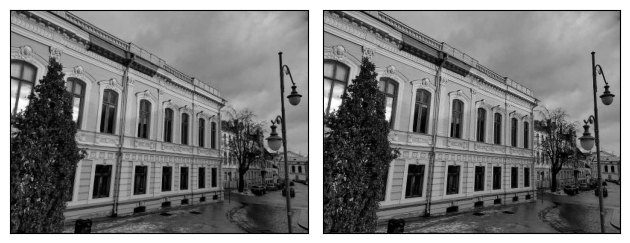

iteration [3701/4000], Loss: 0.00011765603994717821
iteration [3702/4000], Loss: 0.000128293497255072
iteration [3703/4000], Loss: 0.00012882718874607235
iteration [3704/4000], Loss: 0.00011840555816888809
iteration [3705/4000], Loss: 0.00010929713607765734
iteration [3706/4000], Loss: 0.0001028623228194192
iteration [3707/4000], Loss: 0.00010090805881191045
iteration [3708/4000], Loss: 9.922172466758639e-05
iteration [3709/4000], Loss: 0.00010432849376229569
iteration [3710/4000], Loss: 0.00010338659194530919
iteration [3711/4000], Loss: 0.00010367401409894228
iteration [3712/4000], Loss: 9.267576388083398e-05
iteration [3713/4000], Loss: 9.100494207814336e-05
iteration [3714/4000], Loss: 9.995161963161081e-05
iteration [3715/4000], Loss: 0.00011414394248276949
iteration [3716/4000], Loss: 0.00011292658018646762
iteration [3717/4000], Loss: 0.00011370224819984287
iteration [3718/4000], Loss: 0.00011361815995769575
iteration [3719/4000], Loss: 0.00013728927297051996
iteration [3720/400

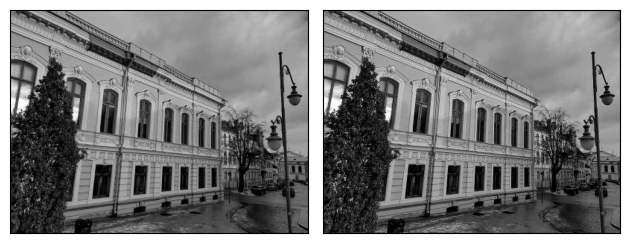

iteration [3726/4000], Loss: 0.0001644579751882702
iteration [3727/4000], Loss: 0.00016502819198649377
iteration [3728/4000], Loss: 0.00017588972696103156
iteration [3729/4000], Loss: 0.00017035331984516233
iteration [3730/4000], Loss: 0.00016424454224761575
iteration [3731/4000], Loss: 0.0001652678765822202
iteration [3732/4000], Loss: 0.00018171450938098133
iteration [3733/4000], Loss: 0.00015402727876789868
iteration [3734/4000], Loss: 0.0001297266426263377
iteration [3735/4000], Loss: 0.00013588782167062163
iteration [3736/4000], Loss: 0.00013598041550721973
iteration [3737/4000], Loss: 0.00012929082731716335
iteration [3738/4000], Loss: 0.00012473571405280381
iteration [3739/4000], Loss: 0.00011546751920832321
iteration [3740/4000], Loss: 9.557301382301375e-05
iteration [3741/4000], Loss: 9.803023567656055e-05
iteration [3742/4000], Loss: 9.94375950540416e-05
iteration [3743/4000], Loss: 8.918136154534295e-05
iteration [3744/4000], Loss: 9.171692363452166e-05
iteration [3745/4000]

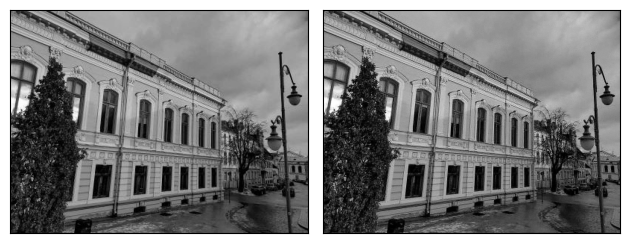

iteration [3751/4000], Loss: 8.480699034407735e-05
iteration [3752/4000], Loss: 8.465652354061604e-05
iteration [3753/4000], Loss: 8.996496762847528e-05
iteration [3754/4000], Loss: 9.412546933162957e-05
iteration [3755/4000], Loss: 0.00010294505773345008
iteration [3756/4000], Loss: 0.00011809275019913912
iteration [3757/4000], Loss: 0.00014631131489295512
iteration [3758/4000], Loss: 0.00016943784430623055
iteration [3759/4000], Loss: 0.00021123279293533415
iteration [3760/4000], Loss: 0.00019096497271675617
iteration [3761/4000], Loss: 0.00016354478430002928
iteration [3762/4000], Loss: 0.00012443281593732536
iteration [3763/4000], Loss: 0.0001335423585260287
iteration [3764/4000], Loss: 0.00017439492512494326
iteration [3765/4000], Loss: 0.00018118387379217893
iteration [3766/4000], Loss: 0.00016087105905171484
iteration [3767/4000], Loss: 0.00014797442418057472
iteration [3768/4000], Loss: 0.00016812401008792222
iteration [3769/4000], Loss: 0.00017301112529821694
iteration [3770/4

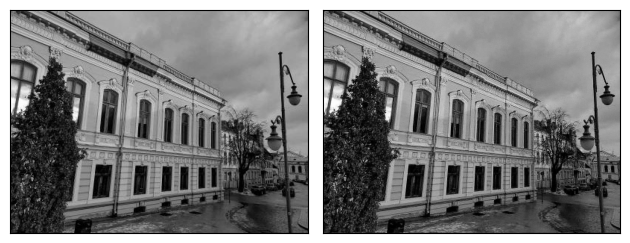

iteration [3776/4000], Loss: 0.0001489919377490878
iteration [3777/4000], Loss: 0.00012726073327939957
iteration [3778/4000], Loss: 0.0001124236878240481
iteration [3779/4000], Loss: 0.00011362888471921906
iteration [3780/4000], Loss: 0.00010417582234367728
iteration [3781/4000], Loss: 9.515188867226243e-05
iteration [3782/4000], Loss: 9.930235682986677e-05
iteration [3783/4000], Loss: 9.688240970717743e-05
iteration [3784/4000], Loss: 9.034278627950698e-05
iteration [3785/4000], Loss: 8.810189319774508e-05
iteration [3786/4000], Loss: 9.02183455764316e-05
iteration [3787/4000], Loss: 8.676795550854877e-05
iteration [3788/4000], Loss: 8.673526463098824e-05
iteration [3789/4000], Loss: 9.028244676301256e-05
iteration [3790/4000], Loss: 9.455868712393567e-05
iteration [3791/4000], Loss: 0.00010414877033326775
iteration [3792/4000], Loss: 0.00011458335939096287
iteration [3793/4000], Loss: 0.0001362285838695243
iteration [3794/4000], Loss: 0.00015787515440024436
iteration [3795/4000], Los

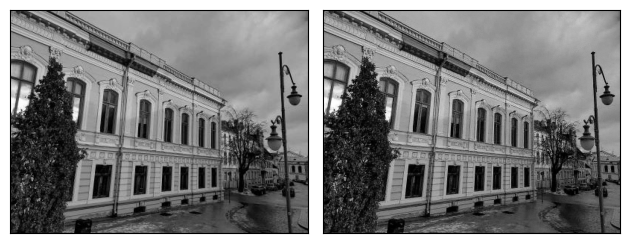

iteration [3801/4000], Loss: 0.00020612771913874894
iteration [3802/4000], Loss: 0.00020695972489193082
iteration [3803/4000], Loss: 0.0001693939557299018
iteration [3804/4000], Loss: 0.00012368096213322133
iteration [3805/4000], Loss: 0.0001338928850600496
iteration [3806/4000], Loss: 0.00014923009439371526
iteration [3807/4000], Loss: 0.00013333812239579856
iteration [3808/4000], Loss: 0.00011026868742192164
iteration [3809/4000], Loss: 0.00011420225928304717
iteration [3810/4000], Loss: 0.00011443356197560206
iteration [3811/4000], Loss: 0.00010272877989336848
iteration [3812/4000], Loss: 9.899607539409772e-05
iteration [3813/4000], Loss: 9.757811494637281e-05
iteration [3814/4000], Loss: 9.338450763607398e-05
iteration [3815/4000], Loss: 9.135647269431502e-05
iteration [3816/4000], Loss: 8.66334667080082e-05
iteration [3817/4000], Loss: 8.24743983685039e-05
iteration [3818/4000], Loss: 8.172535308403894e-05
iteration [3819/4000], Loss: 7.990235462784767e-05
iteration [3820/4000], L

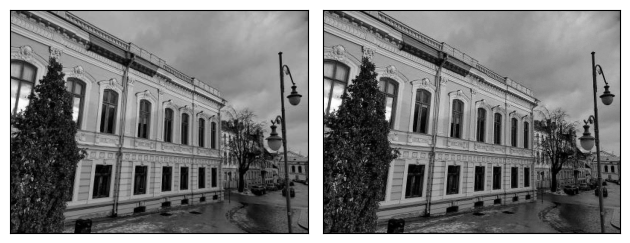

iteration [3826/4000], Loss: 7.69061443861574e-05
iteration [3827/4000], Loss: 7.914668822195381e-05
iteration [3828/4000], Loss: 8.833298488752916e-05
iteration [3829/4000], Loss: 0.00010068721894640476
iteration [3830/4000], Loss: 0.00012485581100918353
iteration [3831/4000], Loss: 0.00013188438606448472
iteration [3832/4000], Loss: 0.00014071159239392728
iteration [3833/4000], Loss: 0.00011997511319350451
iteration [3834/4000], Loss: 0.00010617227235343307
iteration [3835/4000], Loss: 0.0001244125742232427
iteration [3836/4000], Loss: 0.00016297525144182146
iteration [3837/4000], Loss: 0.00022154097678139806
iteration [3838/4000], Loss: 0.00018769607413560152
iteration [3839/4000], Loss: 0.00016163325926754624
iteration [3840/4000], Loss: 0.0001767810172168538
iteration [3841/4000], Loss: 0.00019785197218880057
iteration [3842/4000], Loss: 0.00020685374329332262
iteration [3843/4000], Loss: 0.00017872708849608898
iteration [3844/4000], Loss: 0.00019882689230144024
iteration [3845/40

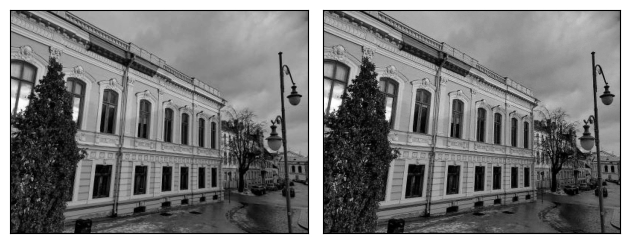

iteration [3851/4000], Loss: 0.00014041882241144776
iteration [3852/4000], Loss: 0.00011305024236207828
iteration [3853/4000], Loss: 0.00010999269579770043
iteration [3854/4000], Loss: 0.0001146960275946185
iteration [3855/4000], Loss: 9.60625329753384e-05
iteration [3856/4000], Loss: 9.413772204425186e-05
iteration [3857/4000], Loss: 9.975740249501541e-05
iteration [3858/4000], Loss: 9.275357297156006e-05
iteration [3859/4000], Loss: 8.551483188057318e-05
iteration [3860/4000], Loss: 8.87299538590014e-05
iteration [3861/4000], Loss: 8.432930189883336e-05
iteration [3862/4000], Loss: 7.964543328853324e-05
iteration [3863/4000], Loss: 8.351814176421613e-05
iteration [3864/4000], Loss: 8.275203435914591e-05
iteration [3865/4000], Loss: 8.204630285035819e-05
iteration [3866/4000], Loss: 8.95305784069933e-05
iteration [3867/4000], Loss: 9.271914314012975e-05
iteration [3868/4000], Loss: 0.00010770052176667377
iteration [3869/4000], Loss: 0.00011925210856134072
iteration [3870/4000], Loss: 

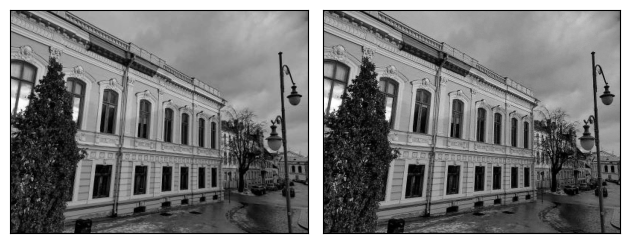

iteration [3876/4000], Loss: 0.0001491453149355948
iteration [3877/4000], Loss: 0.00019443222845438868
iteration [3878/4000], Loss: 0.00021394577925093472
iteration [3879/4000], Loss: 0.00019515608437359333
iteration [3880/4000], Loss: 0.0001817738520912826
iteration [3881/4000], Loss: 0.00021124140766914934
iteration [3882/4000], Loss: 0.00027756011695601046
iteration [3883/4000], Loss: 0.00021898465638514608
iteration [3884/4000], Loss: 0.0001575087517267093
iteration [3885/4000], Loss: 0.00016903130745049566
iteration [3886/4000], Loss: 0.00018439124687574804
iteration [3887/4000], Loss: 0.0001608041930012405
iteration [3888/4000], Loss: 0.00014572434884030372
iteration [3889/4000], Loss: 0.00016600691014900804
iteration [3890/4000], Loss: 0.00015512574464082718
iteration [3891/4000], Loss: 0.0001336478308076039
iteration [3892/4000], Loss: 0.00013652608322445303
iteration [3893/4000], Loss: 0.0001334772096015513
iteration [3894/4000], Loss: 0.00011760853521991521
iteration [3895/40

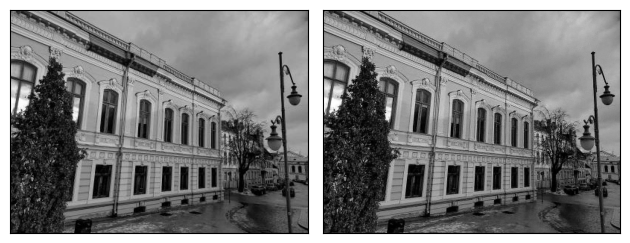

iteration [3901/4000], Loss: 8.639267616672441e-05
iteration [3902/4000], Loss: 8.386938861804083e-05
iteration [3903/4000], Loss: 8.379176870221272e-05
iteration [3904/4000], Loss: 8.164529572241008e-05
iteration [3905/4000], Loss: 8.103079744614661e-05
iteration [3906/4000], Loss: 8.02077556727454e-05
iteration [3907/4000], Loss: 8.044934656936675e-05
iteration [3908/4000], Loss: 8.094077202258632e-05
iteration [3909/4000], Loss: 8.26409159344621e-05
iteration [3910/4000], Loss: 8.495780639350414e-05
iteration [3911/4000], Loss: 8.931916090659797e-05
iteration [3912/4000], Loss: 9.493288962403312e-05
iteration [3913/4000], Loss: 0.00010131332965102047
iteration [3914/4000], Loss: 0.00010539484355831519
iteration [3915/4000], Loss: 0.00010960514919133857
iteration [3916/4000], Loss: 0.00010857163579203188
iteration [3917/4000], Loss: 0.00010222988930763677
iteration [3918/4000], Loss: 9.450081415707245e-05
iteration [3919/4000], Loss: 9.593399590812624e-05
iteration [3920/4000], Loss:

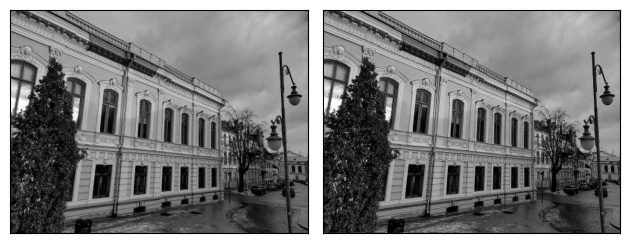

iteration [3926/4000], Loss: 0.00012078376312274486
iteration [3927/4000], Loss: 0.00013926181418355554
iteration [3928/4000], Loss: 0.000158531911438331
iteration [3929/4000], Loss: 0.00013279597624205053
iteration [3930/4000], Loss: 0.00010381965694250539
iteration [3931/4000], Loss: 0.00011484343121992424
iteration [3932/4000], Loss: 0.0001256110263057053
iteration [3933/4000], Loss: 0.00011731265840353444
iteration [3934/4000], Loss: 0.00010724578169174492
iteration [3935/4000], Loss: 0.00012501547462306917
iteration [3936/4000], Loss: 0.00012999119644518942
iteration [3937/4000], Loss: 0.00012403473374433815
iteration [3938/4000], Loss: 0.00013135618064552546
iteration [3939/4000], Loss: 0.00016414804849773645
iteration [3940/4000], Loss: 0.00017088273307308555
iteration [3941/4000], Loss: 0.0001750831288518384
iteration [3942/4000], Loss: 0.00018549797823652625
iteration [3943/4000], Loss: 0.00018705363618209958
iteration [3944/4000], Loss: 0.0001657345419516787
iteration [3945/4

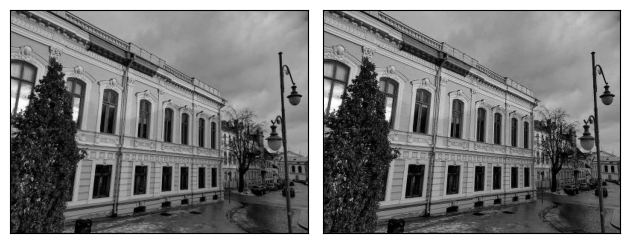

iteration [3951/4000], Loss: 0.00010665042645996436
iteration [3952/4000], Loss: 0.00010013949213316664
iteration [3953/4000], Loss: 0.00010619945533107966
iteration [3954/4000], Loss: 9.813364158617333e-05
iteration [3955/4000], Loss: 9.513958502793685e-05
iteration [3956/4000], Loss: 9.598577889846638e-05
iteration [3957/4000], Loss: 8.700983744347468e-05
iteration [3958/4000], Loss: 7.789718074491248e-05
iteration [3959/4000], Loss: 7.946379628265277e-05
iteration [3960/4000], Loss: 7.63593488954939e-05
iteration [3961/4000], Loss: 7.35491412342526e-05
iteration [3962/4000], Loss: 7.738551357761025e-05
iteration [3963/4000], Loss: 7.60061593609862e-05
iteration [3964/4000], Loss: 7.026206003502011e-05
iteration [3965/4000], Loss: 6.906378257554024e-05
iteration [3966/4000], Loss: 6.780776311643422e-05
iteration [3967/4000], Loss: 6.7020213464275e-05
iteration [3968/4000], Loss: 6.941812898730859e-05
iteration [3969/4000], Loss: 7.24822239135392e-05
iteration [3970/4000], Loss: 7.442

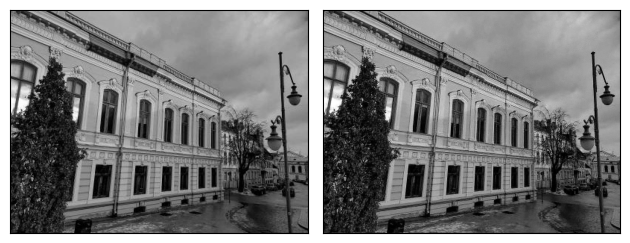

iteration [3976/4000], Loss: 0.0002034110511885956
iteration [3977/4000], Loss: 0.00022928667021915317
iteration [3978/4000], Loss: 0.00018412685312796384
iteration [3979/4000], Loss: 0.00018939959409181029
iteration [3980/4000], Loss: 0.00023855833569541574
iteration [3981/4000], Loss: 0.0002509862824808806
iteration [3982/4000], Loss: 0.00022619887022301555
iteration [3983/4000], Loss: 0.00018416265083942562
iteration [3984/4000], Loss: 0.00021865653980057687
iteration [3985/4000], Loss: 0.00022904285287950188
iteration [3986/4000], Loss: 0.0001681170251686126
iteration [3987/4000], Loss: 0.00018342668772675097
iteration [3988/4000], Loss: 0.00018006484606303275
iteration [3989/4000], Loss: 0.00012725283158943057
iteration [3990/4000], Loss: 0.00014434897457249463
iteration [3991/4000], Loss: 0.00014636587002314627
iteration [3992/4000], Loss: 0.00011022853868780658
iteration [3993/4000], Loss: 0.0001237126562045887
iteration [3994/4000], Loss: 0.00011271648691035807
iteration [3995/

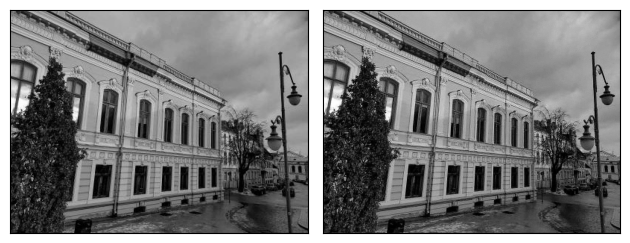

In [14]:
optimize_upscaling(dip_model, noise_img, target_img, n_iterations, upscaling_factor = upscaling_factor, dtype = dtype)

Get the edge map and retrain using it.

In [37]:
edgenet = EdgeNet(input_channels = 1).type(dtype)
edgenet.load_state_dict(torch.load('Project_in_Computational_Biology_take_2/model_parameters/EdgeNet_parameters/model_parameters_5'))

<All keys matched successfully>

In [44]:
input_for_edges_img = Image.open('/content/DIP_images/High_resolution_iteration_400.jpg')

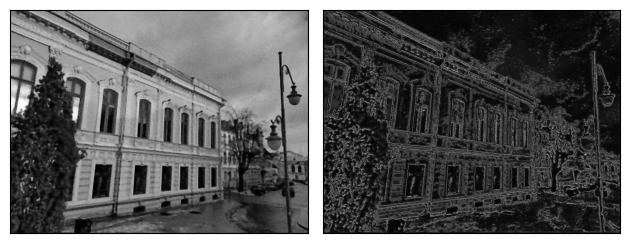

In [45]:
edge_map_tensor = get_edges_with_edgenet(input_for_edges_img, edgenet, save_img = True, dtype = dtype)
#maybe you can apply CV methods to the edge_map that you get?

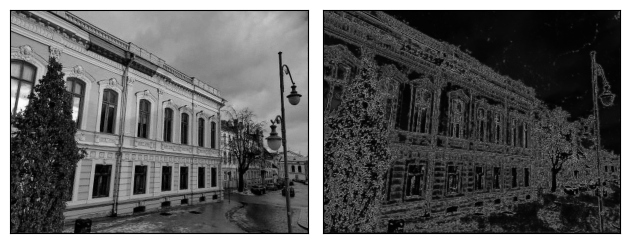

In [39]:
overfitted_img = Image.open('/content/DIP_images/High_resolution_iteration_3500.jpg')
overfitted_edges_tensor = get_edges_with_edgenet(overfitted_img, edgenet, save_img = True, dtype = dtype)

In [46]:
edges_mse = torch.mean(torch.square(edge_map_tensor - overfitted_edges_tensor))
print('typical mse for edges: ' + str(edges_mse))

typical mse for edges: tensor(0.0379, device='cuda:0')


Lastly, run optimization with edge_maps

In [47]:
#dip_model.load_state_dict(torch.load('/content/Project_in_Computational_Biology_take_2/model_parameters/DIP_model_parameters/DIP_model_parameters_spaghetti'))
#or start from random initialization
dip_model = skip(num_input_channels = num_input_channels, num_output_channels = num_output_channels, need_bias = True, upsample_mode = 'bilinear').type(dtype)

iteration [0/4000], Loss: 0.0024291700683534145


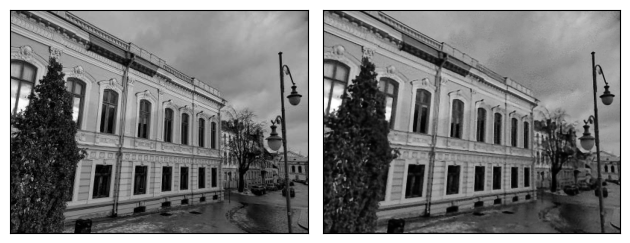

iteration [1/4000], Loss: 0.042890965938568115
iteration [2/4000], Loss: 0.022537313401699066
iteration [3/4000], Loss: 0.018852945417165756
iteration [4/4000], Loss: 0.0173249002546072
iteration [5/4000], Loss: 0.016374533995985985
iteration [6/4000], Loss: 0.015380242839455605
iteration [7/4000], Loss: 0.014695190824568272
iteration [8/4000], Loss: 0.013882914558053017
iteration [9/4000], Loss: 0.013320837169885635
iteration [10/4000], Loss: 0.01281704381108284
iteration [11/4000], Loss: 0.012378344312310219
iteration [12/4000], Loss: 0.01185547560453415
iteration [13/4000], Loss: 0.011393856257200241
iteration [14/4000], Loss: 0.010984779335558414
iteration [15/4000], Loss: 0.010678454302251339
iteration [16/4000], Loss: 0.01042043138295412
iteration [17/4000], Loss: 0.010150776244699955
iteration [18/4000], Loss: 0.009936739690601826
iteration [19/4000], Loss: 0.009803976863622665
iteration [20/4000], Loss: 0.009646311402320862
iteration [21/4000], Loss: 0.009344843216240406
iterat

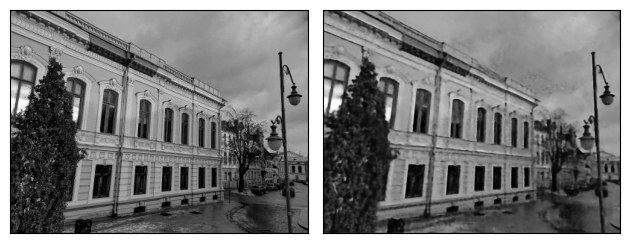

iteration [26/4000], Loss: 0.008429715409874916
iteration [27/4000], Loss: 0.008262328803539276
iteration [28/4000], Loss: 0.008115020580589771
iteration [29/4000], Loss: 0.00788638461381197
iteration [30/4000], Loss: 0.007733376696705818
iteration [31/4000], Loss: 0.0076463548466563225
iteration [32/4000], Loss: 0.007587964180856943
iteration [33/4000], Loss: 0.007433884311467409
iteration [34/4000], Loss: 0.007311931345611811
iteration [35/4000], Loss: 0.007217166014015675
iteration [36/4000], Loss: 0.007130621932446957
iteration [37/4000], Loss: 0.007023312151432037
iteration [38/4000], Loss: 0.006866891402751207
iteration [39/4000], Loss: 0.006752063985913992
iteration [40/4000], Loss: 0.006741181015968323
iteration [41/4000], Loss: 0.006791509687900543
iteration [42/4000], Loss: 0.006806780118495226
iteration [43/4000], Loss: 0.006630859803408384
iteration [44/4000], Loss: 0.006486012600362301
iteration [45/4000], Loss: 0.0064774430356919765
iteration [46/4000], Loss: 0.0064746066

KeyboardInterrupt: 

In [54]:
optimize_with_edges(dip_model, input_img = noise_img, target_img = grayscale_img, edge_map_tensor= edge_map_tensor, edgenet_model= edgenet, n_iterations= n_iterations, upscaling_factor= upscaling_factor, edge_weight = 0.5, dtype = dtype)

In [49]:
torch.save(dip_model.state_dict(), '/content/Files_to_download/dip_with_edges_parameters')

In [56]:
dip_model = skip(num_input_channels = num_input_channels, num_output_channels = num_output_channels, need_bias = True, upsample_mode = 'bilinear').type(dtype)
dip_model.load_state_dict(torch.load('/content/Files_to_download/dip_with_edges_parameters'))

<All keys matched successfully>

iteration [0/4000], Loss: 0.001522120088338852


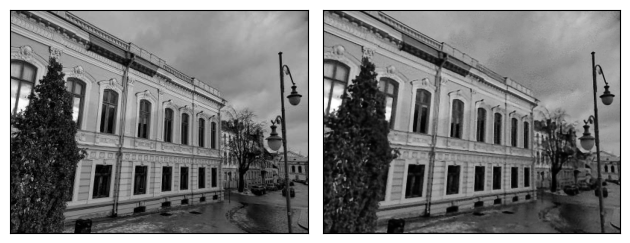

iteration [1/4000], Loss: 0.010537396185100079
iteration [2/4000], Loss: 0.003717087209224701
iteration [3/4000], Loss: 0.0035275702830404043
iteration [4/4000], Loss: 0.003967017866671085
iteration [5/4000], Loss: 0.00396826583892107
iteration [6/4000], Loss: 0.003719947300851345
iteration [7/4000], Loss: 0.0034908968955278397
iteration [8/4000], Loss: 0.003292722161859274
iteration [9/4000], Loss: 0.0031270822510123253
iteration [10/4000], Loss: 0.0029975927900522947
iteration [11/4000], Loss: 0.002890398958697915
iteration [12/4000], Loss: 0.002796062733978033
iteration [13/4000], Loss: 0.002702858066186309
iteration [14/4000], Loss: 0.0026160653214901686
iteration [15/4000], Loss: 0.0025409883819520473
iteration [16/4000], Loss: 0.002467785030603409
iteration [17/4000], Loss: 0.0024001742713153362
iteration [18/4000], Loss: 0.0023395996540784836
iteration [19/4000], Loss: 0.0022823794279247522
iteration [20/4000], Loss: 0.0022304051090031862
iteration [21/4000], Loss: 0.00218300428

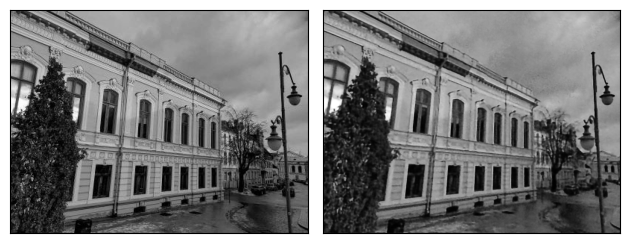

iteration [26/4000], Loss: 0.0019861110486090183
iteration [27/4000], Loss: 0.0019538383930921555
iteration [28/4000], Loss: 0.0019239308312535286
iteration [29/4000], Loss: 0.0018955288687720895
iteration [30/4000], Loss: 0.001867999555543065
iteration [31/4000], Loss: 0.0018417559331282973
iteration [32/4000], Loss: 0.0018174247816205025
iteration [33/4000], Loss: 0.001794074079953134
iteration [34/4000], Loss: 0.0017719273455440998
iteration [35/4000], Loss: 0.0017515163635835052
iteration [36/4000], Loss: 0.0017316273879259825
iteration [37/4000], Loss: 0.0017121690325438976
iteration [38/4000], Loss: 0.0016936713363975286
iteration [39/4000], Loss: 0.0016763702733442187
iteration [40/4000], Loss: 0.0016597991343587637
iteration [41/4000], Loss: 0.0016438406892120838
iteration [42/4000], Loss: 0.0016284558223560452
iteration [43/4000], Loss: 0.0016140167135745287
iteration [44/4000], Loss: 0.0016001255717128515
iteration [45/4000], Loss: 0.0015868693590164185
iteration [46/4000], L

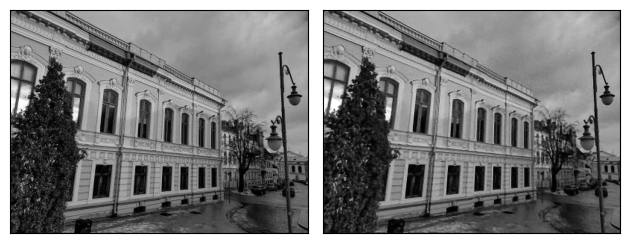

iteration [51/4000], Loss: 0.001516583957709372
iteration [52/4000], Loss: 0.0015063929604366422
iteration [53/4000], Loss: 0.0014965716982260346
iteration [54/4000], Loss: 0.0014869625447317958
iteration [55/4000], Loss: 0.001477645244449377
iteration [56/4000], Loss: 0.0014685080386698246
iteration [57/4000], Loss: 0.0014597411500290036
iteration [58/4000], Loss: 0.0014512933557853103
iteration [59/4000], Loss: 0.0014431326417252421
iteration [60/4000], Loss: 0.0014351994032040238
iteration [61/4000], Loss: 0.0014274433488026261
iteration [62/4000], Loss: 0.0014199709985405207
iteration [63/4000], Loss: 0.0014127047033980489
iteration [64/4000], Loss: 0.0014056398067623377
iteration [65/4000], Loss: 0.0013987291604280472
iteration [66/4000], Loss: 0.0013920364435762167
iteration [67/4000], Loss: 0.001385546405799687
iteration [68/4000], Loss: 0.001379236695356667
iteration [69/4000], Loss: 0.0013730379287153482
iteration [70/4000], Loss: 0.0013669824693351984
iteration [71/4000], Los

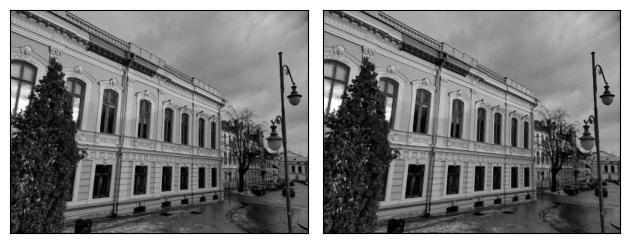

iteration [76/4000], Loss: 0.001333539723418653
iteration [77/4000], Loss: 0.0013284245505928993
iteration [78/4000], Loss: 0.0013233930803835392
iteration [79/4000], Loss: 0.0013184648705646396
iteration [80/4000], Loss: 0.0013136286288499832
iteration [81/4000], Loss: 0.0013089135754853487
iteration [82/4000], Loss: 0.0013042896753177047
iteration [83/4000], Loss: 0.0012997409794479609
iteration [84/4000], Loss: 0.0012952819233760238
iteration [85/4000], Loss: 0.0012909151846542954
iteration [86/4000], Loss: 0.0012866161996498704
iteration [87/4000], Loss: 0.001282419078052044
iteration [88/4000], Loss: 0.0012782816775143147
iteration [89/4000], Loss: 0.0012742227409034967
iteration [90/4000], Loss: 0.0012702648527920246
iteration [91/4000], Loss: 0.0012663715751841664
iteration [92/4000], Loss: 0.0012626134557649493
iteration [93/4000], Loss: 0.001258997479453683
iteration [94/4000], Loss: 0.0012556016445159912
iteration [95/4000], Loss: 0.001252495450899005
iteration [96/4000], Los

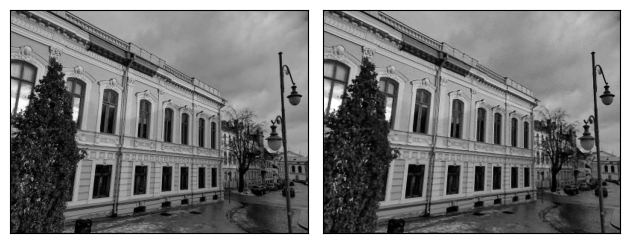

iteration [101/4000], Loss: 0.0012326763244345784
iteration [102/4000], Loss: 0.0012301031965762377
iteration [103/4000], Loss: 0.001229658955708146
iteration [104/4000], Loss: 0.0012316047213971615
iteration [105/4000], Loss: 0.001235945150256157
iteration [106/4000], Loss: 0.0012360350228846073
iteration [107/4000], Loss: 0.0012280993396416306
iteration [108/4000], Loss: 0.0012174391886219382
iteration [109/4000], Loss: 0.001212343922816217
iteration [110/4000], Loss: 0.0012133429991081357
iteration [111/4000], Loss: 0.0012134345015510917
iteration [112/4000], Loss: 0.00120913190767169
iteration [113/4000], Loss: 0.001202499377541244
iteration [114/4000], Loss: 0.0011999235721305013
iteration [115/4000], Loss: 0.0012007737532258034
iteration [116/4000], Loss: 0.001198712969198823
iteration [117/4000], Loss: 0.0011927098967134953
iteration [118/4000], Loss: 0.0011887855362147093
iteration [119/4000], Loss: 0.0011896750656887889
iteration [120/4000], Loss: 0.0011914148926734924
iterati

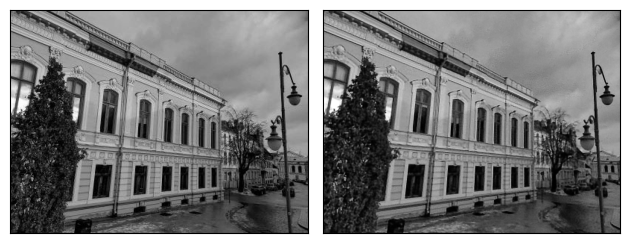

iteration [126/4000], Loss: 0.0011857436038553715
iteration [127/4000], Loss: 0.0011760619236156344
iteration [128/4000], Loss: 0.0011725221993401647
iteration [129/4000], Loss: 0.0011674393899738789
iteration [130/4000], Loss: 0.0011632253881543875
iteration [131/4000], Loss: 0.0011656543938443065
iteration [132/4000], Loss: 0.0011672665132209659
iteration [133/4000], Loss: 0.0011633650865405798
iteration [134/4000], Loss: 0.0011543825967237353
iteration [135/4000], Loss: 0.0011527503374963999
iteration [136/4000], Loss: 0.0011543391738086939
iteration [137/4000], Loss: 0.001149705145508051
iteration [138/4000], Loss: 0.0011444224510341883
iteration [139/4000], Loss: 0.0011461989488452673
iteration [140/4000], Loss: 0.0011532909702509642
iteration [141/4000], Loss: 0.0011598156997933984
iteration [142/4000], Loss: 0.001161846797913313
iteration [143/4000], Loss: 0.0011630412191152573
iteration [144/4000], Loss: 0.0011562327854335308
iteration [145/4000], Loss: 0.0011413649190217257
it

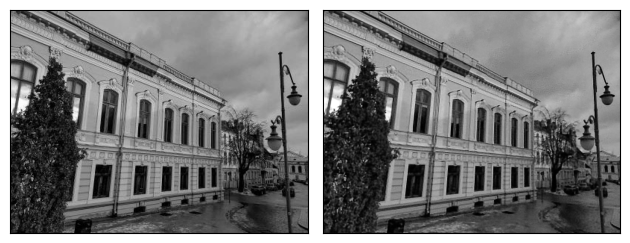

iteration [151/4000], Loss: 0.0011239068116992712
iteration [152/4000], Loss: 0.0011219409061595798
iteration [153/4000], Loss: 0.0011209991062059999
iteration [154/4000], Loss: 0.0011219300795346498
iteration [155/4000], Loss: 0.0011230787495151162
iteration [156/4000], Loss: 0.0011249268427491188
iteration [157/4000], Loss: 0.001130959135480225
iteration [158/4000], Loss: 0.0011400909861549735
iteration [159/4000], Loss: 0.0011458101216703653
iteration [160/4000], Loss: 0.0011515155201777816
iteration [161/4000], Loss: 0.0011383823584765196
iteration [162/4000], Loss: 0.0011163935996592045
iteration [163/4000], Loss: 0.0011072262423112988
iteration [164/4000], Loss: 0.0011129535268992186
iteration [165/4000], Loss: 0.0011167769553139806
iteration [166/4000], Loss: 0.0011118355905637145
iteration [167/4000], Loss: 0.0011078492971137166
iteration [168/4000], Loss: 0.0011005292180925608
iteration [169/4000], Loss: 0.0010925816604867578
iteration [170/4000], Loss: 0.001094280043616891
it

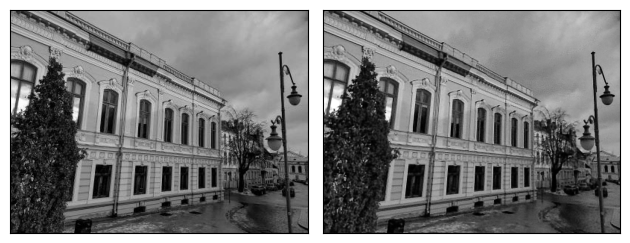

iteration [176/4000], Loss: 0.0011015709023922682
iteration [177/4000], Loss: 0.0011079780524596572
iteration [178/4000], Loss: 0.0011124524753540754
iteration [179/4000], Loss: 0.0011054616188630462
iteration [180/4000], Loss: 0.0010906431125476956
iteration [181/4000], Loss: 0.0010825273348018527
iteration [182/4000], Loss: 0.0010840262984856963
iteration [183/4000], Loss: 0.0010878285393118858
iteration [184/4000], Loss: 0.0010862858034670353
iteration [185/4000], Loss: 0.0010804245248436928
iteration [186/4000], Loss: 0.0010713981464505196
iteration [187/4000], Loss: 0.0010643120622262359
iteration [188/4000], Loss: 0.0010637074010446668
iteration [189/4000], Loss: 0.001067123026587069
iteration [190/4000], Loss: 0.0010696598328649998
iteration [191/4000], Loss: 0.0010671108029782772
iteration [192/4000], Loss: 0.0010665737790986896
iteration [193/4000], Loss: 0.001075326930731535
iteration [194/4000], Loss: 0.0010980593506246805
iteration [195/4000], Loss: 0.0011336358729749918
it

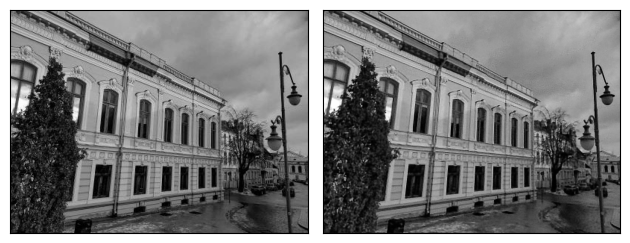

iteration [201/4000], Loss: 0.001094375504180789
iteration [202/4000], Loss: 0.0010616161162033677
iteration [203/4000], Loss: 0.0010783731704577804
iteration [204/4000], Loss: 0.0010845810174942017
iteration [205/4000], Loss: 0.0010606003925204277
iteration [206/4000], Loss: 0.0010536786867305636
iteration [207/4000], Loss: 0.001063409261405468
iteration [208/4000], Loss: 0.0010598708176985383
iteration [209/4000], Loss: 0.0010466541862115264
iteration [210/4000], Loss: 0.0010444544022902846
iteration [211/4000], Loss: 0.001051934203132987
iteration [212/4000], Loss: 0.001048311241902411
iteration [213/4000], Loss: 0.0010399091988801956
iteration [214/4000], Loss: 0.0010427969973534346
iteration [215/4000], Loss: 0.0010515915928408504
iteration [216/4000], Loss: 0.0010543018579483032
iteration [217/4000], Loss: 0.0010528636630624533
iteration [218/4000], Loss: 0.0010536877671256661
iteration [219/4000], Loss: 0.0010541813680902123
iteration [220/4000], Loss: 0.001048767357133329
itera

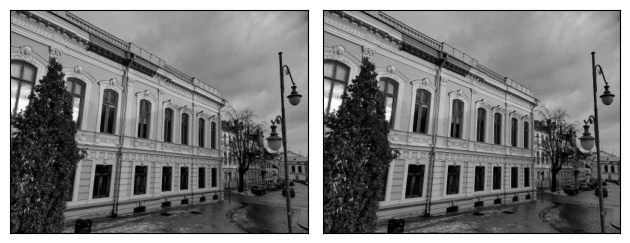

iteration [226/4000], Loss: 0.0010381173342466354
iteration [227/4000], Loss: 0.0010333108948543668
iteration [228/4000], Loss: 0.001038671936839819
iteration [229/4000], Loss: 0.0010385236237198114
iteration [230/4000], Loss: 0.0010333580430597067
iteration [231/4000], Loss: 0.001029366860166192
iteration [232/4000], Loss: 0.0010308570927008986
iteration [233/4000], Loss: 0.0010315865511074662
iteration [234/4000], Loss: 0.0010328601347282529
iteration [235/4000], Loss: 0.0010376895079389215
iteration [236/4000], Loss: 0.00104452483355999
iteration [237/4000], Loss: 0.0010526252444833517
iteration [238/4000], Loss: 0.0010624590795487165
iteration [239/4000], Loss: 0.001061003189533949
iteration [240/4000], Loss: 0.0010524126701056957
iteration [241/4000], Loss: 0.0010361808817833662
iteration [242/4000], Loss: 0.001029832987114787
iteration [243/4000], Loss: 0.0010389776434749365
iteration [244/4000], Loss: 0.0010429221438243985
iteration [245/4000], Loss: 0.0010363690089434385
iterat

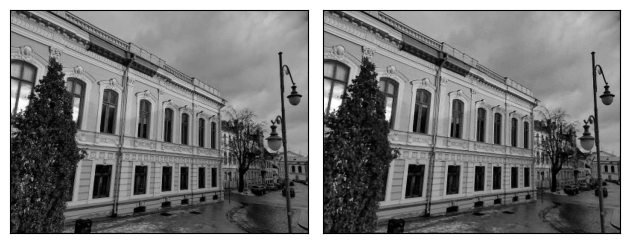

iteration [251/4000], Loss: 0.0010078713530674577
iteration [252/4000], Loss: 0.0010087700793519616
iteration [253/4000], Loss: 0.0010086908005177975
iteration [254/4000], Loss: 0.0010063683148473501
iteration [255/4000], Loss: 0.001006345497444272
iteration [256/4000], Loss: 0.0010075629688799381
iteration [257/4000], Loss: 0.0010093259625136852
iteration [258/4000], Loss: 0.0010163587285205722
iteration [259/4000], Loss: 0.0010246358579024673
iteration [260/4000], Loss: 0.0010277973487973213
iteration [261/4000], Loss: 0.0010244876611977816
iteration [262/4000], Loss: 0.0010123240062966943
iteration [263/4000], Loss: 0.0010033264989033341
iteration [264/4000], Loss: 0.000999361276626587
iteration [265/4000], Loss: 0.0010018163593485951
iteration [266/4000], Loss: 0.0010044628288596869
iteration [267/4000], Loss: 0.001011301763355732
iteration [268/4000], Loss: 0.0010266844183206558
iteration [269/4000], Loss: 0.0010485858656466007
iteration [270/4000], Loss: 0.0010583808179944754
ite

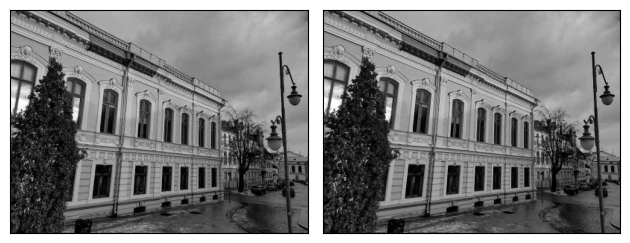

iteration [276/4000], Loss: 0.0010184664279222488
iteration [277/4000], Loss: 0.0010130084119737148
iteration [278/4000], Loss: 0.0009979783790186048
iteration [279/4000], Loss: 0.000991310691460967
iteration [280/4000], Loss: 0.000996913993731141
iteration [281/4000], Loss: 0.000997276627458632
iteration [282/4000], Loss: 0.0009880444267764688
iteration [283/4000], Loss: 0.0009826073655858636
iteration [284/4000], Loss: 0.000981538207270205
iteration [285/4000], Loss: 0.0009796591475605965
iteration [286/4000], Loss: 0.0009785850998014212
iteration [287/4000], Loss: 0.0009804412256926298
iteration [288/4000], Loss: 0.0009797789389267564
iteration [289/4000], Loss: 0.0009758806554600596
iteration [290/4000], Loss: 0.0009759406093508005
iteration [291/4000], Loss: 0.000983993406407535
iteration [292/4000], Loss: 0.000989992287941277
iteration [293/4000], Loss: 0.0010009609395638108
iteration [294/4000], Loss: 0.0010129637084901333
iteration [295/4000], Loss: 0.0010187437292188406
iterat

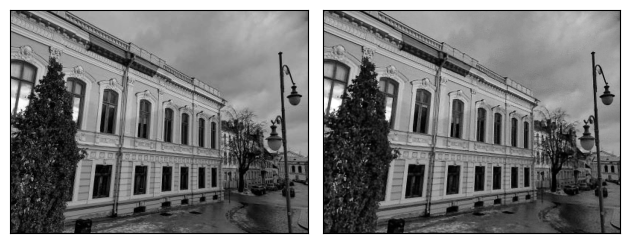

iteration [301/4000], Loss: 0.00099739630240947
iteration [302/4000], Loss: 0.000994254369288683
iteration [303/4000], Loss: 0.0010013915598392487
iteration [304/4000], Loss: 0.001009613974019885
iteration [305/4000], Loss: 0.001020194380544126
iteration [306/4000], Loss: 0.0010131060844287276
iteration [307/4000], Loss: 0.0010103507665917277
iteration [308/4000], Loss: 0.0010036082239821553
iteration [309/4000], Loss: 0.0009952082764357328
iteration [310/4000], Loss: 0.0009945251513272524
iteration [311/4000], Loss: 0.0009983958443626761
iteration [312/4000], Loss: 0.0010060308268293738
iteration [313/4000], Loss: 0.0009940085001289845
iteration [314/4000], Loss: 0.0009801199194043875
iteration [315/4000], Loss: 0.0009730634628795087
iteration [316/4000], Loss: 0.000969637418165803
iteration [317/4000], Loss: 0.0009652449516579509
iteration [318/4000], Loss: 0.0009648697450757027
iteration [319/4000], Loss: 0.0009647232946008444
iteration [320/4000], Loss: 0.0009622661746107042
iterat

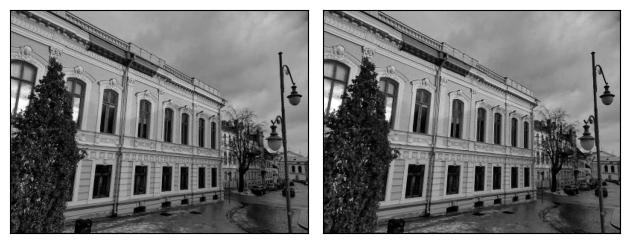

iteration [326/4000], Loss: 0.0009519573068246245
iteration [327/4000], Loss: 0.0009512051474303007
iteration [328/4000], Loss: 0.0009579554898664355
iteration [329/4000], Loss: 0.0009701785165816545
iteration [330/4000], Loss: 0.0009900137083604932
iteration [331/4000], Loss: 0.001011802232824266
iteration [332/4000], Loss: 0.0010202676057815552
iteration [333/4000], Loss: 0.001016061520203948
iteration [334/4000], Loss: 0.001002927077934146
iteration [335/4000], Loss: 0.0009876219555735588
iteration [336/4000], Loss: 0.0009916310664266348
iteration [337/4000], Loss: 0.001000673626549542
iteration [338/4000], Loss: 0.0009904606267809868
iteration [339/4000], Loss: 0.0009646398830227554
iteration [340/4000], Loss: 0.0009613141301088035
iteration [341/4000], Loss: 0.0009737017098814249
iteration [342/4000], Loss: 0.000971086323261261
iteration [343/4000], Loss: 0.0009550901595503092
iteration [344/4000], Loss: 0.0009483365574851632
iteration [345/4000], Loss: 0.0009567416273057461
itera

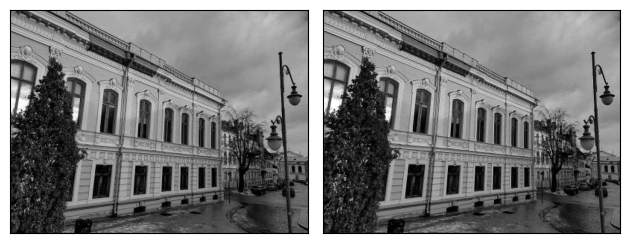

iteration [351/4000], Loss: 0.0009473453974351287
iteration [352/4000], Loss: 0.0009478770080022514
iteration [353/4000], Loss: 0.0009589706314727664
iteration [354/4000], Loss: 0.0009782417910173535
iteration [355/4000], Loss: 0.000994189060293138
iteration [356/4000], Loss: 0.0009911177912726998
iteration [357/4000], Loss: 0.0009709923760965466
iteration [358/4000], Loss: 0.0009508084622211754
iteration [359/4000], Loss: 0.0009520608000457287
iteration [360/4000], Loss: 0.0009702184470370412
iteration [361/4000], Loss: 0.0009742571273818612
iteration [362/4000], Loss: 0.0009641555370762944
iteration [363/4000], Loss: 0.0009531086543574929
iteration [364/4000], Loss: 0.0009587579406797886
iteration [365/4000], Loss: 0.0009566658409312367
iteration [366/4000], Loss: 0.000949888548348099
iteration [367/4000], Loss: 0.0009442641166970134
iteration [368/4000], Loss: 0.0009434582898393273
iteration [369/4000], Loss: 0.0009436896652914584
iteration [370/4000], Loss: 0.0009407096076756716
it

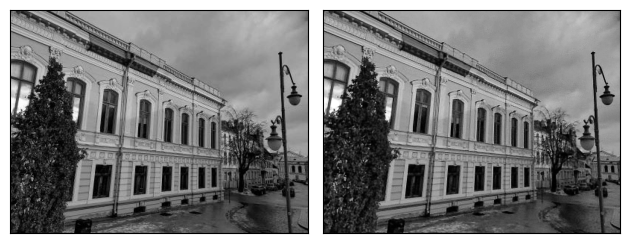

iteration [376/4000], Loss: 0.0009594216244295239
iteration [377/4000], Loss: 0.0009569204412400723
iteration [378/4000], Loss: 0.0009486504131928086
iteration [379/4000], Loss: 0.0009478360880166292
iteration [380/4000], Loss: 0.00095256173517555
iteration [381/4000], Loss: 0.0009615245508030057
iteration [382/4000], Loss: 0.0009683844982646406
iteration [383/4000], Loss: 0.0009605104569345713
iteration [384/4000], Loss: 0.0009390872437506914
iteration [385/4000], Loss: 0.000933311297558248
iteration [386/4000], Loss: 0.0009410881903022528
iteration [387/4000], Loss: 0.0009447309421375394
iteration [388/4000], Loss: 0.0009389687329530716
iteration [389/4000], Loss: 0.0009385229786857963
iteration [390/4000], Loss: 0.0009408969199284911
iteration [391/4000], Loss: 0.0009450163342989981
iteration [392/4000], Loss: 0.0009488471550866961
iteration [393/4000], Loss: 0.0009650734718888998
iteration [394/4000], Loss: 0.0009693274041637778
iteration [395/4000], Loss: 0.0009614838054403663
ite

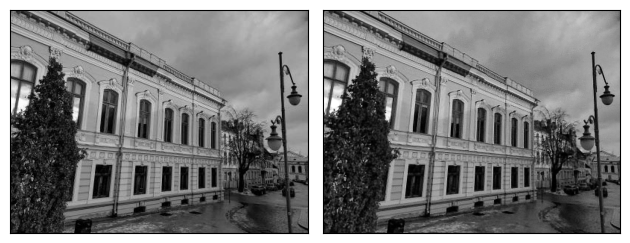

iteration [401/4000], Loss: 0.0009238000493496656
iteration [402/4000], Loss: 0.0009243766544386744
iteration [403/4000], Loss: 0.000926705077290535
iteration [404/4000], Loss: 0.0009287005523219705
iteration [405/4000], Loss: 0.000925017986446619
iteration [406/4000], Loss: 0.0009187307441607118
iteration [407/4000], Loss: 0.0009131340775638819
iteration [408/4000], Loss: 0.0009171952260658145
iteration [409/4000], Loss: 0.0009257259080186486
iteration [410/4000], Loss: 0.0009344251593574882
iteration [411/4000], Loss: 0.0009463082533329725
iteration [412/4000], Loss: 0.0009582944912835956
iteration [413/4000], Loss: 0.0009560587350279093
iteration [414/4000], Loss: 0.0009462221642024815
iteration [415/4000], Loss: 0.0009339530952274799
iteration [416/4000], Loss: 0.0009378705290146172
iteration [417/4000], Loss: 0.0009497609571553767
iteration [418/4000], Loss: 0.0009574850555509329
iteration [419/4000], Loss: 0.0009554330608807504
iteration [420/4000], Loss: 0.00094516237732023
iter

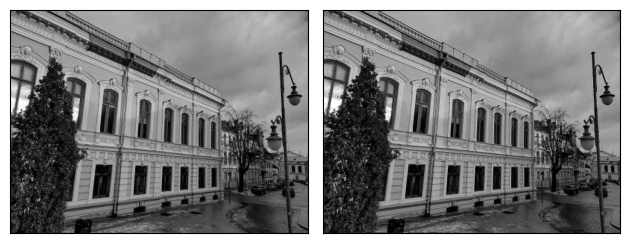

iteration [426/4000], Loss: 0.0009334106580354273
iteration [427/4000], Loss: 0.0009234397439286113
iteration [428/4000], Loss: 0.0009220867650583386
iteration [429/4000], Loss: 0.0009191584540531039
iteration [430/4000], Loss: 0.0009106438374146819
iteration [431/4000], Loss: 0.0009105481440201402
iteration [432/4000], Loss: 0.0009111929684877396
iteration [433/4000], Loss: 0.0009105113567784429
iteration [434/4000], Loss: 0.0009078511502593756
iteration [435/4000], Loss: 0.0009038127027451992
iteration [436/4000], Loss: 0.0009052993846125901
iteration [437/4000], Loss: 0.0009132189443334937
iteration [438/4000], Loss: 0.000922309816814959
iteration [439/4000], Loss: 0.0009342079283669591
iteration [440/4000], Loss: 0.0009447054471820593
iteration [441/4000], Loss: 0.0009528908412903547
iteration [442/4000], Loss: 0.0009500884916633368
iteration [443/4000], Loss: 0.000934110430534929
iteration [444/4000], Loss: 0.0009252856252714992
iteration [445/4000], Loss: 0.0009198548505082726
it

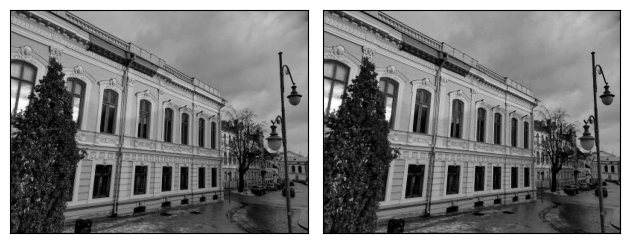

iteration [451/4000], Loss: 0.0009180856868624687
iteration [452/4000], Loss: 0.0009233506862074137
iteration [453/4000], Loss: 0.000920599908567965
iteration [454/4000], Loss: 0.0009182813810184598
iteration [455/4000], Loss: 0.0009178592590615153
iteration [456/4000], Loss: 0.0009245998808182776
iteration [457/4000], Loss: 0.0009215456084348261
iteration [458/4000], Loss: 0.0009180319029837847
iteration [459/4000], Loss: 0.0009113838314078748
iteration [460/4000], Loss: 0.0009087511571124196
iteration [461/4000], Loss: 0.0009061408927664161
iteration [462/4000], Loss: 0.0009061760501936078
iteration [463/4000], Loss: 0.000903843087144196
iteration [464/4000], Loss: 0.0009055978152900934
iteration [465/4000], Loss: 0.0009092542459256947
iteration [466/4000], Loss: 0.0009170116391032934
iteration [467/4000], Loss: 0.0009234972530975938
iteration [468/4000], Loss: 0.0009302833350375295
iteration [469/4000], Loss: 0.0009297010255977511
iteration [470/4000], Loss: 0.0009203192312270403
it

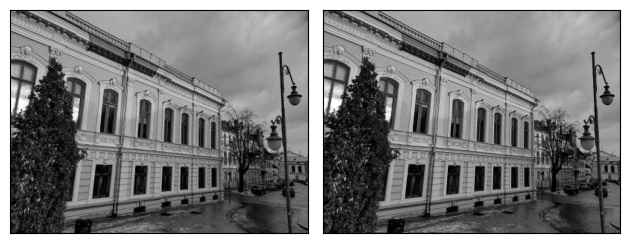

iteration [476/4000], Loss: 0.0009077729773707688
iteration [477/4000], Loss: 0.0009035317925736308
iteration [478/4000], Loss: 0.0008976716781035066
iteration [479/4000], Loss: 0.0009002848528325558
iteration [480/4000], Loss: 0.0009095505811274052
iteration [481/4000], Loss: 0.0009186342358589172
iteration [482/4000], Loss: 0.0009278933284804225
iteration [483/4000], Loss: 0.0009283861145377159
iteration [484/4000], Loss: 0.0009257298661395907
iteration [485/4000], Loss: 0.0009209217387251556
iteration [486/4000], Loss: 0.0009168821852654219
iteration [487/4000], Loss: 0.0009137471206486225
iteration [488/4000], Loss: 0.0009105979115702212
iteration [489/4000], Loss: 0.0009077785070985556
iteration [490/4000], Loss: 0.0009050898370333016
iteration [491/4000], Loss: 0.0009002218721434474
iteration [492/4000], Loss: 0.0009002309525385499
iteration [493/4000], Loss: 0.000901431601960212
iteration [494/4000], Loss: 0.000908668152987957
iteration [495/4000], Loss: 0.0009133344865404069
it

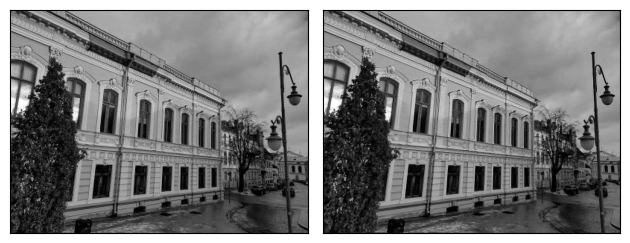

iteration [501/4000], Loss: 0.0009168180404230952
iteration [502/4000], Loss: 0.0009103139163926244
iteration [503/4000], Loss: 0.0008976970566436648
iteration [504/4000], Loss: 0.0008970242342911661
iteration [505/4000], Loss: 0.00090234843082726
iteration [506/4000], Loss: 0.0009048695210367441
iteration [507/4000], Loss: 0.0009082952165044844
iteration [508/4000], Loss: 0.0009067116770893335
iteration [509/4000], Loss: 0.0009034542599692941
iteration [510/4000], Loss: 0.0009006087202578783
iteration [511/4000], Loss: 0.0008974889642558992
iteration [512/4000], Loss: 0.000898506841622293
iteration [513/4000], Loss: 0.0008967177709564567
iteration [514/4000], Loss: 0.0008986085886135697
iteration [515/4000], Loss: 0.00089821289293468
iteration [516/4000], Loss: 0.0009015671676024795
iteration [517/4000], Loss: 0.0008956469828262925
iteration [518/4000], Loss: 0.0008919283282011747
iteration [519/4000], Loss: 0.0008892741752788424
iteration [520/4000], Loss: 0.0008911548065952957
itera

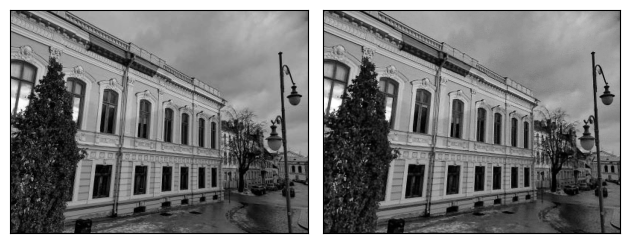

iteration [526/4000], Loss: 0.0009077730355784297
iteration [527/4000], Loss: 0.0009203223744407296
iteration [528/4000], Loss: 0.0009218519553542137
iteration [529/4000], Loss: 0.0009154214058071375
iteration [530/4000], Loss: 0.0009060562588274479
iteration [531/4000], Loss: 0.0009049359941855073
iteration [532/4000], Loss: 0.0008967604953795671
iteration [533/4000], Loss: 0.0008896032813936472
iteration [534/4000], Loss: 0.0008858478395268321
iteration [535/4000], Loss: 0.000883990665897727
iteration [536/4000], Loss: 0.0008865159470587969
iteration [537/4000], Loss: 0.0008831665618345141
iteration [538/4000], Loss: 0.0008767513209022582
iteration [539/4000], Loss: 0.0008744859369471669
iteration [540/4000], Loss: 0.0008760499767959118
iteration [541/4000], Loss: 0.0008768966654315591
iteration [542/4000], Loss: 0.0008723521023057401
iteration [543/4000], Loss: 0.0008676802972331643
iteration [544/4000], Loss: 0.000867305847350508
iteration [545/4000], Loss: 0.000871622352860868
ite

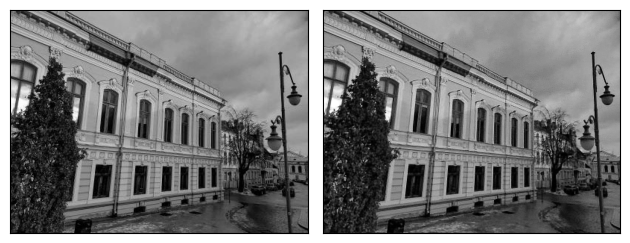

iteration [551/4000], Loss: 0.0008944043074734509
iteration [552/4000], Loss: 0.0008740639314055443
iteration [553/4000], Loss: 0.0008790341089479625
iteration [554/4000], Loss: 0.0008998364210128784
iteration [555/4000], Loss: 0.000912389368750155
iteration [556/4000], Loss: 0.0009150579571723938
iteration [557/4000], Loss: 0.0009114936692640185
iteration [558/4000], Loss: 0.0009368607425130904
iteration [559/4000], Loss: 0.0009538651211187243
iteration [560/4000], Loss: 0.0009522533509880304
iteration [561/4000], Loss: 0.0009089913219213486
iteration [562/4000], Loss: 0.0008821389637887478
iteration [563/4000], Loss: 0.0008945428999140859
iteration [564/4000], Loss: 0.0009070587111636996
iteration [565/4000], Loss: 0.0008992672665044665
iteration [566/4000], Loss: 0.0008859976660460234
iteration [567/4000], Loss: 0.0008825972327031195
iteration [568/4000], Loss: 0.0008772162836976349
iteration [569/4000], Loss: 0.0008738162578083575
iteration [570/4000], Loss: 0.0008749588159844279
i

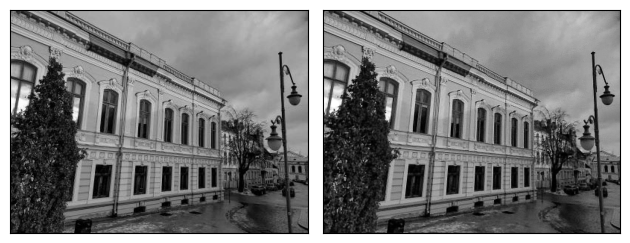

iteration [576/4000], Loss: 0.0008566502365283668
iteration [577/4000], Loss: 0.000860425760038197
iteration [578/4000], Loss: 0.0008641169406473637
iteration [579/4000], Loss: 0.0008722401689738035
iteration [580/4000], Loss: 0.0008889053715392947
iteration [581/4000], Loss: 0.0009093497064895928
iteration [582/4000], Loss: 0.0009263966348953545
iteration [583/4000], Loss: 0.0009217936312779784
iteration [584/4000], Loss: 0.0009028734639286995
iteration [585/4000], Loss: 0.0008840729715302587
iteration [586/4000], Loss: 0.0008834452601149678
iteration [587/4000], Loss: 0.0008877739310264587
iteration [588/4000], Loss: 0.0008917064405977726
iteration [589/4000], Loss: 0.0008787548285908997
iteration [590/4000], Loss: 0.0008667954243719578
iteration [591/4000], Loss: 0.0008640158921480179
iteration [592/4000], Loss: 0.0008685928769409657
iteration [593/4000], Loss: 0.0008728940738365054
iteration [594/4000], Loss: 0.0008678830345161259
iteration [595/4000], Loss: 0.0008602770394645631
i

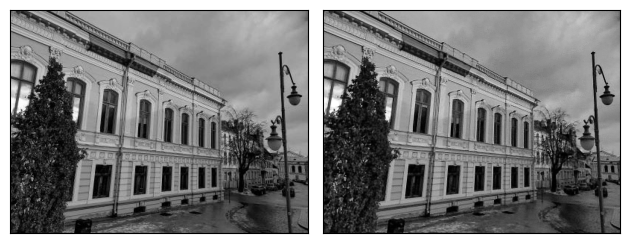

iteration [601/4000], Loss: 0.0009134578285738826
iteration [602/4000], Loss: 0.0009343474521301687
iteration [603/4000], Loss: 0.0009583513019606471
iteration [604/4000], Loss: 0.0009357238886877894
iteration [605/4000], Loss: 0.0009117502486333251
iteration [606/4000], Loss: 0.0009081686148419976
iteration [607/4000], Loss: 0.0009242714149877429
iteration [608/4000], Loss: 0.0009086807840503752
iteration [609/4000], Loss: 0.0008732584537938237
iteration [610/4000], Loss: 0.0008759633637964725
iteration [611/4000], Loss: 0.0008920420659705997
iteration [612/4000], Loss: 0.0008828290738165379
iteration [613/4000], Loss: 0.0008663733024150133
iteration [614/4000], Loss: 0.0008629529038444161
iteration [615/4000], Loss: 0.0008673890843056142
iteration [616/4000], Loss: 0.0008623999310657382
iteration [617/4000], Loss: 0.000856566708534956
iteration [618/4000], Loss: 0.0008553516818210483
iteration [619/4000], Loss: 0.0008538417750969529
iteration [620/4000], Loss: 0.0008495679358020425
i

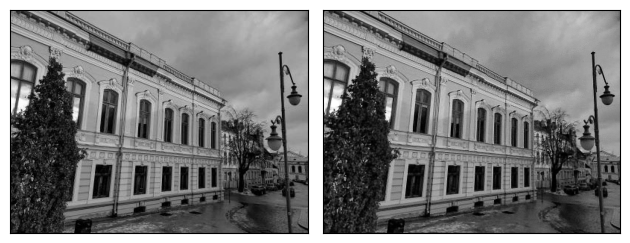

iteration [626/4000], Loss: 0.0008437298238277435
iteration [627/4000], Loss: 0.0008439172524958849
iteration [628/4000], Loss: 0.0008475869544781744
iteration [629/4000], Loss: 0.0008607936906628311
iteration [630/4000], Loss: 0.0008755741873756051
iteration [631/4000], Loss: 0.0009039242286235094
iteration [632/4000], Loss: 0.0009134219726547599
iteration [633/4000], Loss: 0.0009198440238833427
iteration [634/4000], Loss: 0.0009049860527738929
iteration [635/4000], Loss: 0.000898024532943964
iteration [636/4000], Loss: 0.0009010261856019497
iteration [637/4000], Loss: 0.0009015050018206239
iteration [638/4000], Loss: 0.0008975936798378825
iteration [639/4000], Loss: 0.0008833272149786353
iteration [640/4000], Loss: 0.0008762591751292348
iteration [641/4000], Loss: 0.0008768877596594393
iteration [642/4000], Loss: 0.0008746926323510706
iteration [643/4000], Loss: 0.0008662042673677206
iteration [644/4000], Loss: 0.0008563966257497668
iteration [645/4000], Loss: 0.0008582460577599704
i

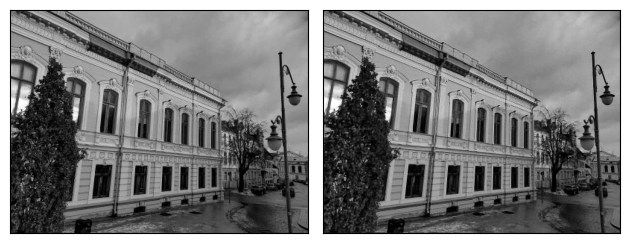

iteration [651/4000], Loss: 0.0008559084963053465
iteration [652/4000], Loss: 0.0008574476814828813
iteration [653/4000], Loss: 0.0008593220845796168
iteration [654/4000], Loss: 0.0008656601421535015
iteration [655/4000], Loss: 0.0008745683589950204
iteration [656/4000], Loss: 0.0008813341846689582
iteration [657/4000], Loss: 0.0008835189510136843
iteration [658/4000], Loss: 0.0008841471280902624
iteration [659/4000], Loss: 0.0008854165207594633
iteration [660/4000], Loss: 0.0008893262129276991
iteration [661/4000], Loss: 0.0008892272599041462
iteration [662/4000], Loss: 0.0008780594216659665
iteration [663/4000], Loss: 0.0008638147846795619
iteration [664/4000], Loss: 0.0008513093343935907
iteration [665/4000], Loss: 0.0008513386128470302
iteration [666/4000], Loss: 0.0008609696524217725
iteration [667/4000], Loss: 0.0008662783657200634
iteration [668/4000], Loss: 0.0008597682463005185
iteration [669/4000], Loss: 0.0008495579240843654
iteration [670/4000], Loss: 0.0008449626620858908


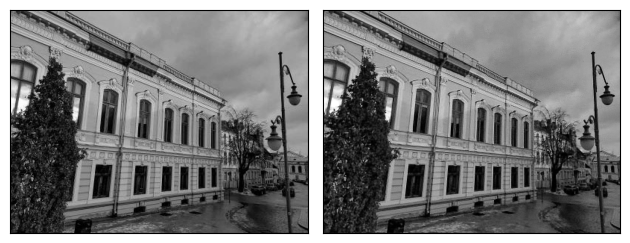

iteration [676/4000], Loss: 0.0008822249947115779
iteration [677/4000], Loss: 0.0008838659850880504
iteration [678/4000], Loss: 0.0008730115368962288
iteration [679/4000], Loss: 0.0008488224702887237
iteration [680/4000], Loss: 0.0008350431453436613
iteration [681/4000], Loss: 0.0008441004902124405
iteration [682/4000], Loss: 0.0008558607660233974
iteration [683/4000], Loss: 0.000856477883644402
iteration [684/4000], Loss: 0.0008478760719299316
iteration [685/4000], Loss: 0.0008457996300421655
iteration [686/4000], Loss: 0.0008419258520007133
iteration [687/4000], Loss: 0.0008395659970119596
iteration [688/4000], Loss: 0.0008371814619749784
iteration [689/4000], Loss: 0.0008392038871534169
iteration [690/4000], Loss: 0.0008440238307230175
iteration [691/4000], Loss: 0.0008495306828990579
iteration [692/4000], Loss: 0.0008550148922950029
iteration [693/4000], Loss: 0.0008576946565881371
iteration [694/4000], Loss: 0.0008511252235621214
iteration [695/4000], Loss: 0.0008455562638118863
i

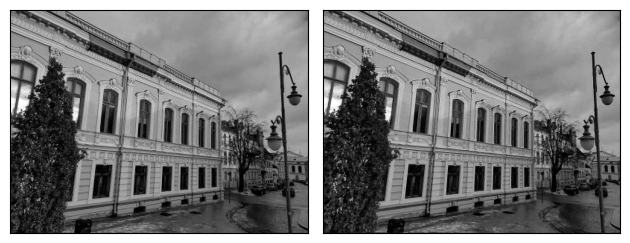

iteration [701/4000], Loss: 0.0008621142478659749
iteration [702/4000], Loss: 0.0008659461163915694
iteration [703/4000], Loss: 0.0008776264730840921
iteration [704/4000], Loss: 0.0008829232538118958
iteration [705/4000], Loss: 0.0008821551455184817
iteration [706/4000], Loss: 0.0008759136544540524
iteration [707/4000], Loss: 0.0008713705465197563
iteration [708/4000], Loss: 0.0008676835568621755
iteration [709/4000], Loss: 0.0008633463876321912
iteration [710/4000], Loss: 0.0008694606949575245


In [ ]:
optimize_with_edges(dip_model, input_img = noise_img, target_img = grayscale_img, edge_map_tensor= edge_map_tensor, edgenet_model= edgenet, n_iterations= n_iterations, upscaling_factor= upscaling_factor, edge_weight = 0.05, lr = 0.0005, dtype = dtype)